In [2]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from tqdm import tqdm
from matplotlib.lines import Line2D
from scipy.linalg import block_diag

sys.path.append(os.path.abspath(os.path.join('../../src')))
sys.path.append(os.path.abspath(os.path.join('../newton_based_algorithms')))

from utils import get_form_initial_conditions
try:
    from tudatpy.astro.time_conversion import DateTime
    use_tudatpy = True
except ImportError:
    print('No tudatpy available')
    use_tudatpy = False
from dynamics import SatelliteDynamics, Propagator

from unkkt import UNKKT
from tree_newton import Tree_Newton
from approxh_newton import approxH_Newton
from mm_newton import MM_Newton

try:
    from concurrent.futures import ProcessPoolExecutor
    use_several_cpus = True
except ImportError:
    print('No concurrent.futures.ProcessPoolExecutor available')
    use_several_cpus = False
use_several_cpus = True

use_causal = True

No tudatpy available


In [3]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [4]:
# Simulation parameters
dt = 60.0  # Time step [s]
T = 395  # Duration [min]

# Set simulation start (0 TDB seconds since J2000) and end epochs
if use_tudatpy:
    simulation_start_epoch = DateTime(2000, 1, 1).epoch()
    simulation_end_epoch = (T - 1) * dt

T_RMSE = 300  # Index from which the RMSE is calculated
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6  # State dimension
n_p = 3  
n_y_1 = 3 
n_y_2 = 2
n_y_3 = 2
n_y_4 = 2
K = T
W = 100 # Window size [min]

In [5]:
# Initial state vector and get the true state vectors
X_initial = get_form_initial_conditions(formation)
if use_tudatpy:
    propagator = Propagator(simulation_start_epoch, simulation_end_epoch, dt, X_initial)
    X_true = propagator.run().T.reshape(24, 1, T)
else:
    X_true = np.zeros((24, 1, T))
    X_true[:, :, 0] = X_initial
    for t in range(T - 1):
        X_true[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

In [6]:
if use_tudatpy:
    # Estimate process noise
    X_our_model = np.zeros((24, 1, T))
    X_our_model[:, :, 0] = X_initial
    for t in range(T - 1):
        X_our_model[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_true[:, :, t])

    # Compute the difference between the ground truth and the model after initial conditions
    diff = X_true[:, :, 1:] - X_our_model[:, :, 1:]
    diff_flattened = diff.T.reshape(-1, 24)

    # Calculate the general covariance matrix of the flattened differences
    Q = np.cov(diff_flattened, rowvar=False)

    # Create a zero matrix of the same shape
    Q_modified = np.zeros_like(Q)

    # Fill only the required block diagonals
    Q_modified[:6, :6] = np.diag(np.diag(Q[:6, :6]))
    Q_modified[6:12, 6:12] = np.diag(np.diag(Q[6:12, 6:12]))
    Q_modified[12:18, 12:18] = np.diag(np.diag(Q[12:18, 12:18]))
    Q_modified[18:, 18:] = np.diag(np.diag(Q[18:, 18:]))
    Q = Q_modified
    pd.DataFrame(Q[:6, :6]), pd.DataFrame(Q[6:12, 6:12]), pd.DataFrame(Q[12:18, 12:18]), pd.DataFrame(Q[18:, 18:])

In [7]:
# propagator2 = Propagator(simulation_start_epoch, simulation_end_epoch, 1.0, X_initial)
# X_true2 = propagator2.run().T.reshape(24, 1, 23641)

# # Estimate process noise
# X_our_model2 = np.zeros((24, 1, 23641))
# X_our_model2[:, :, 0] = X_initial
# for t in range(23641 - 1):
#     X_our_model2[:, :, t + 1] = SatelliteDynamics().x_new(1.0, X_true2[:, :, t])

# # Compute the difference between the ground truth and the model after initial conditions
# diff2 = X_true2[:, :, 1:] - X_our_model2[:, :, 1:]
# diff_flattened2 = diff2.T.reshape(-1, 24)

# # Calculate the general covariance matrix of the flattened differences
# Q2 = np.cov(diff_flattened2, rowvar=False)

# # Create a zero matrix of the same shape
# Q_modified2 = np.zeros_like(Q2)

# # Fill only the required block diagonals
# Q_modified2[:6, :6] = np.diag(np.diag(Q2[:6, :6]))
# Q_modified2[6:12, 6:12] = np.diag(np.diag(Q2[6:12, 6:12]))
# Q_modified2[12:18, 12:18] = np.diag(np.diag(Q2[12:18, 12:18]))
# Q_modified2[18:, 18:] = np.diag(np.diag(Q2[18:, 18:]))
# Q2 = Q_modified2
# pd.DataFrame(Q2[:6, :6]), pd.DataFrame(Q2[6:12, 6:12]), pd.DataFrame(Q2[12:18, 12:18]), pd.DataFrame(Q2[18:, 18:])

In [8]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P = np.array([[1, 0, 0, 0, 0, 0], [0, 1, 0, 0, 0, 0], [0, 0, 1, 0, 0, 0]])

In [9]:
tol = 1e-20
max_iter = 100

# Declare solvers
unkkt = UNKKT(W, R_chief, r_deputy_pos)
unkkt.grad_tol = tol
unkkt.max_iter = max_iter

tree_newton = Tree_Newton(W, R_chief, r_deputy_pos)
tree_newton.grad_tol = tol
tree_newton.max_iter = max_iter

approxh_newton = approxH_Newton(W, R_chief, r_deputy_pos)
approxh_newton.grad_tol = tol
approxh_newton.max_iter = max_iter

mm_newton = MM_Newton(W, R_chief, r_deputy_pos)
mm_newton.grad_tol = tol
mm_newton.max_iter = 10
mm_newton.mm_tol = tol
mm_newton.mm_max_iter = int(max_iter / mm_newton.max_iter)

In [10]:
# Simulation setup
np.random.seed(42)

X_est = np.zeros_like(X_true)
initial_dev = np.concatenate(
    (
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
        p_pos_initial * np.random.randn(3, 1),
        p_vel_initial * np.random.randn(3, 1),
    )
)
X_est[:, :, 0] = X_initial + initial_dev
for t in range(T - 1):
    X_est[:, :, t + 1] = SatelliteDynamics().x_new(dt, X_est[:, :, t])

# Observations
Y = np.zeros((9, 1, T))
for t in range(T):
    Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.normal(0, np.sqrt(np.diag(R)).reshape((9, 1)), size=(9, 1))
    
dev_chief_initial = np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).reshape(-1, 1)
dev_deputy1_initial = np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).reshape(-1, 1)
dev_deputy2_initial = np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).reshape(-1, 1)
dev_deputy3_initial = np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).reshape(-1, 1)

dev_chief_initial, dev_deputy1_initial, dev_deputy2_initial, dev_deputy3_initial = position_estimation_error(X_est, X_true)

In [11]:
if not use_several_cpus:
    # SEQUENTIAL USING ONE CPU
    # Main execution loop
    for m in tqdm(range(M), desc="MC runs", leave=True):
        # Observations
        Y = np.zeros((9, 1, T))
        for t in range(T):
            Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.multivariate_normal(np.zeros(9), R).reshape((9, 1))

        # Estimate the state
        X_est_unkkt = X_initial + initial_dev
        X_est_tree_newton = X_initial + initial_dev
        X_est_approx_newton = X_initial + initial_dev
        X_est_mm = X_initial + initial_dev
        for n in tqdm(range(W - 1, K), desc="Windows", leave=False): # n is the index of the end of the finite-horizon window
            print("-------- Centralized Newton --------")
            X_est_unkkt = unkkt.solve_for_each_window(dt, X_est_unkkt, Y[:, :, n - W + 1 : n + 1])
            print(f"Final position relative errors: {np.linalg.norm(X_true[:3, :, n - W + 1] - X_est_unkkt[:3])} m, {np.linalg.norm(X_true[6:9, :, n - W + 1] - X_est_unkkt[6:9])} m, {np.linalg.norm(X_true[12:15, :, n - W + 1] - X_est_unkkt[12:15])} m, {np.linalg.norm(X_true[18:21, :, n - W + 1] - X_est_unkkt[18:21])} m")
            print("-------- Tree Newton --------")
            X_est_tree_newton = tree_newton.solve_for_each_window(dt, X_est_tree_newton, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])
            print("-------- ApproxH Newton --------")
            X_est_approx_newton = approxh_newton.solve_for_each_window(dt, X_est_approx_newton, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])
            print("-------- MM Newton --------")
            X_est_mm = mm_newton.solve_for_each_window(dt, X_est_mm, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])

            fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(2 * 6.4, 4.8))

            # First subplot - Cost function values
            ax1.plot(unkkt.cost_function_values, '.-', label='Centralized Newton')
            ax1.plot(tree_newton.cost_function_values, '.-', label='Tree Newton')
            ax1.plot(approxh_newton.cost_function_values, '.-', label='ApproxH Newton')
            ax1.plot(mm_newton.cost_function_values, '.-', label='MM Newton Cost Function')
            ax1.plot(mm_newton.surrogate_function_values, '.-', label='MM Newton Surrogate Function')
            ax1.set_xlabel('Iteration')
            ax1.set_ylabel('$\frac{1}{H}$ Cost Function')
            ax1.set_yscale('log')
            ax1.grid(True)
            ax1.legend()

            # Second subplot - Gradient norm values
            ax2.plot(unkkt.grad_norm_values, '.-', label='Centralized Newton')
            ax2.plot(tree_newton.grad_norm_values, '.-', label='Tree Newton')
            ax2.plot(approxh_newton.grad_norm_values, '.-', label='ApproxH Newton')
            ax2.plot(mm_newton.grad_norm_values, '.-', label='MM Newton Cost Function Gradient Norm')
            ax2.plot(mm_newton.surrogate_grad_norm_values, '.-', label='MM Newton Surrogate Function Gradient Norm')
            ax2.set_xlabel('Iteration')
            ax2.set_ylabel('$\frac{1}{H}$Gradient Norm')
            ax2.set_yscale('log')
            ax2.grid(True)
            ax2.legend()

            plt.title(f'Window {n + 1}')
            plt.tight_layout()
            plt.show()
            
            unkkt.cost_function_values = []
            unkkt.grad_norm_values = []
            tree_newton.cost_function_values = []
            tree_newton.grad_norm_values = []
            approxh_newton.cost_function_values = []
            approxh_newton.grad_norm_values = []
            mm_newton.cost_function_values = []
            mm_newton.grad_norm_values = []
            mm_newton.surrogate_function_values = []
            mm_newton.surrogate_grad_norm_values = []
            
            X_est_unkkt = unkkt.dynamic_model.x_new(dt, X_est_unkkt)
            X_est_tree_newton = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton)
            X_est_approx_newton = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton)
            X_est_mm = mm_newton.dynamic_model.x_new(dt, X_est_mm)

In [12]:
if use_several_cpus and not use_causal:
    # DISTRIBUTED OVER SEVERAL CPUs AND NONCAUSAL
    
    # Initialize storage arrays for state estimates
    X_est_unkkt_history = np.zeros((24, 1, K))  # Centralized Newton
    X_est_tree_newton_history = np.zeros((24, 1, K))  # Tree Newton
    X_est_approx_newton_history = np.zeros((24, 1, K))  # ApproxH Newton
    X_est_mm_history = np.zeros((24, 1, K))  # MM Newton
    
    def solve_algorithm(algorithm_name, algorithm, X_est, dt, Y, X_true, n):
        """
        Solves the estimation problem for a given algorithm.
        Returns the algorithm name, updated X_est, and cost function/gradient data for plotting.
        """
        print(f"-------- {algorithm_name} --------")
        
        if algorithm_name == "Centralized Newton":
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n : n + W])
            final_errors = [
                np.linalg.norm(X_true[:3, :, n] - X_est[:3]),
                np.linalg.norm(X_true[6:9, :, n] - X_est[6:9]),
                np.linalg.norm(X_true[12:15, :, n] - X_est[12:15]),
                np.linalg.norm(X_true[18:21, :, n] - X_est[18:21])
            ]
            print(f"Final position relative errors: {final_errors} m")
        
        elif algorithm_name in ["Tree Newton", "ApproxH Newton", "MM Newton"]:
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n : n + W], X_true[:, :, n])
    
        # Collect cost function and gradient norm data
        return (
            algorithm_name,
            X_est,
            algorithm.cost_function_values.copy(),
            algorithm.grad_norm_values.copy(),
            algorithm.surrogate_function_values.copy() if hasattr(algorithm, "surrogate_function_values") else [],
            algorithm.surrogate_grad_norm_values.copy() if hasattr(algorithm, "surrogate_grad_norm_values") else []
        )
    
    # ================= MAIN EXECUTION =================
    for m in tqdm(range(M), desc="MC runs", leave=True):
        # Generate observations
        Y = np.zeros((9, 1, T))
        for t in range(T):
            Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.multivariate_normal(np.zeros(9), R).reshape((9, 1))
    
        # Initialize state estimates
        X_est_unkkt = X_initial + initial_dev
        X_est_tree_newton = X_initial + initial_dev
        X_est_approx_newton = X_initial + initial_dev
        X_est_mm = X_initial + initial_dev
    
        for n in tqdm(range(K - W + 1), desc="Windows", leave=False):
            with ProcessPoolExecutor(max_workers=4) as executor:
                # Run each algorithm in parallel
                future_to_algorithm = {
                    executor.submit(solve_algorithm, "Centralized Newton", unkkt, X_est_unkkt, dt, Y, X_true, n): "Centralized Newton",
                    executor.submit(solve_algorithm, "Tree Newton", tree_newton, X_est_tree_newton, dt, Y, X_true, n): "Tree Newton",
                    executor.submit(solve_algorithm, "ApproxH Newton", approxh_newton, X_est_approx_newton, dt, Y, X_true, n): "ApproxH Newton",
                    executor.submit(solve_algorithm, "MM Newton", mm_newton, X_est_mm, dt, Y, X_true, n): "MM Newton"
                }
    
                # Retrieve results in the main process
                results = {future.result()[0]: future.result()[1:] for future in future_to_algorithm}
    
            # Extract updated estimates
            X_est_unkkt, cost_unkkt, grad_unkkt, _, _ = results["Centralized Newton"]
            X_est_tree_newton, cost_tree, grad_tree, _, _ = results["Tree Newton"]
            X_est_approx_newton, cost_approx, grad_approx, _, _ = results["ApproxH Newton"]
            X_est_mm, cost_mm, grad_mm, surrogate_cost_mm, surrogate_grad_mm = results["MM Newton"]
            
            # Store X_est history per algorithm
            X_est_unkkt_history[:, :, n] = X_est_unkkt
            X_est_tree_newton_history[:, :, n] = X_est_tree_newton
            X_est_approx_newton_history[:, :, n] = X_est_approx_newton
            X_est_mm_history[:, :, n] = X_est_mm
    
            # Plot results **in the main process**
            fig, axs = plt.subplots(1, 3, figsize=(3 * 6.4, 4.8))
    
            # Cost function values
            axs[0].plot(cost_unkkt, '.-', label='Centralized Newton')
            axs[0].plot(cost_tree, '.-', label='Tree Newton (original)')
            axs[0].plot(cost_approx, '.-', label='ApproxH Newton')
            axs[0].plot(cost_mm, '.-', label='MM Newton Cost Function')
            axs[0].plot(surrogate_cost_mm, '.-', label='MM Newton Surrogate Function')
            axs[0].set_xlabel('Iteration')
            axs[0].set_ylabel(r'$\frac{1}{H}$ Cost Function')
            axs[0].set_yscale('log')
            axs[0].grid(True)
            axs[0].legend()
    
            # Gradient norm values
            axs[1].plot(grad_unkkt, '.-', label='Centralized Newton')
            axs[1].plot(grad_tree, '.-', label='Tree Newton')
            axs[1].plot(grad_approx, '.-', label='ApproxH Newton')
            axs[1].plot(grad_mm, '.-', label='MM Newton Cost Function Gradient Norm')
            axs[1].plot(surrogate_grad_mm, '.-', label='MM Newton Surrogate Function Gradient Norm')
            axs[1].set_xlabel('Iteration')
            axs[1].set_ylabel(r'$\frac{1}{H}$ Gradient Norm')
            axs[1].set_yscale('log')
            axs[1].grid(True)
            axs[1].legend()

            # Initialize storage for current estimates
            X_est_unkkt_current = np.zeros((24, 1, W))
            X_est_tree_newton_current = np.zeros((24, 1, W))
            X_est_approx_newton_current = np.zeros((24, 1, W))
            X_est_mm_current = np.zeros((24, 1, W))
            
            # Simulate forward propagation over the window
            X_est_unkkt_current[:, :, 0] = X_est_unkkt
            X_est_tree_newton_current[:, :, 0] = X_est_tree_newton
            X_est_approx_newton_current[:, :, 0] = X_est_approx_newton
            X_est_mm_current[:, :, 0] = X_est_mm
            
            for tau in range(W - 1):
                X_est_unkkt_current[:, :, tau + 1] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_current[:, :, tau])
                X_est_tree_newton_current[:, :, tau + 1] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_current[:, :, tau])
                X_est_approx_newton_current[:, :, tau + 1] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_current[:, :, tau])
                X_est_mm_current[:, :, tau + 1] = mm_newton.dynamic_model.x_new(dt, X_est_mm_current[:, :, tau])
            
            # Compute position estimation errors
            dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current = position_estimation_error(X_est_unkkt_current, X_true[:, :, n:n + W])
            dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current = position_estimation_error(X_est_tree_newton_current, X_true[:, :, n:n + W])
            dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current = position_estimation_error(X_est_approx_newton_current, X_true[:, :, n:n + W])
            dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current = position_estimation_error(X_est_mm_current, X_true[:, :, n:n + W])
            
            # Define colors for algorithms
            algorithm_colors = {
                'Initial guess': 'grey',
                'Centralized Newton': 'C0',
                'Tree Newton': 'C1',
                'ApproxH Newton': 'C2',
                'MM Newton': 'C3'
            }
            
            # Define markers for different agents (i = 1, ..., 4)
            markers = ['.', '^', '2', 's', 'P']
            
            # Plot Initial Guess deviations (use the same color for all i)
            for i, dev_initial in enumerate([dev_chief_initial, dev_deputy1_initial, dev_deputy2_initial, dev_deputy3_initial]):
                axs[2].plot(dev_initial[n:n + W - 1], linestyle='-', color=algorithm_colors['Initial guess'], marker=markers[i])
            
            # Plot Centralized Newton deviations
            for i, dev_unkkt in enumerate([dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current]):
                axs[2].plot(dev_unkkt, linestyle='-', color=algorithm_colors['Centralized Newton'], marker=markers[i])
            
            # Plot Tree Newton deviations
            for i, dev_tree in enumerate([dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current]):
                axs[2].plot(dev_tree, linestyle='-', color=algorithm_colors['Tree Newton'], marker=markers[i])
            
            # Plot ApproxH Newton deviations
            for i, dev_approxh in enumerate([dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current]):
                axs[2].plot(dev_approxh, linestyle='-', color=algorithm_colors['ApproxH Newton'], marker=markers[i])
            
            # Plot MM Newton deviations
            for i, dev_mm in enumerate([dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current]):
                axs[2].plot(dev_mm, linestyle='-', color=algorithm_colors['MM Newton'], marker=markers[i])
            
            # Set axis labels and scale
            axs[2].set_xlabel(r'$\tau$')
            axs[2].set_ylabel(r'$\left\|\hat{\mathbf{p}}_i(\tau) - \mathbf{p}_i(\tau)\right\|$ [m]')
            axs[2].set_yscale('log')
            axs[2].grid(True)
            
            # Create legend (Colors for Algorithms, Markers for Agents)
            legend_elements = [
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Initial guess'], label='Initial guess'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Centralized Newton'], label='Centralized Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Tree Newton'], label='Tree Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['ApproxH Newton'], label='ApproxH Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['MM Newton'], label='MM Newton'),
                Line2D([0], [0], linestyle='', marker='.', color='black', label='$i = 1$'),
                Line2D([0], [0], linestyle='', marker='^', color='black', label='$i = 2$'),
                Line2D([0], [0], linestyle='', marker='2', color='black', label='$i = 3$'),
                Line2D([0], [0], linestyle='', marker='s', color='black', label='$i = 4$')
            ]
            fig.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))
    
            fig.suptitle(f'Window k = {n}')
            plt.tight_layout() 
            plt.show()
    
            # Update state estimates
            X_est_unkkt = unkkt.dynamic_model.x_new(dt, X_est_unkkt)
            X_est_tree_newton = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton)
            X_est_approx_newton = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton)
            X_est_mm = mm_newton.dynamic_model.x_new(dt, X_est_mm)

Windows:   0%|          | 0/296 [00:00<?, ?it/s]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 27666223.18644657
Gradient norm: 757165101.9304688
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Before applying the algorithm
L_norm = 27666223.18644657
Grad_L_norm = 758929245.3026879

Before applying the algorithm
Cost function: 27666223.18644657
Gradient norm: 758929245.3026879
Global relative error: 395.60563949432424
Position relative errors: 82.78540989608044 m, 181.7491507333766 m, 258.73787052498585 m, 222.8729633755392 m

Iteration 1
Cost function: 98622.29244746787 (-99.64%)
Gradient norm: 1265550.2685824404 (-99.83%)
Global relative error: 582.5911293178181 (47.27%)
Position relative errors: 0.05494389431489245 m, 90.56543283138859 m, 99.4168243510532 m, 566.85

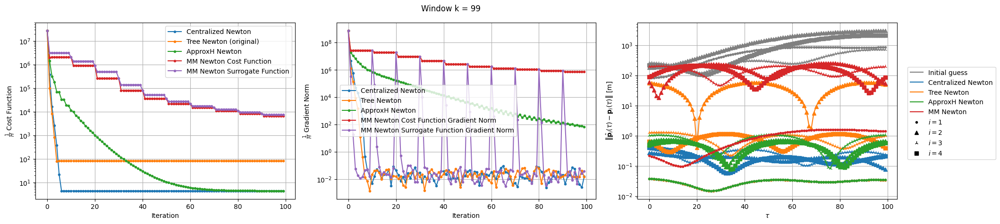


Windows:   0%|          | 1/296 [05:40<27:56:02, 340.89s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 81.47770102825349
Gradient norm: 181.0279629544707
Global relative error: 55.51032937868206
Position relative errors: 0.03767324464762068 m, 55.49241026769396 m, 1.2791106170767328 m, 0.5925575945107515 m

Before applying the algorithm
L_norm = 4.334988527729128
Grad_L_norm = 341.2078484369299

Before applying the algorithm
Cost function: 4.342464183964573
Gradient norm: 416.01136546937767
Global relative error: 1.3465945273322468
Position relative errors: 0.03806385997368574 m, 0.6801247343646099 m, 1.0375258140055723 m, 0.5223390438963857 m

Before applying the algorithm
Cost function: 6612.962492705168
Gradient norm: 746883.5102637027
Global relative error: 224.76679771794147
Position relative errors: 0.20810378143022965 m, 45.7553156612649 m, 197.25157845669628 m, 97.561308

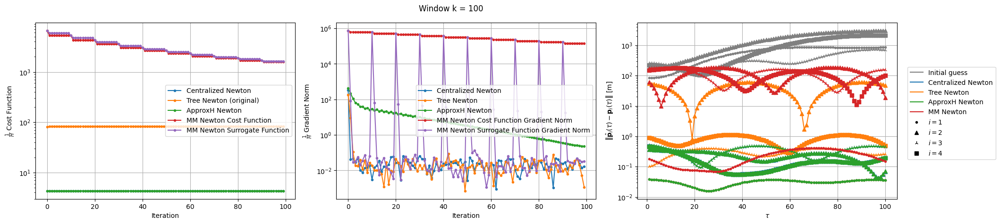


Windows:   1%|          | 2/296 [10:58<26:43:55, 327.33s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 78.23565016211215
Gradient norm: 2024.9875489410167
Global relative error: 53.8722565824142
Position relative errors: 0.037611744248463023 m, 53.86538634498081 m, 0.1037338241273317 m, 0.8527319399222597 m

Before applying the algorithm
Cost function: 4.3032416906244215
Gradient norm: 1977.8440486893712
Global relative error: 0.7572071420485517
Position relative errors: 0.03761263252069956 m, 0.35905295943530713 m, 0.49480125561166755 m, 0.4451967834164923 m

Before applying the algorithm
L_norm = 4.303263465110126
Grad_L_norm = 1978.0468957213498

Iteration 1
Cost function: 75.48160622149649 (-3.52%)
Gradient norm: 4.853135127262097 (-99.76%)
Global relative error: 53.87007247992467 (-0.00%)
Position relative errors: 0.036055307639228984 m, 53.860595998831826 m, 0.888604726639

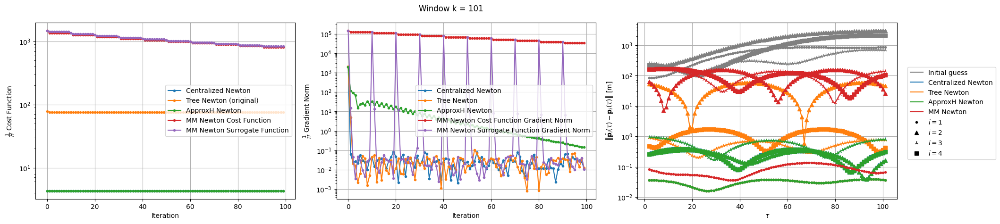


Windows:   1%|          | 3/296 [16:39<27:08:04, 333.39s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.317280625994356
Gradient norm: 1011.6423893460629
Global relative error: 1.0137233466526308
Position relative errors: 0.03607456125210984 m, 0.27079974373568033 m, 0.9375688391181202 m, 0.27196529822239285 m

Before applying the algorithm
L_norm = 4.31727712795321
Grad_L_norm = 1011.5623249492035

Before applying the algorithm
Cost function: 70.68919539586551
Gradient norm: 501.5970495618768
Global relative error: 52.19625736415327
Position relative errors: 0.03607587868743951 m, 52.18729628879021 m, 0.862322925373189 m, 0.43542302560467994 m

Iteration 1
L_norm = 4.311397976476123
Grad_L_norm = 0.031419711150992076

Iteration 1
Cost function: 69.38033142877939 (-1.85%)
Gradient norm: 4.332832057251949 (-99.14%)
Global relative error: 52.19884194006435 (0.00%)
Position relati

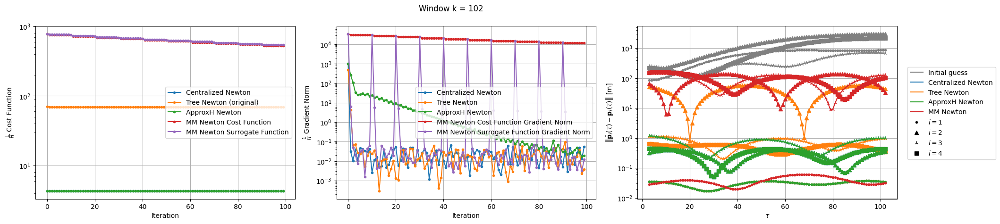


Windows:   1%|▏         | 4/296 [22:22<27:21:43, 337.34s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 64.26167962523294
Gradient norm: 768.0276789756343
Global relative error: 50.48523559825813
Position relative errors: 0.0349222465904565 m, 50.46901836602818 m, 1.1117807922019534 m, 0.631660660483724 m

Before applying the algorithm
L_norm = 4.317159650542279
Grad_L_norm = 846.475941086783

Before applying the algorithm
Cost function: 4.317159205768059
Gradient norm: 846.5249845420152
Global relative error: 1.3007854116254394
Position relative errors: 0.03492129616863853 m, 0.34023293871141685 m, 1.1715674573672472 m, 0.44999290688655874 m

Iteration 1
Cost function: 69.017242266086 (7.40%)
Gradient norm: 9.241130475095073 (-98.80%)
Global relative error: 50.71417542298543 (0.45%)
Position relative errors: 0.03209943874674136 m, 50.47752922771151 m, 4.61394846751276 m, 1.62967

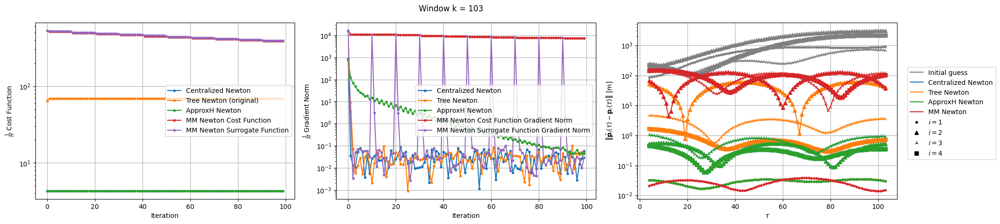


Windows:   2%|▏         | 5/296 [27:46<26:52:54, 332.56s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.302159786004246
Gradient norm: 1498.2898104380008
Global relative error: 1.2231985705706465
Position relative errors: 0.03186962050342404 m, 0.5308254113570561 m, 1.0084229163019554 m, 0.4432899264296879 m

Before applying the algorithm
L_norm = 4.302160574353604
Grad_L_norm = 1498.3065441247768

Before applying the algorithm
Cost function: 64.94467142079127
Gradient norm: 1362.3948278351465
Global relative error: 48.475068139269005
Position relative errors: 0.03187003846448358 m, 48.23682619623078 m, 4.520919226084601 m, 1.6123153586574082 m

Iteration 1
Cost function: 4.2991778391328435 (-0.07%)
Gradient norm: 196.88771559216661 (-86.86%)
Global relative error: 1.275972580127755 (4.31%)
Position relative errors: 0.03702040413785799 m, 0.4705388391132729 m, 1.132449259642543

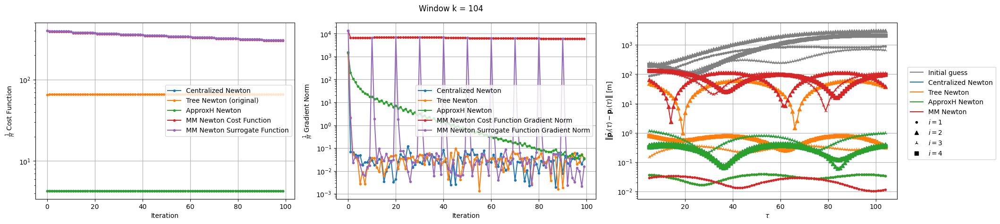


Windows:   2%|▏         | 6/296 [32:57<26:10:56, 325.02s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 62.347348001768005
Gradient norm: 252.701132852674
Global relative error: 45.66751191583781
Position relative errors: 0.036682743917507026 m, 45.660556977731986 m, 0.16876083695298563 m, 0.7767625395454476 m

Before applying the algorithm
Cost function: 4.281520332664605
Gradient norm: 837.1772487822121
Global relative error: 1.250437272982318
Position relative errors: 0.036681610762752385 m, 0.4097532885608011 m, 1.1341984345501959 m, 0.32854691396296115 m

Before applying the algorithm
L_norm = 4.281519584050824
Grad_L_norm = 837.1882229287218

Iteration 1
Cost function: 55.652568753529295 (-10.74%)
Gradient norm: 27.424869375896378 (-89.15%)
Global relative error: 44.73543830259477 (-2.04%)
Position relative errors: 0.039993030544433796 m, 43.48533817236226 m, 10.49564350220

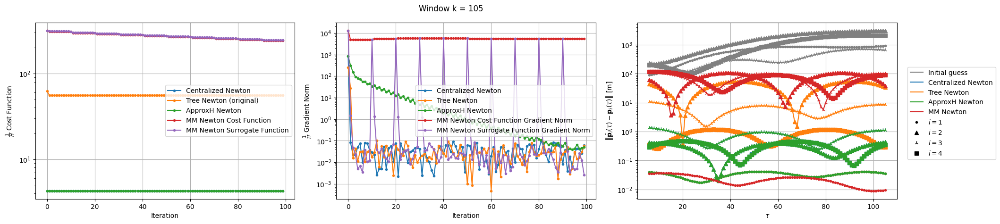


Windows:   2%|▏         | 7/296 [38:07<25:42:32, 320.25s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.302256231496958
Grad_L_norm = 1429.7496123594249

Before applying the algorithm
Cost function: 53.230363379519375
Gradient norm: 1454.5747618449361
Global relative error: 42.562374323566125
Position relative errors: 0.039553092368187416 m, 41.23286168379734 m, 10.550380473549655 m, 0.3052003540420366 m

Before applying the algorithm
Cost function: 4.302256319298169
Gradient norm: 1429.848386102873
Global relative error: 1.4276158148267202
Position relative errors: 0.03955245934524943 m, 0.41433194031227416 m, 1.328918824761908 m, 0.314364484137958 m

Iteration 1
L_norm = 4.300894392051881
Grad_L_norm = 0.027598316022948714

Iteration 1
Cost function: 46.84474144052872 (-12.00%)
Gradient norm: 15.45922837162098 (-98.94%)
Global relative error: 38.53149121045075 (-9.47%)
Position rel

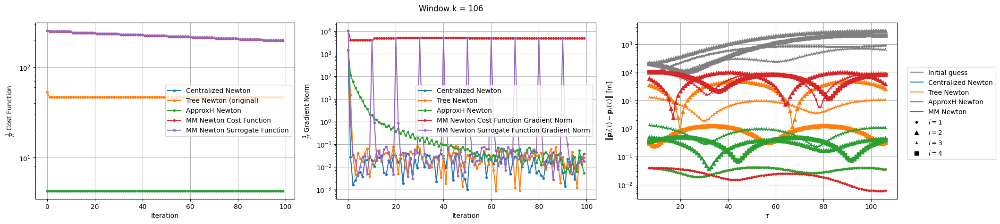


Windows:   3%|▎         | 8/296 [43:16<25:19:50, 316.63s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 44.82685738630387
Gradient norm: 793.0637806540984
Global relative error: 36.36185242887166
Position relative errors: 0.03945614707737697 m, 34.02824670645802 m, 12.813795592261501 m, 0.25746294032807043 m

Before applying the algorithm
L_norm = 4.31971195377582
Grad_L_norm = 809.3991069024478

Before applying the algorithm
Cost function: 4.319711958500635
Gradient norm: 809.37394533731
Global relative error: 1.4230588434148386
Position relative errors: 0.03945566795897881 m, 0.4831187462250147 m, 1.29107529754389 m, 0.3510831135830893 m

Iteration 1
Cost function: 50.108427043932146 (11.78%)
Gradient norm: 24.58880149030337 (-96.90%)
Global relative error: 35.53403735731818 (-2.28%)
Position relative errors: 0.04032539774840984 m, 34.04714242787285 m, 10.162246929551399 m, 0.4

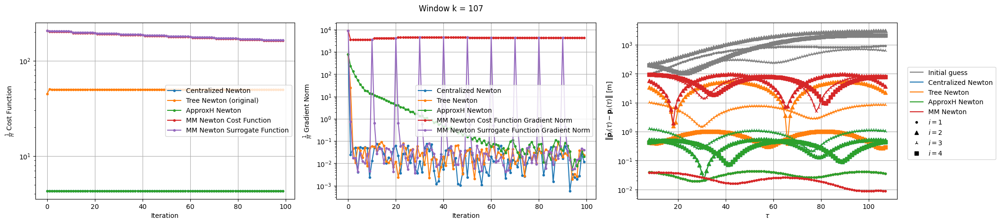


Windows:   3%|▎         | 9/296 [48:25<25:03:50, 314.39s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 48.17560962868372
Gradient norm: 251.17225762728597
Global relative error: 32.77633509469608
Position relative errors: 0.039657207098396534 m, 31.24311432304423 m, 9.89864281146193 m, 0.41097124040907246 m

Before applying the algorithm
L_norm = 4.288485105233882
Grad_L_norm = 496.8546513482559

Before applying the algorithm
Cost function: 4.288485135118704
Gradient norm: 496.85405086314216
Global relative error: 1.39952312024878
Position relative errors: 0.039655216353638396 m, 0.5350326038859992 m, 1.2173996562096425 m, 0.43447650511463254 m

Iteration 1
Cost function: 43.90510637123401 (-8.86%)
Gradient norm: 1.564173725363154 (-99.38%)
Global relative error: 31.972945151561223 (-2.45%)
Position relative errors: 0.03720830685298203 m, 31.24217714848895 m, 6.794068534894566 m

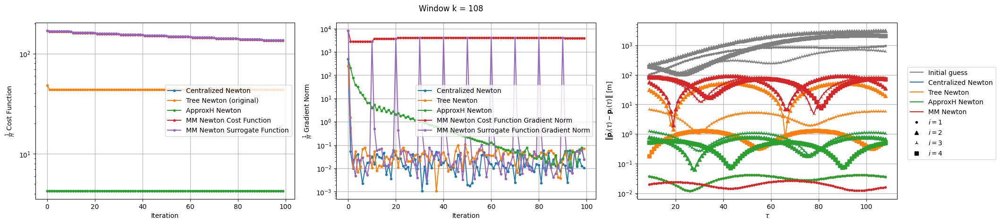


Windows:   3%|▎         | 10/296 [53:41<24:59:37, 314.61s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 42.87742445752068
Gradient norm: 258.4211653879042
Global relative error: 29.123995750634492
Position relative errors: 0.03583881962793972 m, 28.37482207632593 m, 6.558340216661605 m, 0.24713342810597672 m

Before applying the algorithm
Cost function: 4.328645390832917
Gradient norm: 515.6820183664229
Global relative error: 1.5153713120073553
Position relative errors: 0.035836209361883344 m, 0.7557102024858098 m, 1.2034405183896684 m, 0.52506949583775 m

Before applying the algorithm
L_norm = 4.328645502885895
Grad_L_norm = 515.6710120559433

Iteration 1
Cost function: 43.427028583889715 (1.28%)
Gradient norm: 0.2684227509215859 (-99.90%)
Global relative error: 28.896426413091007 (-0.78%)
Position relative errors: 0.03258245455691726 m, 28.398898632994534 m, 5.332030995659489 m

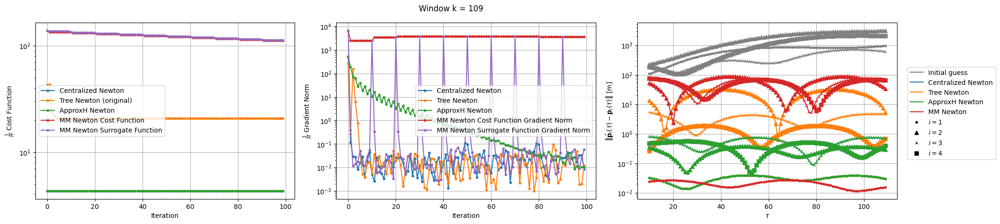


Windows:   4%|▎         | 11/296 [58:56<24:55:45, 314.90s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 20.632733564542875
Gradient norm: 1778.792035129397
Global relative error: 12.482383520213993
Position relative errors: 0.031325166623155196 m, 11.370310401708709 m, 5.140064744767998 m, 0.3218015246529683 m

Before applying the algorithm
Cost function: 4.3374708825603525
Gradient norm: 1692.1497342511182
Global relative error: 0.9844977117205144
Position relative errors: 0.03132429474258844 m, 0.3331941249988401 m, 0.7893033968927838 m, 0.48397890858314435 m

Before applying the algorithm
L_norm = 4.337471009437503
Grad_L_norm = 1692.1324322426144

Iteration 1
Cost function: 19.632126302643666 (-4.85%)
Gradient norm: 0.6094089688370807 (-99.97%)
Global relative error: 12.438492696416802 (-0.35%)
Position relative errors: 0.030280235598412624 m, 11.385776284723235 m, 4.99062633

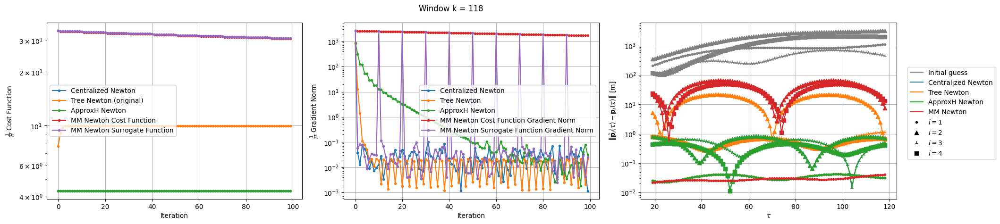


Windows:   7%|▋         | 20/296 [1:45:28<23:43:33, 309.47s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.287298782048817
Gradient norm: 550.8127031705236
Global relative error: 0.9974116317414977
Position relative errors: 0.024040126031634513 m, 0.7784242808181293 m, 0.4298986971086486 m, 0.4511033945577847 m

Before applying the algorithm
Cost function: 9.915872900247924
Gradient norm: 534.3825575692796
Global relative error: 4.021684216865352
Position relative errors: 0.024040795580434367 m, 3.8636888841989787 m, 0.8065370804904872 m, 0.770853661447668 m

Before applying the algorithm
L_norm = 4.287298786694429
Grad_L_norm = 550.7919500816524

Iteration 1
Cost function: 7.515853384332283 (-24.20%)
Gradient norm: 15.28596891718693 (-97.14%)
Global relative error: 3.946879089314037 (-1.86%)
Position relative errors: 0.025565621816045988 m, 3.8662566553015765 m, 0.553035769198883

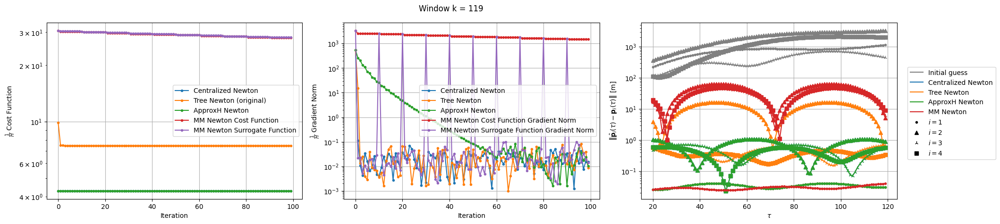


Windows:   7%|▋         | 21/296 [1:50:37<23:36:48, 309.12s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- MM Newton ---------------- ApproxH Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.29397809689833
Gradient norm: 548.1008530369703
Global relative error: 1.2814634901782633
Position relative errors: 0.02539276585665215 m, 1.0188600743014362 m, 0.49684387668564883 m, 0.5971376936625217 m

Before applying the algorithm
Cost function: 7.483764008652281
Gradient norm: 526.9403001343218
Global relative error: 2.917494808897104
Position relative errors: 0.02539369096535431 m, 2.8114039159302675 m, 0.5617094922014156 m, 0.5397206777421812 m

Before applying the algorithm
L_norm = 4.293978098198322
Grad_L_norm = 548.1263492862774

Iteration 1
Cost function: 5.1755396577831245 (-30.84%)
Gradient norm: 46.486109541073105 (-91.18%)
Global relative error: 2.9669108480000643 (1.69%)
Position relative errors: 0.02645572539471854 m, 2.8450370851621947 m, 0.523384962689925

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 7
Cost function: 9.768275004423819 (-0.00%)
Gradient norm: 0.07087285567474887 (27.24%)
Global relative error: 2.446948616010684 (0.00%)
Position relative errors: 0.009321087984978448 m, 2.1891654009590944 m, 0.5948873444423787 m, 0.9168050956442082 m

Iteration 7
Cost function: 4.268009385523322 (-0.00%)
Gradient norm: 18.74133073682237 (-41.11%)
Global relative error: 1.3645884408805031 (-0.02%)
Position relative errors: 0.009301238076101222 m, 1.0465214449089308 m, 0.6065380697643321 m, 0.6315995644257324 m

Iteration 7
L_norm = 4.267968648227382
Grad_L_norm = 0.009389399449652822

Iteration 3
Cost function: 20.575435217868367 (-0.00%)
Gradient norm: 0.022413720195186924 (50.68%)
Global relative error: 10.784357062199827 (0.00%)
Position relative errors: 0.007352514105538109 m, 8.036269199957264 m, 5.739061465403926 m, 4.333223586938558 m

Iteration 8
Cost function: 9.768274966130924 (-0.00%)
Gradient norm: 0.04705946918001292 (-33.60%)
Global relative error: 2.44694861366

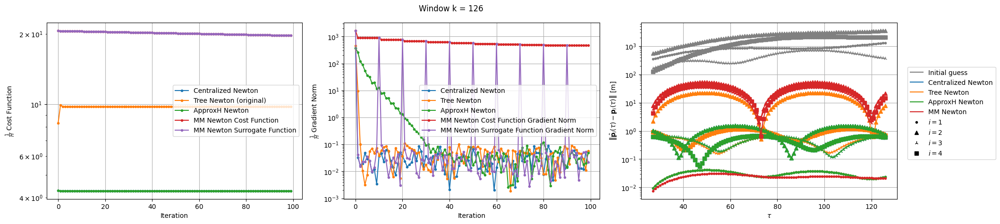


Windows:   9%|▉         | 28/296 [2:26:42<23:00:14, 309.01s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 9.873962139532733
Gradient norm: 2042.9725209786295
Global relative error: 3.7874592249737122
Position relative errors: 0.011592096285417687 m, 3.636461023903638 m, 0.604372262549299 m, 0.8689105611017648 m

Before applying the algorithm
Cost function: 4.313367022561462
Gradient norm: 2088.574395245987
Global relative error: 1.2945374588703975
Position relative errors: 0.011590027072443469 m, 0.9612409801040278 m, 0.6146185912213762 m, 0.6115151811610138 m

Before applying the algorithm
L_norm = 4.313367026581286
Grad_L_norm = 2088.582758035927

Iteration 1
Cost function: 10.395242546522184 (5.28%)
Gradient norm: 0.5103323105200493 (-99.98%)
Global relative error: 3.768391346805498 (-0.50%)
Position relative errors: 0.014786402876487146 m, 3.634859692305847 m, 0.518806164129633

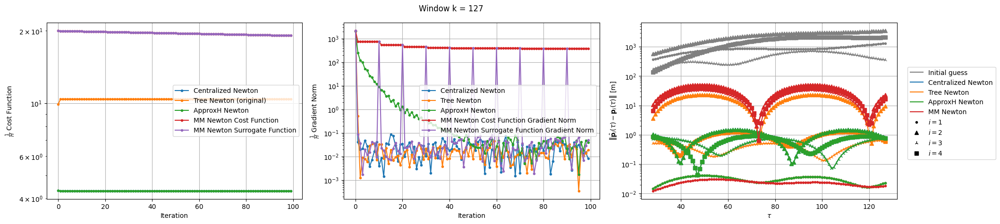


Windows:  10%|▉         | 29/296 [2:31:51<22:55:23, 309.08s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.301122431073366
Gradient norm: 1033.5612728487931
Global relative error: 1.4659480198546326
Position relative errors: 0.016427065044574193 m, 0.9669978256425634 m, 0.7227105512600802 m, 0.8314665708163951 m

Before applying the algorithm
Cost function: 10.41872807431439
Gradient norm: 993.3598383084259
Global relative error: 5.218309768525058
Position relative errors: 0.01642962397355229 m, 5.132118874602132 m, 0.5201069233635329 m, 0.7878512466081496 m

Before applying the algorithm
L_norm = 4.301122444658002
Grad_L_norm = 1033.610309984763

Iteration 1
Cost function: 9.744254522170184 (-6.47%)
Gradient norm: 0.9697092235570406 (-99.90%)
Global relative error: 5.182610777184899 (-0.68%)
Position relative errors: 0.020564542204284334 m, 5.128838334525971 m, 0.5310148971626446

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 53
L_norm = 4.272812187769849
Grad_L_norm = 0.05269994611817168

Iteration 55
Cost function: 7.746141183953673 (0.00%)
Gradient norm: 0.07564279108425119 (22.99%)
Global relative error: 7.9053176416622515 (0.00%)
Position relative errors: 0.031573111029594036 m, 7.871718243490728 m, 0.5940122932188434 m, 0.41952084370495074 m

Iteration 4
Cost function: 17.692286749296642 (0.00%)
Gradient norm: 0.020543703110698596 (436.49%)
Global relative error: 26.529593979886425 (-0.00%)
Position relative errors: 0.026804703391765605 m, 18.92607938500307 m, 13.041146795905393 m, 13.249373422343082 m

Iteration 54
Cost function: 4.272812187701897 (-0.00%)
Gradient norm: 0.020267963896199878 (-23.55%)
Global relative error: 1.0765511401296495 (0.00%)
Position relative errors: 0.031571709435548996 m, 0.7035421924118023 m, 0.4967577182401691 m, 0.6451537145919162 m

Iteration 54
L_norm = 4.272812188761286
Grad_L_norm = 0.006858836872790877

Iteration 56
Cost function: 7.746141224198198 (0.00%

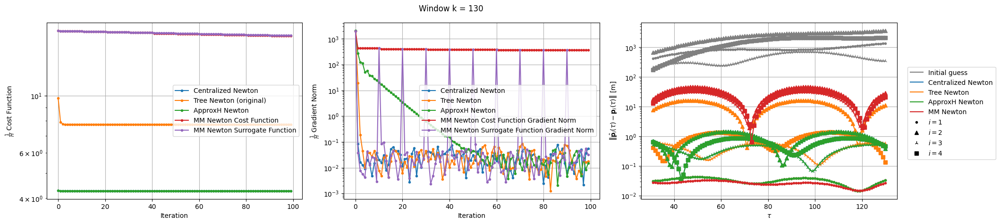


Windows:  11%|█         | 32/296 [2:47:19<22:42:23, 309.63s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7.882886021301183
Gradient norm: 3010.0440790260664
Global relative error: 8.832308451882229
Position relative errors: 0.031921026166894614 m, 8.805824626346284 m, 0.591276782403593 m, 0.34097374570330835 m

Before applying the algorithm
Cost function: 4.301974527282604
Gradient norm: 2995.05687579031
Global relative error: 0.9938305619716263
Position relative errors: 0.031919572391902885 m, 0.6197357596103459 m, 0.4888388612913806 m, 0.6030272434962866 m

Before applying the algorithm
L_norm = 4.301974509022627
Grad_L_norm = 2995.0138990445625

Iteration 1
Cost function: 6.952574222631923 (-11.80%)
Gradient norm: 23.774601428692385 (-99.21%)
Global relative error: 8.840532968430333 (0.09%)
Position relative errors: 0.026444562884053884 m, 8.807484246363314 m, 0.637147242864586

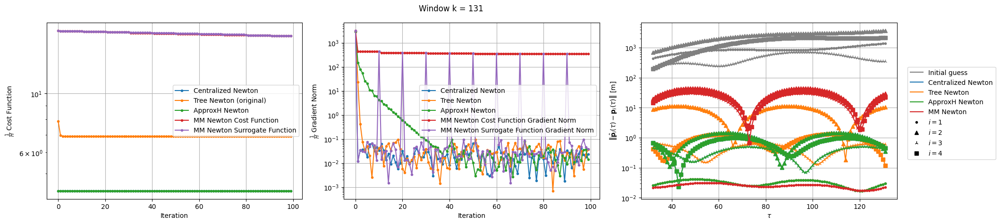


Windows:  11%|█         | 33/296 [2:52:26<22:33:50, 308.86s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6.964658157965931
Gradient norm: 1222.1520223219948
Global relative error: 9.300393638545824
Position relative errors: 0.027437134315797734 m, 9.272321253180788 m, 0.6321882469355515 m, 0.3477193199930866 m

Before applying the algorithm
Cost function: 4.290710410088164
Gradient norm: 1335.9677007202356
Global relative error: 0.9592386923545102
Position relative errors: 0.027436506557270555 m, 0.5882887444612599 m, 0.4408350508623199 m, 0.6156005038921529 m

Before applying the algorithm
L_norm = 4.290710418998676
Grad_L_norm = 1335.9603364407642

Iteration 1
Cost function: 7.68223869968816 (10.30%)
Gradient norm: 26.76951329946866 (-97.81%)
Global relative error: 9.321313830014033 (0.22%)
Position relative errors: 0.0282186527735505 m, 9.270338746444299 m, 0.6594543590869539 m

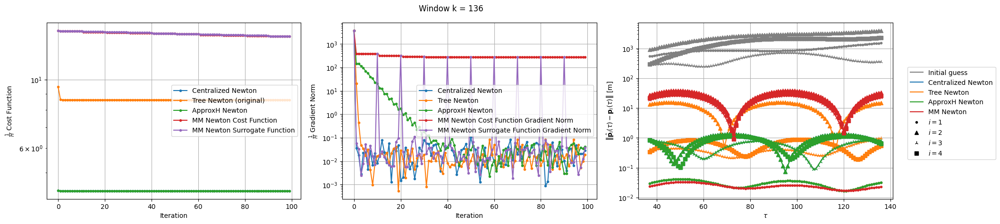


Windows:  13%|█▎        | 38/296 [3:18:23<22:24:48, 312.75s/it]

-------- Centralized Newton ---------------- Tree Newton --------
-------- ApproxH Newton --------
-------- MM Newton --------


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8.584028471946304
Gradient norm: 337.94063100229755
Global relative error: 13.80681468301304
Position relative errors: 0.031467365272878856 m, 13.795202963111423 m, 0.413026616964655 m, 0.38582894463674006 m

Before applying the algorithm
Cost function: 4.341123147794959
Gradient norm: 440.63060098467497
Global relative error: 1.3583954675439154
Position relative errors: 0.03146676172291763 m, 0.773671892406139 m, 0.7788884843337063 m, 0.7993812594635401 m

Before applying the algorithm
L_norm = 4.341123141515881
Grad_L_norm = 440.636118046097

Iteration 1
Cost function: 9.256831575142462 (7.84%)
Gradient norm: 30.121702622504866 (-91.09%)
Global relative error: 13.80364744129366 (-0.02%)
Position relative errors: 0.029377002706039965 m, 13.79376010938996 m, 0.4232804655781748 

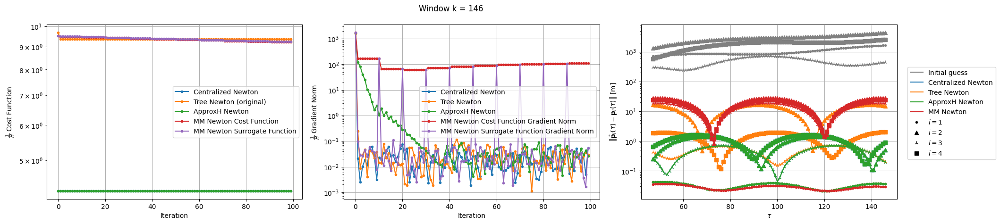


Windows:  16%|█▌        | 48/296 [4:10:30<21:38:00, 314.03s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 9.351573118056704
Gradient norm: 578.5692174134097
Global relative error: 16.387648480867956
Position relative errors: 0.04262740488453591 m, 16.273286478285698 m, 0.3874546658108491 m, 1.8929365284794917 m

Before applying the algorithm
Cost function: 4.255043884273559
Gradient norm: 685.0743389420223
Global relative error: 0.826474139575185
Position relative errors: 0.04262781958842583 m, 0.31304160025163136 m, 0.222328367655046 m, 0.7306240384327741 m

Before applying the algorithm
L_norm = 4.255043887061966
Grad_L_norm = 685.0945816625359

Iteration 1
Cost function: 11.032627880395859 (17.98%)
Gradient norm: 8.279598009474961 (-98.57%)
Global relative error: 16.339270268539813 (-0.30%)
Position relative errors: 0.04697212357286342 m, 16.276275756313336 m, 0.5544588997783255

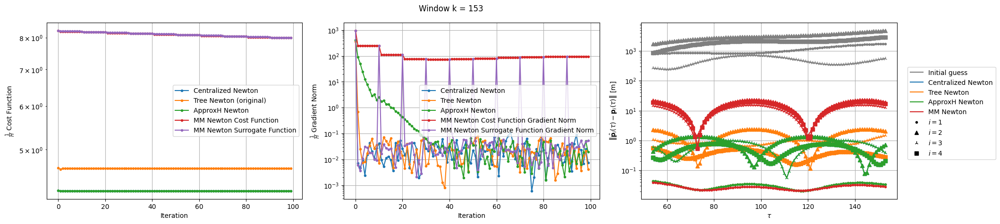


Windows:  19%|█▊        | 55/296 [4:46:53<20:55:26, 312.56s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.690771145905694
Gradient norm: 2126.9412726432456
Global relative error: 2.5248826866053267
Position relative errors: 0.04311335207960445 m, 2.248173240053493 m, 1.0179176132517136 m, 0.5317260386126221 m

Before applying the algorithm
Cost function: 4.249410164526319
Gradient norm: 2241.751402830612
Global relative error: 0.7999238488221311
Position relative errors: 0.043112383909820924 m, 0.5137886931943698 m, 0.5601998076750972 m, 0.24538397151248958 m

Before applying the algorithm
L_norm = 4.249410170958152
Grad_L_norm = 2241.7634434541674

Iteration 1
Cost function: 4.635215161993821 (-1.18%)
Gradient norm: 0.036364927582586325 (-100.00%)
Global relative error: 2.5515974566911543 (1.06%)
Position relative errors: 0.043337452338068884 m, 2.253055197086487 m, 0.9365462009

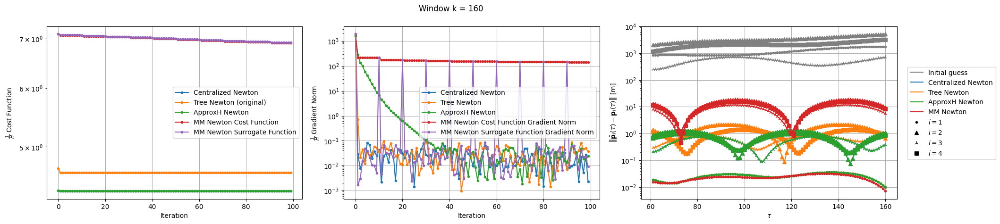


Windows:  21%|██        | 62/296 [5:23:29<20:23:19, 313.67s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.683919613917564
Gradient norm: 253.1347913322593
Global relative error: 1.6781334860513097
Position relative errors: 0.0181296060987203 m, 1.2545664050307797 m, 0.3127126237347802 m, 1.0696122951130764 m

Before applying the algorithm
Cost function: 4.417183179692296
Gradient norm: 527.0026862218983
Global relative error: 1.200977753524221
Position relative errors: 0.018129255749708452 m, 0.9370756602767162 m, 0.21369030196986907 m, 0.7198904376975307 m

Before applying the algorithm
L_norm = 4.417183188810717
Grad_L_norm = 527.0121041030518

Iteration 1
Cost function: 4.644339907220157 (-0.85%)
Gradient norm: 0.24052694618847217 (-99.90%)
Global relative error: 1.626559699817548 (-3.07%)
Position relative errors: 0.017470658752904055 m, 1.094425365130702 m, 0.125546752057366

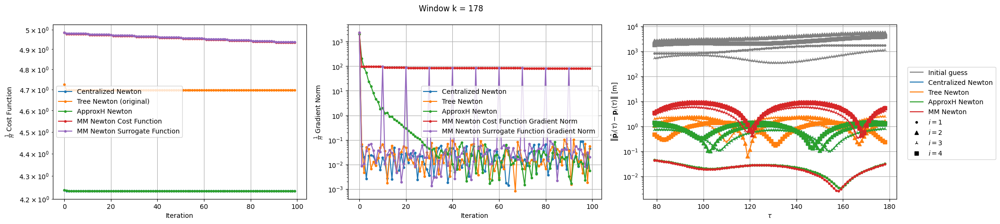


Windows:  27%|██▋       | 80/296 [6:55:19<17:44:39, 295.74s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.223447031793737
Grad_L_norm = 515.1877172742472

Before applying the algorithm
Cost function: 4.223447032546825
Gradient norm: 515.1763941078057
Global relative error: 1.9201784360778005
Position relative errors: 0.043574103128071716 m, 1.1429784690581026 m, 0.7390695593423224 m, 1.3537217234986825 m

Before applying the algorithm
Cost function: 4.718260189222481
Gradient norm: 281.0448431847536
Global relative error: 2.4364987072218542
Position relative errors: 0.04357636325342493 m, 1.2262486214484172 m, 2.06685817787156 m, 0.3987859914876107 m

Iteration 1
L_norm = 4.218931426191301
Grad_L_norm = 0.04151595755442203

Iteration 1
Cost function: 4.219564245031847 (-0.09%)
Gradient norm: 146.37974021278018 (-71.59%)
Global relative error: 2.021799287953734 (5.29%)
Position relative

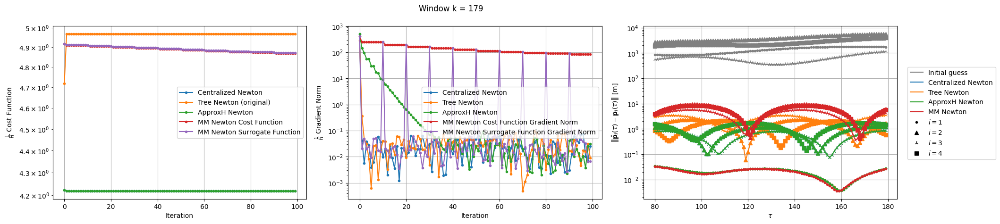


Windows:  27%|██▋       | 81/296 [7:00:02<17:25:45, 291.84s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.2375906496703255
Gradient norm: 758.9323891234187
Global relative error: 2.0787473006306767
Position relative errors: 0.03307188607582015 m, 1.1672675306847438 m, 0.8197267160760556 m, 1.511830073894767 m

Before applying the algorithm
Cost function: 4.992257081046307
Gradient norm: 624.2268906044811
Global relative error: 3.479998711830762
Position relative errors: 0.03307377545977426 m, 1.3549599230383649 m, 3.1141129067816267 m, 0.7587291566353137 m

Before applying the algorithm
L_norm = 4.237590646964911
Grad_L_norm = 758.9596112243373

Iteration 1
Cost function: 4.233462820303268 (-0.10%)
Gradient norm: 396.9473508501569 (-47.70%)
Global relative error: 2.095320533842447 (0.80%)
Position relative errors: 0.02512913471254507 m, 1.0885296007411167 m, 0.8051375634654346 m,

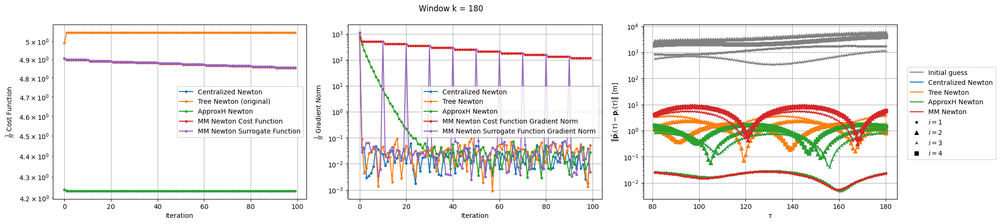


Windows:  28%|██▊       | 82/296 [7:04:50<17:17:25, 290.87s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.055347587580705
Gradient norm: 697.2949843892288
Global relative error: 3.8540169997148697
Position relative errors: 0.025291387502532212 m, 1.4930451523240211 m, 3.388125682737677 m, 1.0696815861982967 m

Before applying the algorithm
Cost function: 4.225292503233132
Gradient norm: 711.7653290888934
Global relative error: 2.07986563542233
Position relative errors: 0.025290305438048732 m, 1.150563687032311 m, 0.803652336194584 m, 1.5347790613051224 m

Before applying the algorithm
L_norm = 4.225292499669445
Grad_L_norm = 711.8401733150014

Iteration 1
Cost function: 5.0921408434591315 (0.73%)
Gradient norm: 0.011033270015508773 (-100.00%)
Global relative error: 3.893833101482192 (1.03%)
Position relative errors: 0.02154780056834144 m, 1.4613312485288628 m, 3.485261027184888 m

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Before applying the algorithm
Cost function: 5.133593057568233
Gradient norm: 3488.7637356904347
Global relative error: 3.987957132697668
Position relative errors: 0.02155540454033314 m, 1.581215711784709 m, 3.5573489176672943 m, 0.8650750448345879 m

Iteration 1
Cost function: 4.26591415324634 (-0.10%)
Gradient norm: 119.28413831903542 (-96.53%)
Global relative error: 1.8494846681331025 (1.08%)
Position relative errors: 0.023723489493183002 m, 1.080727719198248 m, 0.6901618222120682 m, 1.3325667431077863 m

Iteration 1
Cost function: 5.055634503501422 (-1.52%)
Gradient norm: 0.08302402301748799 (-100.00%)
Global relative error: 3.6987552013325358 (-7.25%)
Iteration 1
L_norm = 4.265659584905607
Grad_L_norm = 0.0654710149637061
Position relative errors: 0.02356458278986757 m, 1.568573952261079 m, 3.3174178575249718 m, 0.46318741939828023 m


Before applying the algorithm
Cost function: 4.830141478982425
Gradient norm: 3209.8962985604235
Global relative error: 8.1107372508467
Position re

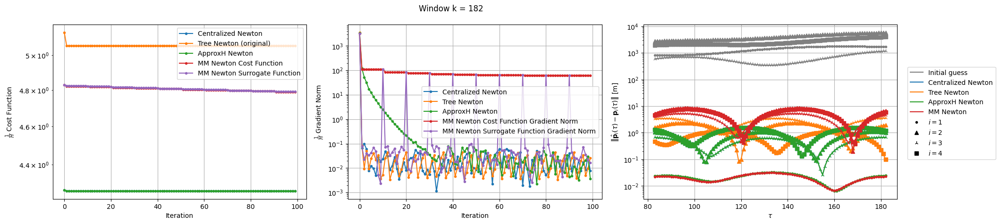


Windows:  28%|██▊       | 84/296 [7:14:33<17:11:11, 291.85s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.267137049756577
Gradient norm: 853.879539342346
Global relative error: 1.7557051647692459
Position relative errors: 0.023995536660740637 m, 1.0335067867358487 m, 0.6618330964938155 m, 1.2552945601098504 m

Before applying the algorithm
Cost function: 5.030544250347882
Gradient norm: 352.717727255644
Global relative error: 3.7934083903832834
Position relative errors: 0.02399580246745124 m, 1.682080733381091 m, 3.373560768422516 m, 0.4231521690599199 m

Before applying the algorithm
L_norm = 4.267137037260399
Grad_L_norm = 853.8729174042713

Iteration 1
Cost function: 4.260545022739061 (-0.15%)
Gradient norm: 205.6942818550411 (-75.91%)
Global relative error: 1.6423819512052413 (-6.45%)
Position relative errors: 0.026189203191677845 m, 1.0503818784189816 m, 0.7473141550069842 m

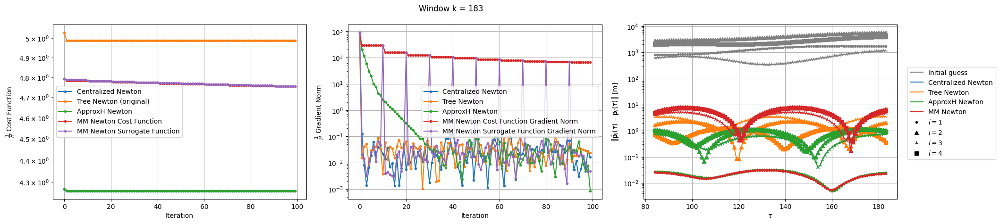


Windows:  29%|██▊       | 85/296 [7:19:16<16:57:01, 289.20s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.98762422865173
Gradient norm: 775.3868092871285
Global relative error: 3.8558080129479593
Position relative errors: 0.026823978112931492 m, 1.7770457705412965 m, 3.36459554621851 m, 0.6230056560955916 m

Before applying the algorithm
Cost function: 4.265327533768544
Gradient norm: 812.9389342152972
Global relative error: 1.618632928572785
Position relative errors: 0.02682359261976414 m, 1.0594685117792313 m, 0.7389029832967038 m, 0.9750903815610804 m

Before applying the algorithm
L_norm = 4.265327533656069
Grad_L_norm = 812.9224302191249

Iteration 1
Cost function: 4.881243055717186 (-2.13%)
Gradient norm: 0.11291620693697274 (-99.99%)
Global relative error: 3.441856728055987 (-10.74%)
Position relative errors: 0.03004636592767979 m, 1.9607814553218241 m, 2.8068032772242026 

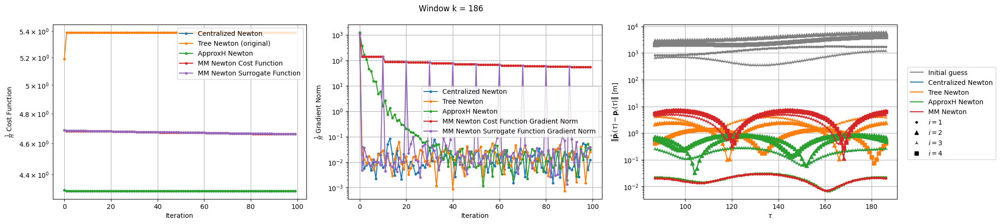


Windows:  30%|██▉       | 88/296 [7:33:33<16:34:54, 287.00s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.3800686935255335
Gradient norm: 1748.5109515456832
Global relative error: 4.645000657064062
Position relative errors: 0.021790502631125797 m, 2.27780125773893 m, 4.023520065505463 m, 0.445487728472925 m

Before applying the algorithm
L_norm = 4.287614043164132
Grad_L_norm = 1850.4388321706085

Before applying the algorithm
Cost function: 4.2876140543503505
Gradient norm: 1850.4580605106564
Global relative error: 0.9295392829659546
Position relative errors: 0.021790410809196196 m, 0.71238251466432 m, 0.2403323818393373 m, 0.5461860448653438 m

Iteration 1
Cost function: 5.838619881111008 (8.52%)
Gradient norm: 0.16012682562709327 (-99.99%)
Global relative error: 5.644530982317178 (21.52%)
Position relative errors: 0.023983857836927996 m, 2.3057679602349928 m, 5.124484898784367

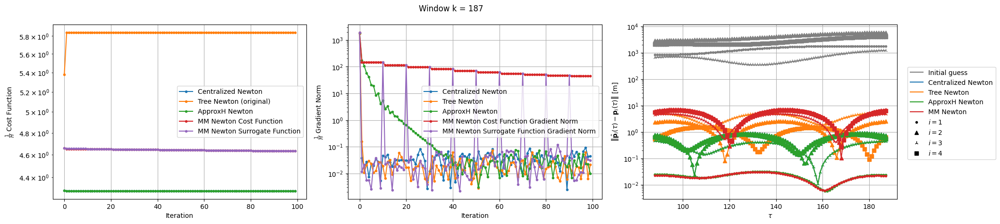


Windows:  30%|███       | 89/296 [7:38:20<16:30:08, 287.00s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.288009254598841
Gradient norm: 450.84366767928
Global relative error: 1.0676477579037635
Position relative errors: 0.024126670786140055 m, 0.7565134410779483 m, 0.4437605957921695 m, 0.6083197841662233 m

Before applying the algorithm
L_norm = 4.2880092563553
Grad_L_norm = 450.88927184183285

Before applying the algorithm
Cost function: 5.826997522819024
Gradient norm: 586.0359522309484
Global relative error: 5.66834274276248
Position relative errors: 0.024126632044098352 m, 2.3675920520182996 m, 5.115852531100454 m, 0.593366037386378 m

Iteration 1
Cost function: 4.285433597965844 (-0.06%)
Gradient norm: 134.04614571409508 (-70.27%)
Global relative error: 1.1528348027855346 (7.98%)
Position relative errors: 0.0224767455492396 m, 0.7738804312224757 m, 0.5185393173901351 m, 0.

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 71
L_norm = 4.2986662660873725
Grad_L_norm = 0.005636310223521466

Iteration 73
Cost function: 5.7573101617564975 (0.00%)
Gradient norm: 0.0389355260929676 (120.96%)
Global relative error: 5.917348470479584 (0.00%)
Position relative errors: 0.027134800013353565 m, 2.4966718733885727 m, 5.302654859277539 m, 0.814096258657906 m

Iteration 72
Cost function: 4.298666265669098 (-0.00%)
Gradient norm: 0.008345991660550152 (-37.14%)
Global relative error: 1.6405957887201417 (-0.00%)
Position relative errors: 0.027134873395581165 m, 1.0796249927813693 m, 0.8162529601484033 m, 0.926800281511489 m

Iteration 4
Cost function: 4.641034291341295 (-0.00%)
Gradient norm: 0.01371498374852737 (95.70%)
Global relative error: 9.588845994081112 (0.00%)
Position relative errors: 0.02557723679422179 m, 6.214672954738751 m, 4.487846645060454 m, 5.760413670310834 m

Iteration 72
L_norm = 4.298666262417559
Grad_L_norm = 0.02238090794073689

Iteration 74
Cost function: 5.757310105527137 (-0.00%)
Gradi

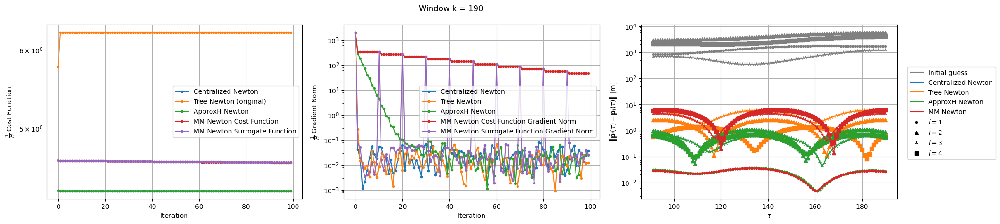


Windows:  31%|███       | 92/296 [7:53:06<16:43:07, 295.04s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 6.231036475309089
Gradient norm: 348.9359733618212
Global relative error: 6.48051905457154
Position relative errors: 0.030337079208917022 m, 2.582268006509304 m, 5.910702054921283 m, 0.6258555238627234 m

Before applying the algorithm
L_norm = 4.301342400550649
Grad_L_norm = 337.6522123100501

Before applying the algorithm
Cost function: 4.301342402564317
Gradient norm: 337.687692816747
Global relative error: 1.338971383085666
Position relative errors: 0.030337031061911504 m, 0.9412542823492082 m, 0.7273733184752856 m, 0.6139152837471924 m

Iteration 1
Cost function: 6.3252804034495425 (1.51%)
Gradient norm: 0.05938694858565539 (-99.98%)
Global relative error: 6.7505425111816955 (4.17%)
Position relative errors: 0.031597834927236744 m, 2.578620611950661 m, 6.11413330989714 m, 1

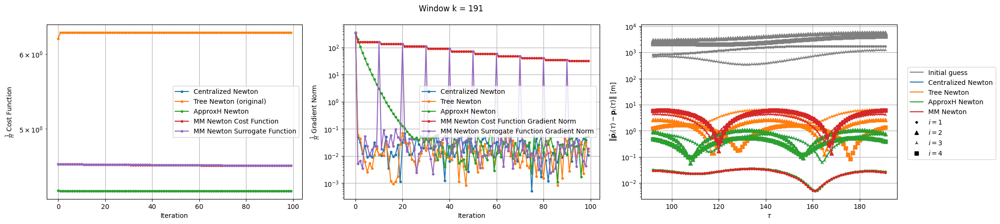


Windows:  31%|███▏      | 93/296 [7:57:50<16:26:23, 291.55s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- MM Newton ---------------- ApproxH Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.279052780110609
Grad_L_norm = 639.3438780123763

Before applying the algorithm
Cost function: 6.295215875715242
Gradient norm: 770.3658769211505
Global relative error: 6.707152375492552
Position relative errors: 0.03143123096628353 m, 2.6222591975154277 m, 6.033771795977908 m, 1.3047046401811675 m

Before applying the algorithm
Cost function: 4.279052774102737
Gradient norm: 639.283491554683
Global relative error: 1.2751682225989494
Position relative errors: 0.031431146342644475 m, 0.8881536191550871 m, 0.7907916192628117 m, 0.4592354867712115 m

Iteration 1
Cost function: 6.214183054636975 (-1.29%)
Gradient norm: 0.06619062048404357 (-99.99%)
Global relative error: 6.582841155317792 (-1.85%)
Position relative errors: 0.03272833261808496 m, 2.624290412447968 m, 5.984227191884438 m,

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 7
Cost function: 4.473217450903628 (-0.00%)
Gradient norm: 0.03324111159967122 (110.76%)
Global relative error: 8.236719439821943 (0.00%)
Position relative errors: 0.034874038151866536 m, 5.282604781936039 m, 3.518580950528243 m, 5.249381174403127 m

Iteration 8
Cost function: 4.473217453990517 (0.00%)
Gradient norm: 0.046304542177733866 (39.30%)
Global relative error: 8.23671944007388 (0.00%)
Position relative errors: 0.034874038193583874 m, 5.282604781622977 m, 3.51858095052231 m, 5.249381175117179 m

STOP on Iteration 9
Cost function = 4.473217461375239 (0.00%)
Gradient norm = 0.05684688487330459 (22.77%)
Global relative error = 8.236719440516692 (0.00%)
Final position relative errors: 0.034874037331326435 m, 5.282604781918181 m, 3.518580950941255 m, 5.2493811752398285 m


Majorization-Minimization Iteration 10
Before applying the algorithm
Cost function: 4.472655800083372
Gradient norm: 48.07438006982008
Global relative error: 8.236719440516692
Position relative errors: 0

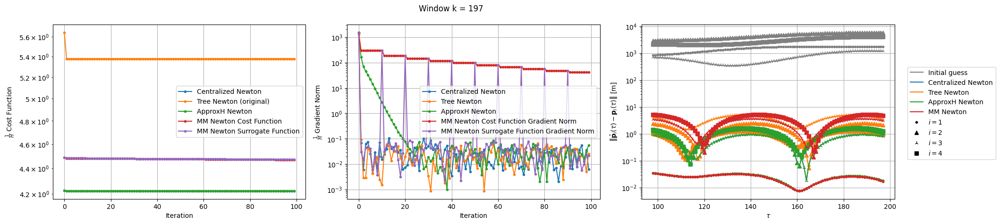


Windows:  33%|███▎      | 99/296 [8:26:33<15:54:00, 290.56s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.391835615510928
Gradient norm: 3079.797871735889
Global relative error: 4.837482983634566
Position relative errors: 0.0348001581311987 m, 2.3538845721368844 m, 4.1113926820747375 m, 0.9775964085456587 m

Before applying the algorithm
Cost function: 4.235448790513067
Gradient norm: 3191.8220363257115
Global relative error: 2.0890963841858228
Position relative errors: 0.0348003332401689 m, 1.2637476355713049 m, 0.8924711842685121 m, 1.4034056100817167 m

Before applying the algorithm
L_norm = 4.235448771453409
Grad_L_norm = 3191.7601896122774

Iteration 1
Cost function: 5.3947799425268625 (0.05%)
Gradient norm: 0.27848311328454695 (-99.99%)
Global relative error: 4.67332292872746 (-3.39%)
Position relative errors: 0.03190378752514166 m, 2.3397993733029216 m, 4.023441200007684 m

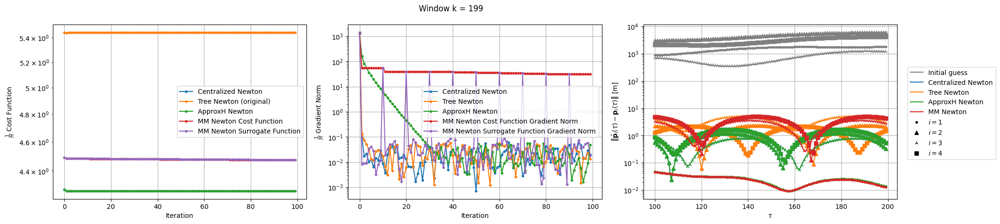


Windows:  34%|███▍      | 101/296 [8:35:59<15:31:55, 286.75s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.463542906522182
Gradient norm: 1977.442798717084
Global relative error: 4.522017034983678
Position relative errors: 0.045632494107087404 m, 2.2528311376438945 m, 3.673043952991236 m, 1.3711441438514997 m

Before applying the algorithm
Cost function: 4.28208263414719
Gradient norm: 1878.3739631410647
Global relative error: 1.0979865118025705Before applying the algorithm
L_norm = 4.282082626460283
Grad_L_norm = 1878.3450374008382


Position relative errors: 0.045632909931405966 m, 0.48295727615584927 m, 0.6050901350429443 m, 0.7772424128415246 m

Iteration 1
Cost function: 5.551080931987578 (1.60%)
Gradient norm: 0.16949743799885525 (-99.99%)
Global relative error: 4.913764777091304 (8.66%)
Position relative errors: 0.05387913801046124 m, 2.6600584140615235 m, 3.64432023189627 

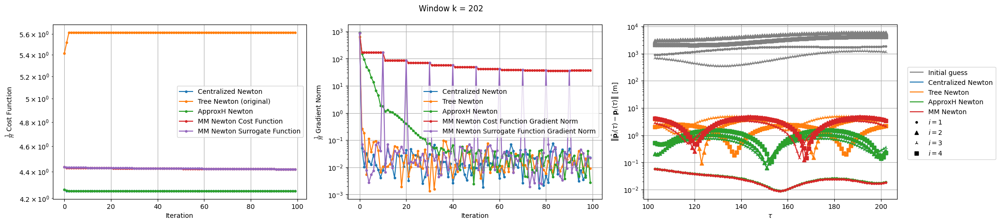


Windows:  35%|███▌      | 104/296 [8:50:17<15:16:19, 286.35s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.263377892651778
Grad_L_norm = 513.3337785390385

Before applying the algorithm
Cost function: 4.263377897033665
Gradient norm: 513.3227458386664
Global relative error: 0.6992828214898118
Position relative errors: 0.05719300990967451 m, 0.203053792510367 m, 0.4601720935414179 m, 0.48242204792824495 m

Before applying the algorithm
Cost function: 5.67136709733978
Gradient norm: 533.8699368751812
Global relative error: 5.099025778444048
Position relative errors: 0.05719215154248673 m, 3.845516368428067 m, 2.606203479983297 m, 2.1015411188862196 m

Iteration 1
Cost function: 4.261261991912914 (-0.05%)
Gradient norm: 219.98548299969298 (-57.14%)
Global relative error: 0.7851499505294318 (12.28%)
Position relative errors: 0.05754353335718455 m, 0.32489297464119726 m, 0.4820860041340742 m

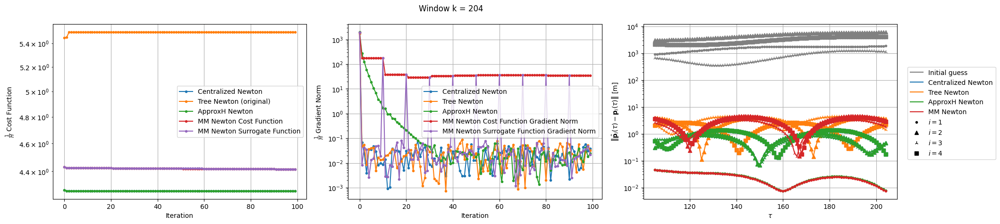


Windows:  36%|███▌      | 106/296 [8:59:50<15:07:57, 286.72s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.483033920104247
Gradient norm: 817.1744453959976
Global relative error: 4.8133124447561775
Position relative errors: 0.04431774886944207 m, 3.8670448903718824 m, 1.9430828733544487 m, 2.1062717986793773 m

Before applying the algorithm
Cost function: 4.2710135996811935
Gradient norm: 873.5133932237073
Global relative error: 0.8367207250025919
Position relative errors: 0.044318722319043796 m, 0.3459155716206293 m, 0.605435157284533 m, 0.4603517461833716 m

Before applying the algorithm
L_norm = 4.271013623324878
Grad_L_norm = 873.5752153595602

Iteration 1
Cost function: 5.304465957473096 (-3.26%)
Gradient norm: 4.074127146903901 (-99.50%)
Global relative error: 4.527107708470581 (-5.95%)
Position relative errors: 0.0427653959436014 m, 3.872287217253243 m, 2.0133608381620633 m

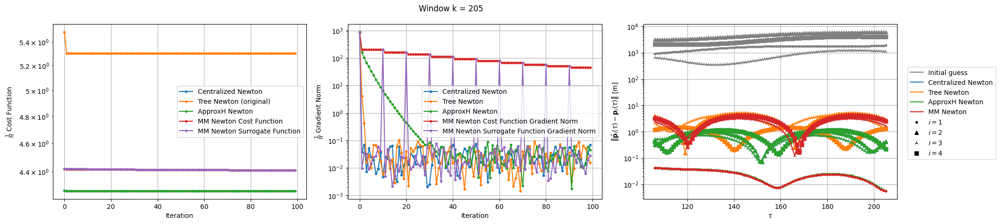


Windows:  36%|███▌      | 107/296 [9:04:35<15:01:38, 286.24s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.2623136008914
Gradient norm: 690.2044686553041
Global relative error: 0.7221497532537211
Position relative errors: 0.042208092040886803 m, 0.35037366832121164 m, 0.5225014132470457 m, 0.35205904357854656 m

Before applying the algorithm
L_norm = 4.262313603784674
Grad_L_norm = 690.2723212932134

Before applying the algorithm
Cost function: 5.293360274168307
Gradient norm: 499.4394778734371
Global relative error: 4.255812300297681
Position relative errors: 0.042207179406137454 m, 3.6462369929217258 m, 1.8013636023541977 m, 1.2530630222982289 m

Iteration 1
Cost function: 4.260017578180309 (-0.05%)
Gradient norm: 184.0218453444874 (-73.34%)
Global relative error: 0.6068324025938705 (-15.97%)
Position relative errors: 0.034128077188458054 m, 0.3460859932869849 m, 0.4224067364996

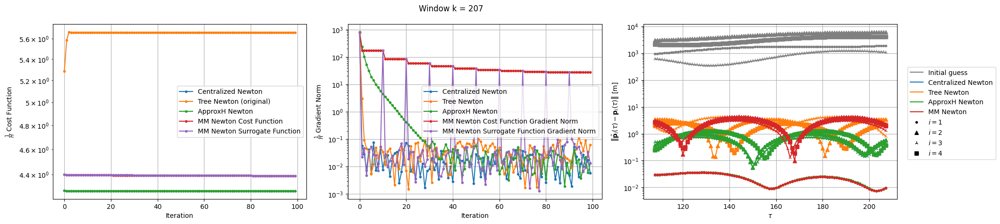


Windows:  37%|███▋      | 109/296 [9:14:11<14:55:00, 287.17s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------

-------- MM Newton --------


Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.309133530403197
Grad_L_norm = 944.3637342962979

Before applying the algorithm
Cost function: 5.735006486203994
Gradient norm: 314.25530063167395
Global relative error: 4.38341899373698
Position relative errors: 0.02941028134783318 m, 3.48284677295173 m, 1.5775059982603419 m, 2.143531690268339 m

Before applying the algorithm
Cost function: 4.30913354497128
Gradient norm: 944.3651596338174
Global relative error: 0.7039741957271612
Position relative errors: 0.029411248151729838 m, 0.42533432264899024 m, 0.49436975245029974 m, 0.26343931820595434 m

Iteration 1
L_norm = 4.3009136463285405
Grad_L_norm = 0.07509146712275414

Iteration 1
Cost function: 5.392667657142884 (-5.97%)
Gradient norm: 1.2209685808392323 (-99.61%)
Global relative error: 4.245112304164836 (-3.16%)
Position relati

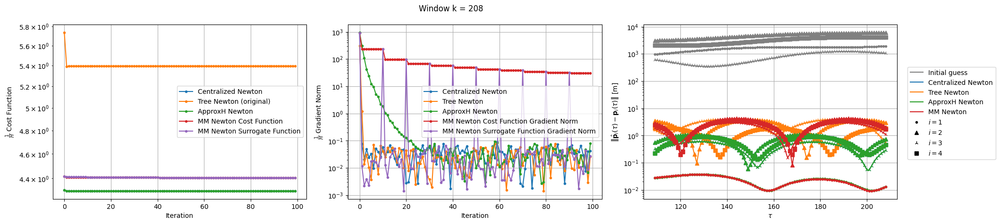


Windows:  37%|███▋      | 110/296 [9:18:58<14:49:57, 287.08s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.3179943922328246
Gradient norm: 798.988702358812
Global relative error: 4.115073242057173
Position relative errors: 0.028489135826982676 m, 3.378202357034688 m, 1.4337791079113618 m, 1.861456933508533 m

Before applying the algorithm
Cost function: 4.287049659350126
Gradient norm: 795.4254457516992
Global relative error: 0.7429131796054314
Position relative errors: 0.028490251351321706 m, 0.6043184800264331 m, 0.3291698178124214 m, 0.27848216357828814 m

Before applying the algorithm
L_norm = 4.287049651575293
Grad_L_norm = 795.3103025985963

Iteration 1
Cost function: 5.524879099328874 (3.89%)
Gradient norm: 0.5682237839710008 (-99.93%)
Global relative error: 4.177496117818128 (1.52%)
Position relative errors: 0.02574175271398231 m, 3.3782553776176427 m, 1.5907700645190372 m

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 4
Cost function: 4.3627290250611095 (-0.00%)
Gradient norm: 0.016113561952058375 (358.89%)
Global relative error: 3.442176876110464 (-0.00%)
Position relative errors: 0.02150466958007091 m, 2.381989264314638 m, 1.4387667169176264 m, 2.0258741854079383 m

Iteration 5
Cost function: 4.362729030210915 (0.00%)
Gradient norm: 0.0203035790100178 (26.00%)
Global relative error: 3.4421768763814122 (0.00%)
Position relative errors: 0.021504668714191117 m, 2.381989264745246 m, 1.4387667174218985 m, 2.025874185013064 m

Iteration 6
Cost function: 4.362729026974069 (-0.00%)
Gradient norm: 0.015936785753122736 (-21.51%)
Global relative error: 3.4421768757040594 (-0.00%)
Position relative errors: 0.021504664166544087 m, 2.381989264207891 m, 1.438766715691112 m, 2.025874185771455 m

Iteration 7
Cost function: 4.362729030726623 (0.00%)
Gradient norm: 0.004169777481361411 (-73.84%)
Global relative error: 3.4421768767006986 (0.00%)
Position relative errors: 0.02150466594720781 m, 2.38198926447

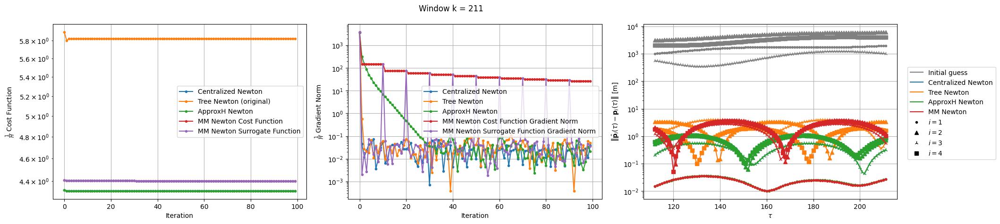


Windows:  38%|███▊      | 113/296 [9:33:13<14:32:39, 286.12s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.813059573968036
Gradient norm: 4149.774125575126
Global relative error: 4.159812295028623
Position relative errors: 0.01629679787949063 m, 3.3963248120864784 m, 1.6251288961621486 m, 1.7685263595590521 m

Before applying the algorithm
Cost function: 4.3286050399443905
Gradient norm: 4116.950966406903
Global relative error: 0.9165832169359106
Position relative errors: 0.01629783018791865 m, 0.5776655963818614 m, 0.23967555114369954 m, 0.6698620336982806 m

Before applying the algorithm
L_norm = 4.328605015713021
Grad_L_norm = 4116.888772232687

Iteration 1
Cost function: 5.532589874266438 (-4.82%)
Gradient norm: 1.7231249406557636 (-99.96%)
Global relative error: 4.058983857904311 (-2.42%)
Position relative errors: 0.009897647844729861 m, 3.3943909539831987 m, 1.53650440885149

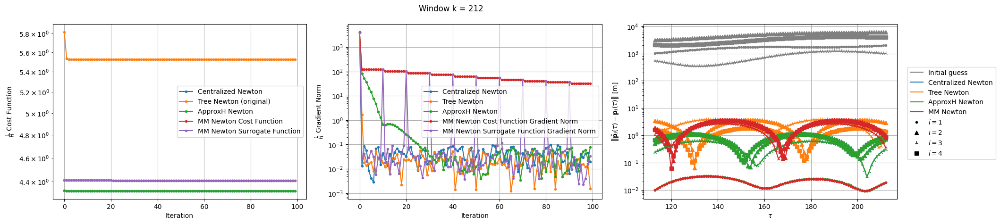


Windows:  39%|███▊      | 114/296 [9:37:58<14:26:49, 285.77s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 5.501334821200313
Gradient norm: 792.8503988585941
Global relative error: 3.9272585765221857
Position relative errors: 0.011126920611610847 m, 3.282640569876413 m, 1.4978508257649097 m, 1.550459983900424 m

Before applying the algorithm
Cost function: 4.326793113295516
Gradient norm: 779.1805323727602
Global relative error: 0.9664411160170081
Position relative errors: 0.011127287782987254 m, 0.5660953564295994 m, 0.2664025075953005 m, 0.7365106578103799 m

Before applying the algorithm
L_norm = 4.326793103387979
Grad_L_norm = 779.0894609143527

Before applying the algorithm
Cost function: 4.403989952583679
Gradient norm: 672.9709867118451
Global relative error: 2.3429712438588814
Position relative errors: 0.011245043557492123 m, 1.6647404960302892 m, 0.8920987754572 m, 1.386417

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 78
L_norm = 4.322933549127773
Grad_L_norm = 0.004398897209191114

Iteration 80
Cost function: 7.629204757732481 (-0.00%)
Gradient norm: 0.023752281582464098 (141.97%)
Global relative error: 5.751657478382064 (-0.00%)
Position relative errors: 0.01993090124494714 m, 3.1799555398577652 m, 4.571512370260468 m, 1.4388404383855715 m

Iteration 79
Cost function: 4.322933547000751 (-0.00%)
Gradient norm: 0.003582490730343234 (-65.75%)
Global relative error: 1.227521197605281 (0.00%)
Position relative errors: 0.019931126704624172 m, 0.7993007487011481 m, 0.3816656326195157 m, 0.8496231892904724 m

Iteration 5
Cost function: 4.392000794980043 (-0.00%)
Gradient norm: 0.02823241558615535 (591.80%)
Global relative error: 1.994210535978522 (0.00%)
Position relative errors: 0.019946737501210766 m, 1.4382928522419114 m, 0.7228680855593379 m, 1.1769534286032302 m
Iteration 79
L_norm = 4.322933543833397
Grad_L_norm = 0.020575460691404368


Iteration 81
Cost function: 7.629204778713335 (0.00%)

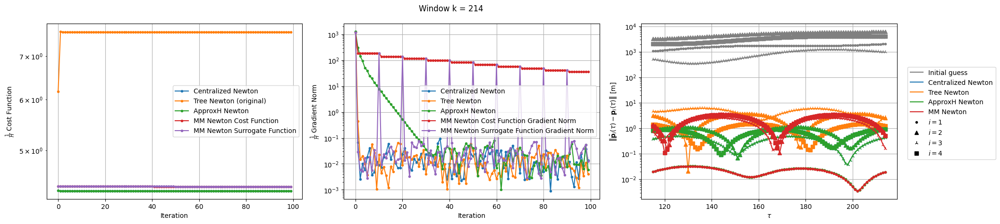


Windows:  39%|███▉      | 116/296 [9:47:58<14:42:31, 294.18s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7.48824161990664
Gradient norm: 983.1400256242802
Global relative error: 5.642095270144609
Position relative errors: 0.021256525483148225 m, 3.0343384728774967 m, 4.544445163723187 m, 1.404825079459992 m

Before applying the algorithm
L_norm = 4.308721538378398
Grad_L_norm = 1086.444711247274

Before applying the algorithm
Cost function: 4.308721534657042
Gradient norm: 1086.4282475134248
Global relative error: 1.2766392732871534
Position relative errors: 0.021256743048320415 m, 0.8460057228591926 m, 0.4004549084727426 m, 0.8679085173648637 m

Iteration 1
Cost function: 5.823972326108519 (-22.23%)
Gradient norm: 1.1594452510711204 (-99.88%)
Global relative error: 4.230860679158086 (-25.01%)
Position relative errors: 0.025666674724613196 m, 3.0352389578314867 m, 2.65916529019529

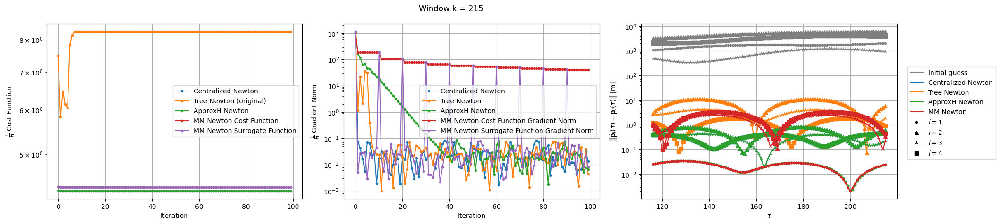


Windows:  40%|███▉      | 117/296 [9:52:44<14:30:39, 291.84s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8.21516872634238
Gradient norm: 230.58003321658134
Global relative error: 4.739455957745695
Position relative errors: 0.026903462673443894 m, 3.7440692334532057 m, 2.6560002957230733 m, 1.1786281861652523 m

Before applying the algorithm
Cost function: 4.291147564997896
Gradient norm: 258.7985250860726
Global relative error: 0.7612484413678763
Position relative errors: 0.026904145330118475 m, 0.5143231522911823 m, 0.3952949960882135 m, 0.3974770898962213 m

Before applying the algorithm
L_norm = 4.2911475702354585
Grad_L_norm = 258.80486536964844

Iteration 1
Cost function: 14.280112522543645 (73.83%)
Gradient norm: 81.10564919975948 (-64.83%)
Global relative error: 4.399518564002206 (-7.17%)
Position relative errors: 0.025227502921696766 m, 3.7470346161342607 m, 2.150613675334

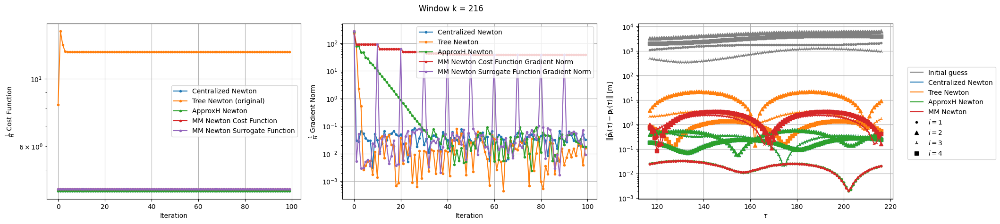


Windows:  40%|███▉      | 118/296 [9:57:31<14:21:34, 290.42s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 12.113754277163268
Gradient norm: 1306.426254997903
Global relative error: 5.633745461957575
Position relative errors: 0.02621352120558727 m, 5.153812590649321 m, 2.14556314500283 m, 0.7567137576704462 m

Before applying the algorithm
Cost function: 4.243737217254013
Gradient norm: 1301.124746277051
Global relative error: 0.75388033591778
Position relative errors: 0.02621406788801411 m, 0.4083377827752851 m, 0.6059037256035942 m, 0.18381685553864055 m

Before applying the algorithm
L_norm = 4.243737224164834
Grad_L_norm = 1301.173199823394

Iteration 1
Cost function: 9.320622977769084 (-23.06%)
Gradient norm: 7.314684550471996 (-99.44%)
Global relative error: 6.6941618208250935 (18.82%)
Position relative errors: 0.012737618924927531 m, 5.157226465880684 m, 4.075978832603645 m, 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Iteration 9
Cost function: 8.117741687150293 (-0.00%)
Gradient norm: 0.008790276922374213 (-67.42%)
Global relative error: 10.855244637208841 (-0.00%)
Position relative errors: 0.02339448271013548 m, 10.778677090151959 m, 1.2635511205479844 m, 0.2428914809593261 m

Iteration 9
Cost function: 4.276188783718178 (-0.00%)
Gradient norm: 19.85217387324303 (-14.24%)
Global relative error: 1.3537719921413358 (0.15%)
Position relative errors: 0.02344026195900546 m, 0.1086244525621307 m, 1.02762218597111 m, 0.8742655224758697 m

Iteration 9
L_norm = 4.276179925423178
Grad_L_norm = 0.042483267738480206

Iteration 4
Cost function: 4.339755150950534 (0.00%)
Gradient norm: 0.029890083761873854 (896.06%)
Global relative error: 2.614475119455416 (-0.00%)
Position relative errors: 0.02417629471162739 m, 1.1459511305660002 m, 1.815284933254332 m, 1.4921177155314713 m

Iteration 10
Cost function: 8.11774208016702 (0.00%)
Gradient norm: 0.04453423527420049 (406.63%)
Global relative error: 10.855244637963

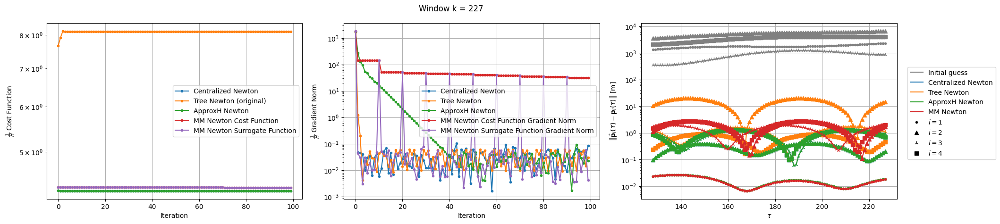


Windows:  44%|████▎     | 129/296 [10:50:11<13:17:43, 286.61s/it]

-------- ApproxH Newton ---------------- Centralized Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.284107748293614
Gradient norm: 1023.1216594633992
Global relative error: 1.2673900722304705
Position relative errors: 0.023978665504798848 m, 0.11724741481014007 m, 0.9650048137662548 m, 0.8128460896019477 m

Before applying the algorithm
Cost function: 8.174481245773475
Gradient norm: 977.8899205306607
Global relative error: 11.935440600993209
Position relative errors: 0.023978354290792953 m, 11.87381896974016 m, 1.1796302626204784 m, 0.2733887974988579 m

Before applying the algorithm
L_norm = 4.284107745629262
Grad_L_norm = 1023.0668735217245

Iteration 1
Cost function: 4.280298888946381 (-0.09%)
Gradient norm: 263.2070021196209 (-74.27%)
Global relative error: 1.41279240304827 (11.47%)
Position relative errors: 0.027953243511206757 m, 0.39668328042489903 m, 0.742052251234

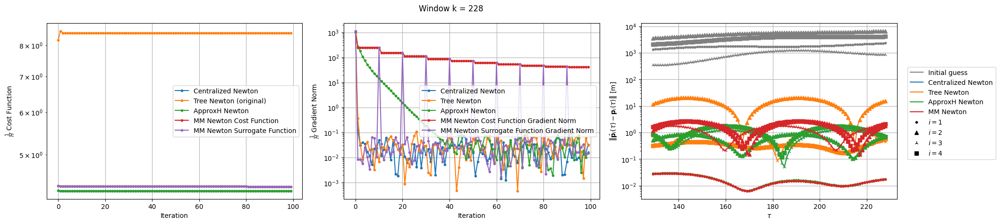


Windows:  44%|████▍     | 130/296 [10:54:56<13:11:15, 286.00s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.3733050103641755
Gradient norm: 2017.6457206629384
Global relative error: 1.1766568063657235
Position relative errors: 0.0285480650178287 m, 0.5642536954384364 m, 0.6877123118457287 m, 0.7696560933903259 m

Before applying the algorithm
Cost function: 8.479682384152763
Gradient norm: 1777.4375858180993
Global relative error: 12.978791509059882
Position relative errors: 0.028547836475979152 m, 12.959350872364919 m, 0.6284760540934605 m, 0.32885067714588884 m

Before applying the algorithm
L_norm = 4.373305023706982
Grad_L_norm = 2017.6905757121601

Iteration 1
Cost function: 13.626470715517426 (60.70%)
Gradient norm: 63.07005017300896 (-96.45%)
Global relative error: 13.033135271129694 (0.42%)
Iteration 1
Cost function: 4.366010264915861 (-0.17%)
Gradient norm: 375.60169781177

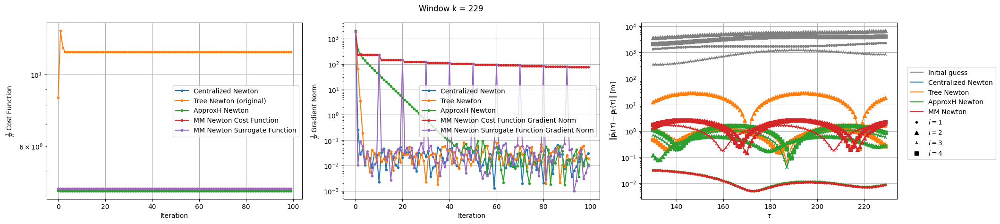


Windows:  44%|████▍     | 131/296 [11:00:13<13:32:23, 295.42s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 11.648342698483193
Gradient norm: 848.6535597256607
Global relative error: 14.650943535744267
Position relative errors: 0.03188252988113459 m, 14.596824740204362 m, 1.1865717683622061 m, 0.41612942586246654 m

Before applying the algorithm
L_norm = 4.3594592043924205
Grad_L_norm = 792.5012475458642

Before applying the algorithm
Cost function: 4.359459203533117
Gradient norm: 792.4808873524479
Global relative error: 1.2025152135647348
Position relative errors: 0.031882431901671456 m, 0.09303104260526252 m, 0.6281070963981881 m, 1.020710336114821 m

Iteration 1
Cost function: 13.314248541902428 (14.30%)
Gradient norm: 4.543732630834784 (-99.46%)
Global relative error: 14.672884330510476 (0.15%)
Position relative errors: 0.041005399507377326 m, 14.598316635438746 m, 1.03243391009

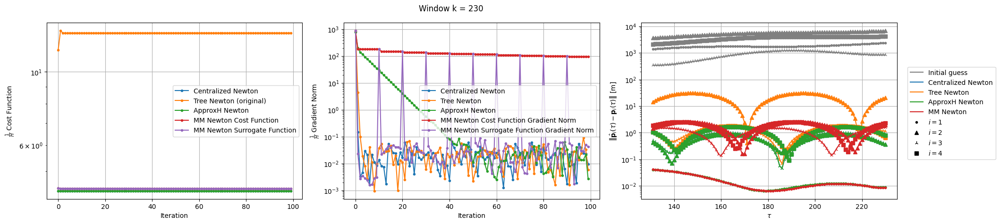


Windows:  45%|████▍     | 132/296 [11:05:01<13:20:41, 292.94s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.374416512702274
Grad_L_norm = 1214.2112031921697

Before applying the algorithm
Cost function: 13.015150494658588
Gradient norm: 1130.2754538311583
Global relative error: 16.430550821322104
Position relative errors: 0.04045075953300325 m, 16.3754070793569 m, 0.9390016133629279 m, 0.9616818485261962 m

Before applying the algorithm
Cost function: 4.374416512743597
Gradient norm: 1214.222748874524
Global relative error: 1.1337519185375198
Position relative errors: 0.040450534162945896 m, 0.38285310702214537 m, 0.44491461449676734 m, 0.9691375718752052 m

Iteration 1
Cost function: 10.842646967790364 (-16.69%)
Gradient norm: 10.09497674082624 (-99.11%)
Global relative error: 16.45392169883867 (0.14%)
Position relative errors: 0.03562570089026633 m, 16.375305733647263 m, 0.846590516859

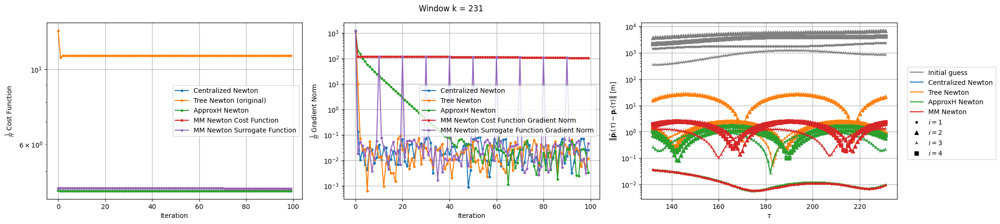


Windows:  45%|████▍     | 133/296 [11:09:48<13:11:26, 291.33s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 10.849370051008561
Gradient norm: 2078.0417696476875
Global relative error: 17.81836536872953
Position relative errors: 0.035080065587606096 m, 17.75909691995797 m, 0.7655659096900955 m, 1.2332014083317517 m

Before applying the algorithm
Cost function: 4.431509978882429
Gradient norm: 2205.514729215968
Global relative error: 1.15988035389028
Position relative errors: 0.03507975435099813 m, 0.6693200802369836 m, 0.21662452177773106 m, 0.921505169029961 m

Before applying the algorithm
L_norm = 4.431509983927686
Grad_L_norm = 2205.5405697042547

Iteration 1
Cost function: 10.538227117607681 (-2.87%)
Gradient norm: 0.8240699863959835 (-99.96%)
Global relative error: 17.85537960720878 (0.21%)
Position relative errors: 0.039506852685409405 m, 17.759238775273165 m, 1.375882592377622

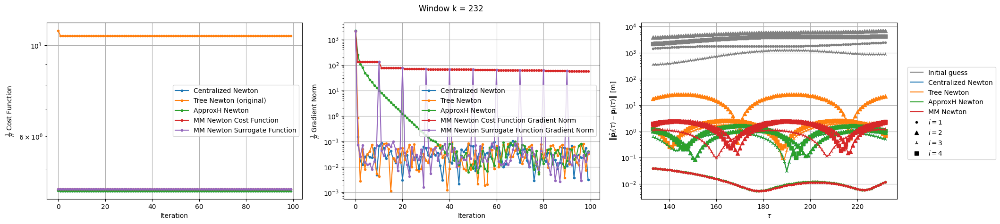


Windows:  45%|████▌     | 134/296 [11:14:32<13:00:36, 289.12s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 10.373159290558515
Gradient norm: 1493.8033599993853
Global relative error: 19.048269924386116
Position relative errors: 0.03878583225107568 m, 18.975032545726286 m, 1.2619113020725796 m, 1.0910579886919427 m

Before applying the algorithm
L_norm = 4.322038107036004
Grad_L_norm = 1467.6609796903917

Before applying the algorithm
Cost function: 4.322038111294482
Gradient norm: 1467.701532464649
Global relative error: 1.6291619527042756
Position relative errors: 0.03878527110293809 m, 0.9768936301995674 m, 0.5636840349563819 m, 1.1749897683804338 m

Iteration 1
Cost function: 9.729167152384429 (-6.21%)
Gradient norm: 0.24359798606400504 (-99.98%)
Global relative error: 19.021640865216636 (-0.14%)
Position relative errors: 0.04452722261697074 m, 18.975056957795626 m, 0.65909760867

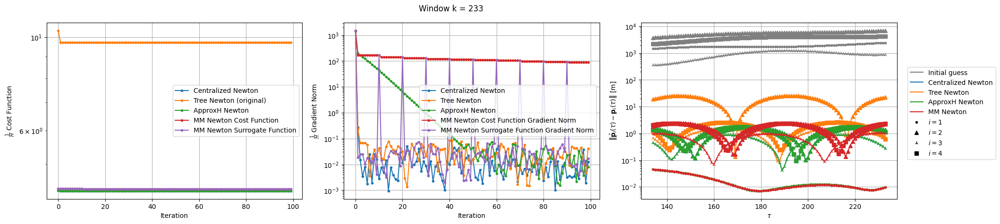


Windows:  46%|████▌     | 135/296 [11:19:15<12:50:28, 287.14s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 9.641318626860597
Gradient norm: 2260.020693688888
Global relative error: 20.110118862877325
Position relative errors: 0.04388200540828376 m, 20.076772984811107 m, 0.5738757158527403 m, 1.0042345462390214 m

Before applying the algorithm
Cost function: 4.336941210822999
Gradient norm: 2196.352950598461
Global relative error: 2.0369991211588614
Position relative errors: 0.04388091931715959 m, 1.515725710389134 m, 0.3941837997497448 m, 1.3017801105037956 m

Before applying the algorithm
L_norm = 4.336941213139195
Grad_L_norm = 2196.372873581846

Iteration 1
Cost function: 8.094335928599442 (-16.05%)
Gradient norm: 27.503513684199735 (-98.78%)
Global relative error: 20.115005123169055 (0.02%)
Position relative errors: 0.04577045160548676 m, 20.076256755964035 m, 0.3358923084164117

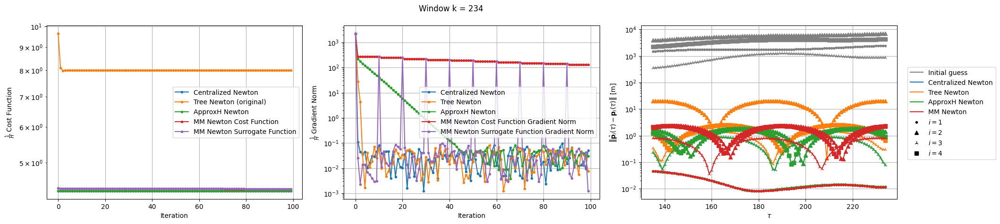


Windows:  46%|████▌     | 136/296 [11:23:59<12:43:19, 286.25s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7.915140413207066
Gradient norm: 342.34462998401835
Global relative error: 20.3085203151215
Position relative errors: 0.04517567275011263 m, 20.27938426996812 m, 0.24922624546590644 m, 1.0575446022524306 m

Before applying the algorithm
Cost function: 4.294133474449985
Gradient norm: 428.00529294717825
Global relative error: 2.0451451239128553
Position relative errors: 0.04517378233869552 m, 1.6726034709153255 m, 0.17882596745723134 m, 1.1623219773224693 m

Before applying the algorithm
L_norm = 4.294133478334793
Grad_L_norm = 427.9812347897065

Iteration 1
Cost function: 8.080623030555516 (2.09%)
Gradient norm: 18.130406927341607 (-94.70%)
Global relative error: 20.289367028025612 (-0.09%)
Position relative errors: 0.04394188930143931 m, 20.279616395975452 m, 0.221507859477620

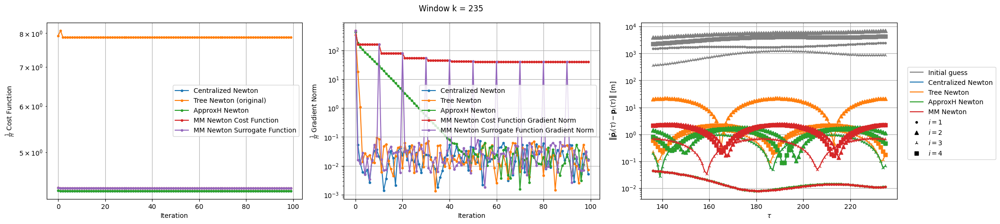


Windows:  46%|████▋     | 137/296 [11:28:42<12:35:48, 285.21s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7.7961660576877145
Gradient norm: 1063.0451887679876
Global relative error: 20.739564616848597
Position relative errors: 0.04322818589313848 m, 20.73382542267092 m, 0.14450997311544977 m, 0.4639155810440912 m

Before applying the algorithm
Cost function: 4.30675875911316
Gradient norm: 1127.1388053838775
Global relative error: 1.540043414016465
Position relative errors: 0.043225665300605544 m, 1.3550602289241396 m, 0.1331782114635542 m, 0.7182863618139139 m

Before applying the algorithm
L_norm = 4.306758762665224
Grad_L_norm = 1127.1586115906844

Iteration 1
Cost function: 8.718204407414138 (11.83%)
Gradient norm: 63.673367357654485 (-94.01%)
Global relative error: 20.740257366548132 (0.00%)
Position relative errors: 0.026740247516098686 m, 20.734289806408025 m, 0.469591807566

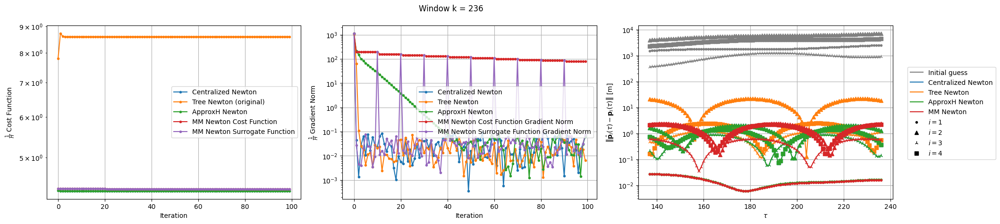


Windows:  47%|████▋     | 138/296 [11:33:24<12:28:45, 284.34s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 8.575931074717186
Gradient norm: 204.6326988360239
Global relative error: 20.2892347253717
Position relative errors: 0.026726498635428315 m, 20.283748468644667 m, 0.4447806252734088 m, 0.15483106226374949 m

Before applying the algorithm
Cost function: 4.308341485413351
Gradient norm: 193.1883154047979
Global relative error: 1.6894196546887732
Position relative errors: 0.02672357818338449 m, 1.544035621347397 m, 0.1607892074667351 m, 0.6659732962739721 m

Before applying the algorithm
L_norm = 4.30834148348383
Grad_L_norm = 193.27421603527137

Iteration 1
Cost function: 7.754745005257899 (-9.58%)
Gradient norm: 8.839003672507818 (-95.68%)
Global relative error: 20.292524784434566 (0.02%)
Position relative errors: 0.02998551309612951 m, 20.283608738334024 m, 0.30927129161180505 

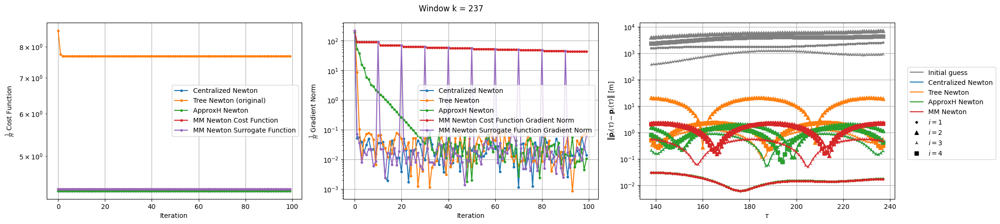


Windows:  47%|████▋     | 139/296 [11:38:12<12:26:49, 285.41s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.347954678721222
Gradient norm: 849.8384812582176
Global relative error: 1.6442305401671284
Position relative errors: 0.02992883116337248 m, 1.4684556205548276 m, 0.16883946431074776 m, 0.719530441099013 m

Before applying the algorithm
Cost function: 7.706441244539695
Gradient norm: 434.0088964888209
Global relative error: 20.104067406959587
Position relative errors: 0.02993179801354262 m, 20.097986707177096 m, 0.29613250218488385 m, 0.39476990445767535 m

Before applying the algorithm
L_norm = 4.3479546849183865
Grad_L_norm = 849.847146323162

Iteration 1
Cost function: 4.344144300385302 (-0.09%)
Gradient norm: 372.52806431995754 (-56.16%)
Global relative error: 1.5570968880498592 (-5.30%)
Position relative errors: 0.029164387172880116 m, 1.4701361193233535 m, 0.171212331015

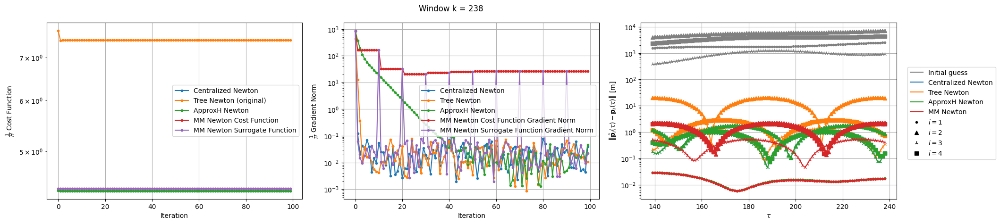


Windows:  47%|████▋     | 140/296 [11:42:57<12:21:32, 285.21s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7.446987795243322
Gradient norm: 1246.355020488888
Global relative error: 20.16433816853694
Position relative errors: 0.028755464660553343 m, 20.137197779399507 m, 0.21809800058019954 m, 1.0224454207380613 m

Before applying the algorithm
L_norm = 4.3225267543013
Grad_L_norm = 1265.061583453067

Before applying the algorithm
Cost function: 4.322526759080738
Gradient norm: 1265.0697333261846
Global relative error: 1.1973899402739756
Position relative errors: 0.028752522606606382 m, 1.1277695091101 m, 0.15558160607873828 m, 0.3699209679143224 m

Iteration 1
Cost function: 7.482876618578123 (0.48%)
Gradient norm: 0.23474550190828541 (-99.98%)
Global relative error: 20.16678422765157 (0.01%)
Position relative errors: 0.03430666580245636 m, 20.137695503212374 m, 0.14231964937645564 

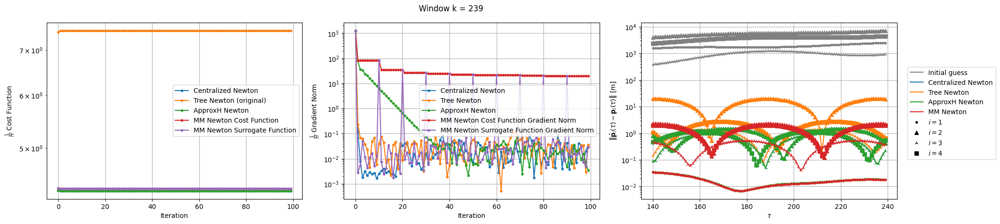


Windows:  48%|████▊     | 141/296 [11:48:18<12:44:39, 296.00s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 7.454461961822833
Gradient norm: 838.6624669648156
Global relative error: 20.186703811937782
Position relative errors: 0.03401607261357279 m, 20.165115594167165 m, 0.19471844498519075 m, 0.9121626141124421 m

Before applying the algorithm
Cost function: 4.309206246300637
Gradient norm: 1050.5562651971334
Global relative error: 0.8962531402987477
Position relative errors: 0.03401390860054798 m, 0.7246197218121331 m, 0.09358010883966005 m, 0.5179544755778972 m

Before applying the algorithm
L_norm = 4.309206249616578
Grad_L_norm = 1050.5848922188172

Iteration 1
Cost function: 8.849144061968797 (18.71%)
Gradient norm: 30.076378667383313 (-96.41%)
Global relative error: 20.19290680481397 (0.03%)
Position relative errors: 0.03564497870171241 m, 20.164413423739816 m, 0.1811344686443

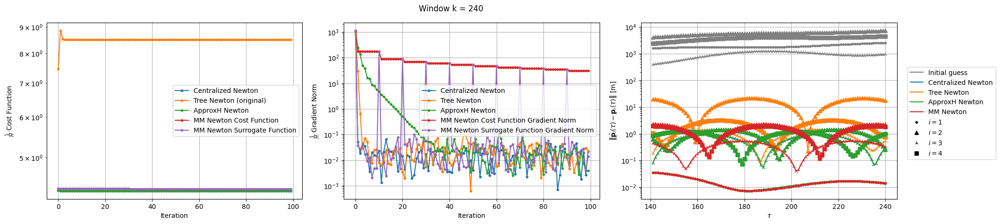


Windows:  48%|████▊     | 142/296 [11:53:08<12:34:56, 294.13s/it]

-------- Centralized Newton ---------------- MM Newton ---------------- Tree Newton ---------------- ApproxH Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.229818302576034
Gradient norm: 1508.5615102910904
Global relative error: 1.0520448796260382
Position relative errors: 0.035106454354309244 m, 0.5398917677159362 m, 0.12706360695594943 m, 0.893271065849683 m

Before applying the algorithm
L_norm = 4.22981830403469
Grad_L_norm = 1508.5430589519256

Before applying the algorithm
Cost function: 8.432391880438844
Gradient norm: 1472.838890436818
Global relative error: 19.641773775877624
Position relative errors: 0.03510861875069049 m, 19.620792574752347 m, 0.26683494914703587 m, 0.8667369179471232 m

Iteration 1
Cost function: 4.224362844832858 (-0.13%)
Gradient norm: 108.5079624145499 (-92.81%)
Global relative error: 1.2022917119643985 (14.28%)
Position relative errors: 0.04717639113721914 m, 0.49406186216512926 m, 0.158295839525

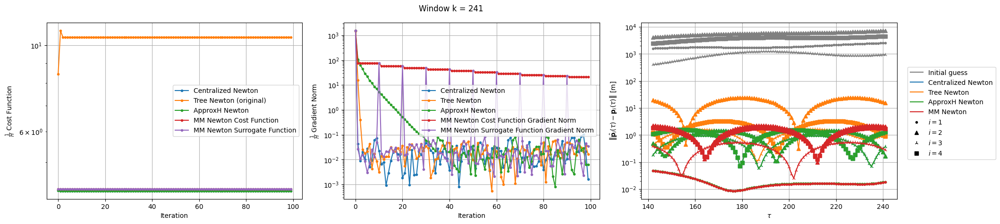


Windows:  48%|████▊     | 143/296 [11:57:53<12:23:16, 291.48s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.2123359107197595
Grad_L_norm = 545.022868779287

Before applying the algorithm
Cost function: 10.506230382594595
Gradient norm: 288.4498410641656
Global relative error: 18.6742765814348
Position relative errors: 0.04695269914901026 m, 18.638764170056277 m, 0.5015515856886512 m, 1.0348968741120044 m

Before applying the algorithm
Cost function: 4.212335911828958
Gradient norm: 545.0264158566024
Global relative error: 1.2405123587142726
Position relative errors: 0.04695112437748978 m, 0.4118769910046965 m, 0.23061105820566974 m, 1.1462273737381459 m

Iteration 1
L_norm = 4.209107359917134
Grad_L_norm = 0.04042840367713919

Iteration 1
Cost function: 12.484183498364906 (18.83%)
Gradient norm: 6.580737367416649 (-97.72%)
Global relative error: 18.7108188538164 (0.20%)
Position relative

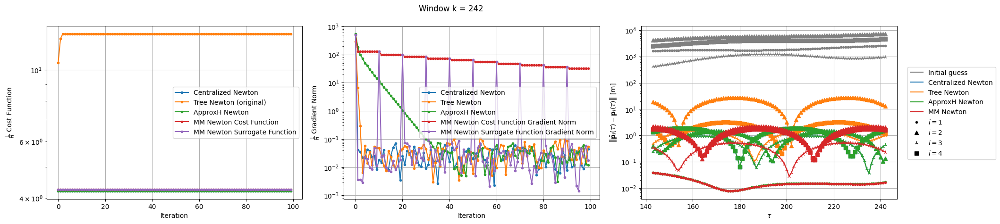


Windows:  49%|████▊     | 144/296 [12:02:43<12:17:07, 290.97s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 12.988865693989743
Gradient norm: 213.31265882461324
Global relative error: 17.322194274459978
Position relative errors: 0.03767928516098056 m, 17.257502071892592 m, 0.5641002876265842 m, 1.3844979262285424 m

Before applying the algorithm
Cost function: 4.221440806942096
Gradient norm: 593.3310925817397
Global relative error: 1.4897594151563347
Position relative errors: 0.037678132907424944 m, 0.31407471363382444 m, 0.2991640470978112 m, 1.4247158591070548 m

Before applying the algorithm
L_norm = 4.221440802894288
Grad_L_norm = 593.3376237931504

Iteration 1
Cost function: 12.961631618170772 (-0.21%)
Gradient norm: 0.09371729114259042 (-99.96%)
Global relative error: 17.281963696663215 (-0.23%)
Position relative errors: 0.03280210133235889 m, 17.257678610788663 m, 0.494207439

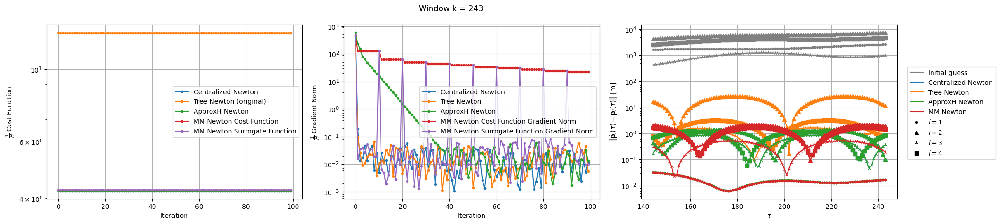


Windows:  49%|████▉     | 145/296 [12:07:25<12:05:58, 288.47s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.223734195819099
Gradient norm: 3982.9649294293763
Global relative error: 0.8419085772788235
Position relative errors: 0.032279733682811874 m, 0.3483830577585902 m, 0.22153810216577813 m, 0.7330168775875896 m

Before applying the algorithm
Cost function: 12.992786446606145
Gradient norm: 3985.2817955605833
Global relative error: 15.852326209223248
Position relative errors: 0.03228110301839821 m, 15.830466979629312 m, 0.5811630712894658 m, 0.5942724006759654 m

Before applying the algorithm
L_norm = 4.223734204196764
Grad_L_norm = 3982.9901378118166

Iteration 1
Cost function: 20.17589846108798 (55.29%)
Gradient norm: 40.21994768183126 (-98.99%)
Global relative error: 15.848313327499266 (-0.03%)
Position relative errors: 0.04413911103025588 m, 15.830746164123058 m, 0.5405717552

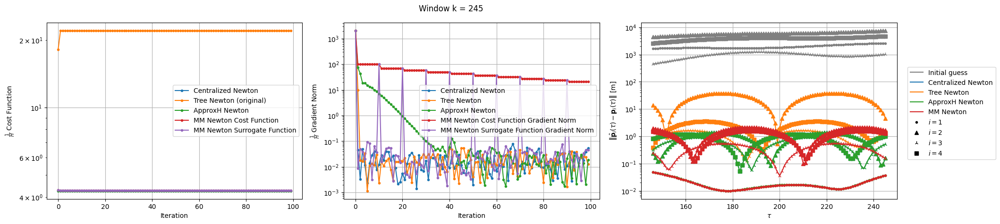


Windows:  50%|████▉     | 147/296 [12:17:00<11:56:34, 288.56s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 22.02840736300272
Gradient norm: 442.84799492179934
Global relative error: 11.525955244234265
Position relative errors: 0.04616186684563809 m, 11.472295315496774 m, 0.9392757321938288 m, 0.59000002606141 m

Before applying the algorithm
L_norm = 4.268603734124885
Grad_L_norm = 364.669139739124

Before applying the algorithm
Cost function: 4.268603734233405
Gradient norm: 364.7123067571977
Global relative error: 0.9612574420306683
Position relative errors: 0.04616006646586785 m, 0.1681573247474207 m, 0.37176521623546943 m, 0.8691345732834013 m

Iteration 1
Cost function: 22.804504619562877 (3.52%)
Gradient norm: 0.5644665659543687 (-99.87%)
Global relative error: 11.568323036179793 (0.37%)
Position relative errors: 0.04296183913737895 m, 11.472363729154255 m, 0.8313183589794957 

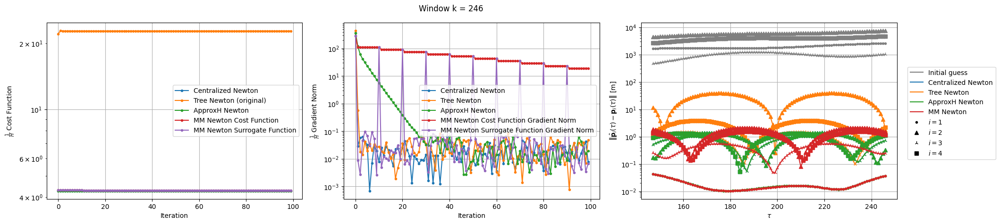


Windows:  50%|█████     | 148/296 [12:22:07<12:05:03, 293.94s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------

-------- MM Newton --------


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.3358854727334855
Gradient norm: 1643.0028346219283
Global relative error: 1.1461047736484773
Position relative errors: 0.041282516330195106 m, 0.1636671290323586 m, 0.5619573040348039 m, 0.9845123299750892 m

Before applying the algorithm
Cost function: 22.7836836404352
Gradient norm: 1627.2724044128083
Global relative error: 9.142618953105554
Position relative errors: 0.04128391918544163 m, 8.97760221795167 m, 0.9095275797550688 m, 1.469496247239013 m

Before applying the algorithm
L_norm = 4.335885467763115
Grad_L_norm = 1642.9747733680538

Iteration 1
Cost function: 4.332617267215486 (-0.08%)
Gradient norm: 102.43422588105182 (-93.77%)
Global relative error: 1.3790856585152378 (20.33%)
Position relative errors: 0.03233239762621884 m, 0.20100695394046916 m, 0.56715101031484

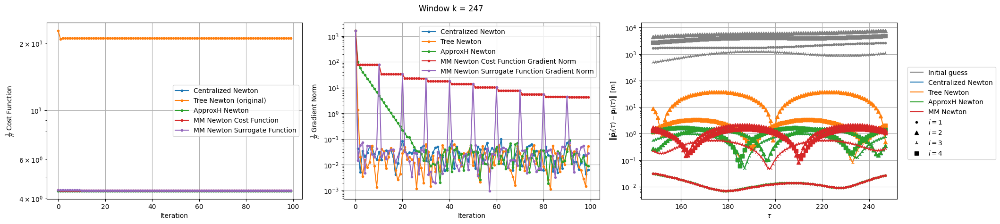


Windows:  50%|█████     | 149/296 [12:27:16<12:11:22, 298.52s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 21.11155836188576
Gradient norm: 1290.332297571057
Global relative error: 6.7770685493213225
Position relative errors: 0.030395030947397164 m, 6.549607475175487 m, 1.0682390122815197 m, 1.3738867850647167 m

Before applying the algorithm
L_norm = 4.353683691887861
Grad_L_norm = 1295.8497479062898

Before applying the algorithm
Cost function: 4.353683683077166
Gradient norm: 1295.850710632525
Global relative error: 1.4160533349118885
Position relative errors: 0.0303930003152284 m, 0.2519162404424031 m, 0.5889686953924149 m, 1.2625101112969892 m

Iteration 1
Cost function: 27.715435830785463 (31.28%)
Gradient norm: 14.918637183001279 (-98.84%)
Global relative error: 6.781621195766214 (0.07%)
Position relative errors: 0.040899077127399326 m, 6.545890220491038 m, 0.9429653689641667

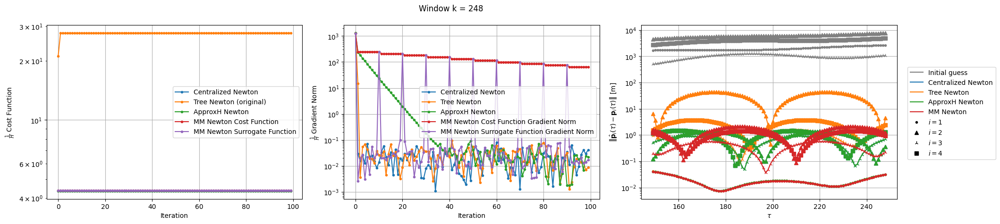


Windows:  51%|█████     | 150/296 [12:32:02<11:57:03, 294.68s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.334075691018127
Gradient norm: 474.02495623304526
Global relative error: 1.3203788628714583
Position relative errors: 0.039588912547123614 m, 0.15545209075579805 m, 0.5575064598719739 m, 1.1861071223645745 m

Before applying the algorithm
Cost function: 27.657841465876665
Gradient norm: 351.64775411075914
Global relative error: 4.202245832264245
Position relative errors: 0.03959059543277802 m, 3.6969283454307464 m, 1.017535076118753 m, 1.718243244852242 m

Before applying the algorithm
L_norm = 4.334075697230194
Grad_L_norm = 474.0576328330888

Iteration 1
Cost function: 4.332051664183101 (-0.05%)
Gradient norm: 198.30587946410557 (-58.17%)
Global relative error: 1.5543945238155723 (17.72%)
Position relative errors: 0.03307023712851207 m, 0.09416239360910596 m, 0.548888180925

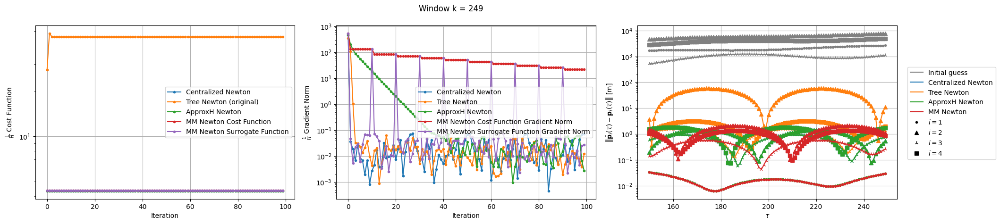


Windows:  51%|█████     | 151/296 [12:36:51<11:48:14, 293.07s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 45.59432066055855
Gradient norm: 1608.6695994912754
Global relative error: 1.7964175950411718
Position relative errors: 0.03231940416545699 m, 0.3617133428165525 m, 1.2058660657774483 m, 1.2794816663903994 m

Before applying the algorithm
L_norm = 4.321150674266983
Grad_L_norm = 1599.8643121410225

Before applying the algorithm
Cost function: 4.3211506641684005
Gradient norm: 1599.7961105088627
Global relative error: 1.7201373890820821
Position relative errors: 0.03231701389725803 m, 0.27874974581208206 m, 0.6240062249079313 m, 1.5782074384367561 m

Iteration 1
Cost function: 45.69958004261325 (0.23%)
Gradient norm: 0.015887231379789517 (-100.00%)
Global relative error: 2.136584424436988 (18.94%)
Position relative errors: 0.04387423827281057 m, 0.4648330169863859 m, 1.476510326

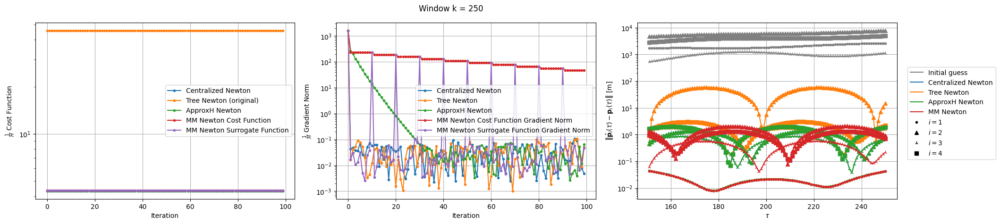


Windows:  51%|█████▏    | 152/296 [12:41:59<11:54:09, 297.57s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 45.728116212247535
Gradient norm: 2038.7511264254067
Global relative error: 4.547942146052155
Position relative errors: 0.042352748684868234 m, 3.9591100058181654 m, 1.5263303727446054 m, 1.6351438728161034 m

Before applying the algorithm
Cost function: 4.360379137333346
Gradient norm: 2086.003351398855
Global relative error: 1.878684820492956
Position relative errors: 0.04235102190236178 m, 0.5365278283336372 m, 0.5913452460781233 m, 1.7000316857081272 m

Before applying the algorithm
L_norm = 4.360379139778227
Grad_L_norm = 2086.066732927641

Iteration 1
Cost function: 65.8387700514682 (43.98%)
Gradient norm: 70.76810916779993 (-96.53%)
Global relative error: 4.376315814557814 (-3.77%)
Position relative errors: 0.03472758773094921 m, 3.9745250644236347 m, 1.579001160094608 m

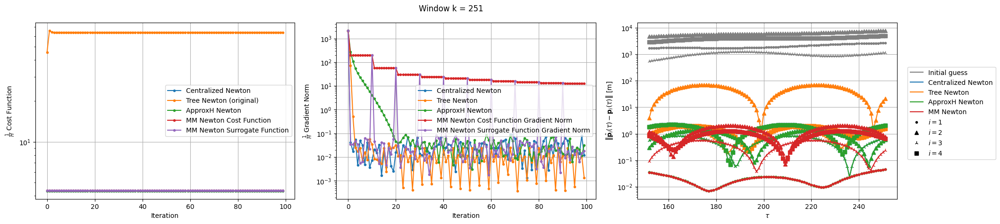


Windows:  52%|█████▏    | 153/296 [12:46:46<11:41:31, 294.35s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 64.06495189905411
Gradient norm: 910.6382474961357
Global relative error: 8.741659139987675
Position relative errors: 0.03364251235589381 m, 8.529532760000853 m, 1.6227133767909976 m, 1.0117102171780037 m

Before applying the algorithm
Cost function: 4.374652717916396
Gradient norm: 986.431527600981
Global relative error: 2.0344929292272615
Position relative errors: 0.03364112190601835 m, 0.3884103534845254 m, 0.5962471171024786 m, 1.9056893823975618 m

Before applying the algorithm
L_norm = 4.374652715526964
Grad_L_norm = 986.4483657844893

Iteration 1
Cost function: 56.847588858200076 (-11.27%)
Gradient norm: 8.14108377071383 (-99.11%)
Global relative error: 8.83455225187576 (1.06%)
Position relative errors: 0.03141018555503003 m, 8.519445112042627 m, 1.7087580435173189 m, 1.

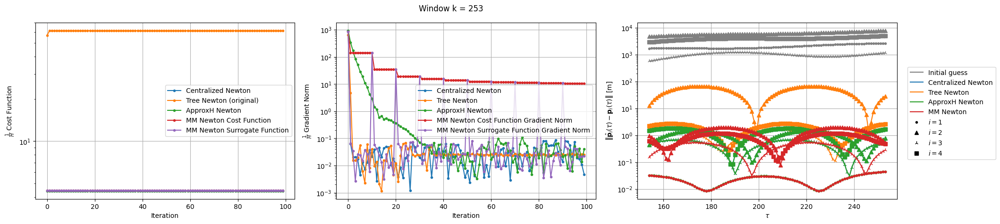


Windows:  52%|█████▏    | 155/296 [12:56:29<11:26:51, 292.28s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 61.48351263427199
Gradient norm: 1586.8211249110284
Global relative error: 17.430193992242316
Position relative errors: 0.03251524239711769 m, 17.158289240732536 m, 1.9622343194846226 m, 2.355429554926178 m

Before applying the algorithm
L_norm = 4.393998720457412
Grad_L_norm = 1675.114540406493

Before applying the algorithm
Cost function: 4.393998717924542
Gradient norm: 1675.0787307221635
Global relative error: 1.7280739666499954
Position relative errors: 0.03250920766849412 m, 0.528185480309249 m, 0.5075016485729895 m, 1.564813265779812 m

Iteration 1
Cost function: 65.95896159125668 (7.28%)
Gradient norm: 3.3908781296752597 (-99.79%)
Global relative error: 17.45176781143003 (0.12%)
Position relative errors: 0.02846576084483634 m, 17.158203890387615 m, 2.0143920409994376 m,

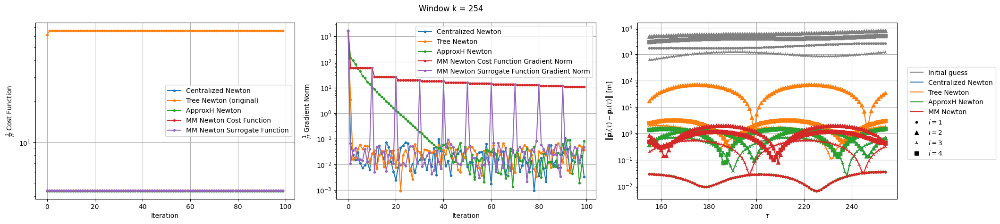


Windows:  53%|█████▎    | 156/296 [13:01:20<11:21:37, 292.13s/it]

-------- Tree Newton ---------------- Centralized Newton ---------------- ApproxH Newton --------

-------- MM Newton --------


Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 65.93836829798552
Gradient norm: 3362.21156176936
Global relative error: 21.908800757079373
Position relative errors: 0.028363034475139968 m, 21.66078667790381 m, 2.019644359170216 m, 2.592407144209701 m

Before applying the algorithm
Cost function: 4.383871028771808
Gradient norm: 3279.0157961831046
Global relative error: 1.5604220188003797
Position relative errors: 0.028356295448984017 m, 0.4459289225682343 m, 0.5418176106280588 m, 1.3934456749188109 m

Before applying the algorithm
L_norm = 4.383871055993802
Grad_L_norm = 3279.0949807839174

Iteration 1
Cost function: 54.37607675546148 (-17.53%)
Gradient norm: 24.08276687650111 (-99.28%)
Global relative error: 21.91633195769361 (0.03%)
Position relative errors: 0.028809688971203427 m, 21.660210289653794 m, 2.063571887870517 

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)




Iteration 18
Cost function: 4.496065930368913 (-0.00%)
Gradient norm: 0.22736636232709234 (-21.30%)
Global relative error: 2.2180139865976964 (0.00%)
Position relative errors: 0.02221665881014232 m, 0.8918759956341613 m, 0.2664574599794398 m, 2.0131187187866675 m

Iteration 18
Cost function: 15.007788495472447 (0.00%)
Gradient norm: 0.0018421776344398593 (-93.71%)
Global relative error: 19.007972216271313 (0.00%)
Position relative errors: 0.02221518770671883 m, 18.657824022382126 m, 0.9373552060661927 m, 3.508326279716661 m

Iteration 18
L_norm = 4.4960659298011905
Grad_L_norm = 0.002488777632733166

Iteration 19
Cost function: 4.496065929435824 (-0.00%)
Gradient norm: 0.17450460541330706 (-23.25%)
Global relative error: 2.21794108258885 (-0.00%)
Position relative errors: 0.022216705911608063 m, 0.8918932159538467 m, 0.2664571729588864 m, 2.013030802249404 m

Iteration 19
L_norm = 4.496065928784003
Grad_L_norm = 0.032141147705557316

Iteration 19
Cost function: 15.007788432937671 (-0.

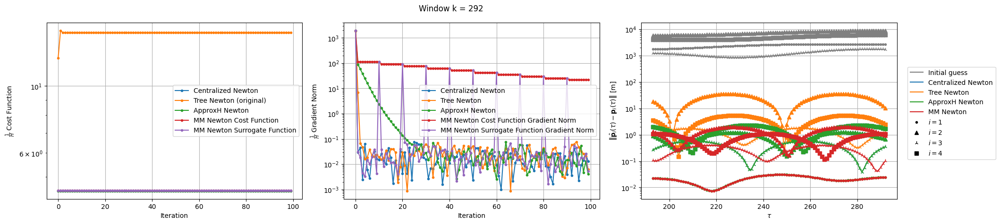


Windows:  66%|██████▌   | 194/296 [16:07:49<8:09:33, 287.98s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 15.010098797665789
Gradient norm: 268.4252958537422
Global relative error: 16.966182418078297
Position relative errors: 0.02212455186591981 m, 16.623090569182345 m, 1.0232060889824242 m, 3.236595023940505 m

Before applying the algorithm
Cost function: 4.521734199735254
Gradient norm: 529.8644855313302
Global relative error: 2.1289882646088456
Position relative errors: 0.02212619719866996 m, 0.8229607594272604 m, 0.2940264909889949 m, 1.9412320675882175 m

Before applying the algorithm
L_norm = 4.52173419939433
Grad_L_norm = 529.862956979508

Iteration 1
Cost function: 18.084783476317178 (20.48%)
Gradient norm: 4.760256282228481 (-98.23%)
Global relative error: 17.02230505094966 (0.33%)
Position relative errors: 0.025571253664224792 m, 16.618639781408174 m, 0.9936881664272164 m

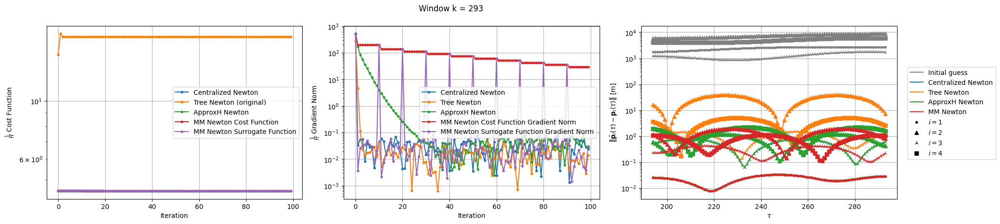


Windows:  66%|██████▌   | 195/296 [16:12:35<8:03:25, 287.19s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.563642467966857
Grad_L_norm = 3618.002163916788

Before applying the algorithm
Cost function: 17.626220048809724
Gradient norm: 3501.40644649459
Global relative error: 14.69302339635241
Position relative errors: 0.025396047756356777 m, 14.27803728704231 m, 1.0472672087590005 m, 3.305085333758538 m

Before applying the algorithm
Cost function: 4.56364245432215
Gradient norm: 3617.9502285289545
Global relative error: 1.9903809074420307
Position relative errors: 0.02539841964881977 m, 0.526074854567038 m, 0.5501514361932073 m, 1.8388980318203252 m

Iteration 1
L_norm = 4.559180048349032
Grad_L_norm = 0.06492621319283377

Iteration 1
Cost function: 25.932666273310943 (47.13%)
Gradient norm: 29.08071596662683 (-99.17%)
Global relative error: 14.654400879328328 (-0.26%)
Position relative

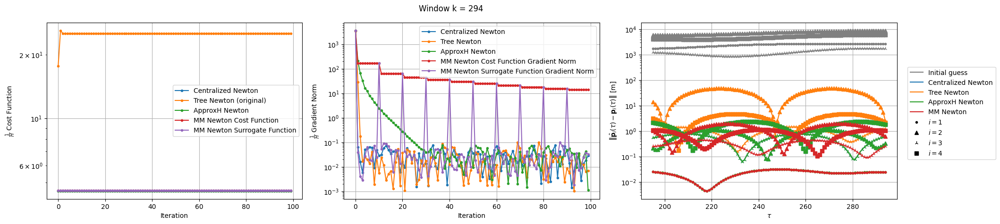


Windows:  66%|██████▌   | 196/296 [16:17:18<7:56:52, 286.13s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.554932589482139
Gradient norm: 2021.4505798510609
Global relative error: 2.1173476296850304
Position relative errors: 0.024475173399198736 m, 0.18707415176811987 m, 0.5640242010100164 m, 2.03210196261115 m

Before applying the algorithm
L_norm = 4.554932593240451
Grad_L_norm = 2021.4786164571588

Before applying the algorithm
Cost function: 25.071827219147334
Gradient norm: 2077.3476685917826
Global relative error: 11.66242913328609
Position relative errors: 0.024472257294704747 m, 11.245529022962865 m, 1.17178677695222 m, 2.859025078831305 m

Iteration 1
Cost function: 4.553577322508425 (-0.03%)
Gradient norm: 34.40647774871496 (-98.30%)
Global relative error: 2.0594836859915064 (-2.73%)
Position relative errors: 0.021530970777326148 m, 0.1809881623226501 m, 0.49938687873162

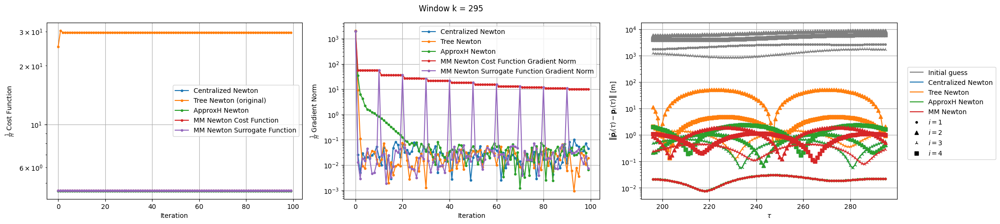


Windows:  67%|██████▋   | 197/296 [16:22:01<7:50:39, 285.25s/it]

-------- ApproxH Newton ---------------- Centralized Newton ---------------- Tree Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 29.711375208654815
Gradient norm: 1867.0761541911515
Global relative error: 8.10160729552579
Position relative errors: 0.021415276816974648 m, 7.812457771937491 m, 1.1678964158684844 m, 1.798266514405799 m

Before applying the algorithm
Cost function: 4.536456588804324
Gradient norm: 1891.6763265164484
Global relative error: 2.00375734679436
Position relative errors: 0.02141889547605168 m, 0.23364943661973173 m, 0.5038797653140905 m, 1.925121743682038 m

Before applying the algorithm
L_norm = 4.536456594788418
Grad_L_norm = 1891.7156751831617

Iteration 1
Cost function: 29.70898108710854 (-0.01%)
Gradient norm: 0.5601756379853008 (-99.97%)
Global relative error: 8.576434079716893 (5.86%)
Position relative errors: 0.01918489469867534 m, 7.81416455737955 m, 1.162823547356813 m, 3

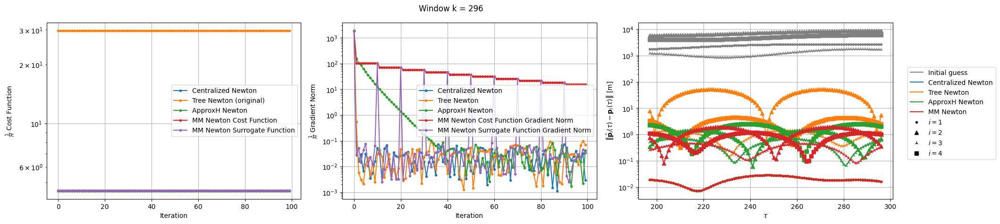


Windows:  67%|██████▋   | 198/296 [16:26:53<7:49:15, 287.30s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 29.763909944815587
Gradient norm: 3573.0795981258393
Global relative error: 5.526750686556457
Position relative errors: 0.0189583123825684 m, 4.385376164680558 m, 1.2007304018149527 m, 3.141339284566499 m

Before applying the algorithm
L_norm = 4.57705475124248
Grad_L_norm = 3503.6268784817707

Before applying the algorithm
Cost function: 4.577054764139601
Gradient norm: 3503.6661984020393
Global relative error: 2.3783257091323815
Position relative errors: 0.018961522819326317 m, 0.44223497141740864 m, 0.5396784689639146 m, 2.273597370084224 m

Iteration 1
Cost function: 24.22700406104658 (-18.60%)
Gradient norm: 8.03053462443012 (-99.78%)
Global relative error: 6.1801713003690635 (11.82%)
Position relative errors: 0.018682107509464512 m, 4.407690345542545 m, 1.7801694886494661

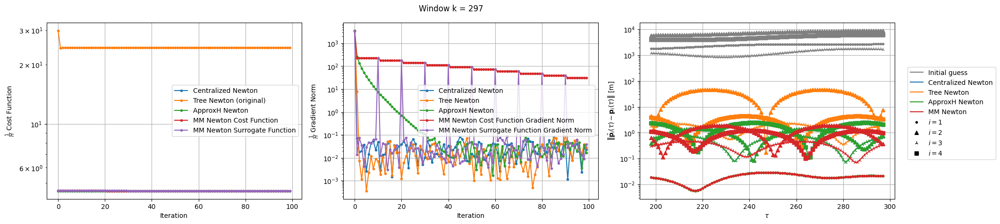


Windows:  67%|██████▋   | 199/296 [16:31:38<7:42:52, 286.31s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton --------

-------- MM Newton --------


Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.555384933377031
Grad_L_norm = 897.9834273098592

Before applying the algorithm
Cost function: 4.555384929655798
Gradient norm: 897.975804008312
Global relative error: 2.459637471475945
Position relative errors: 0.018202553358131684 m, 0.47489840775170983 m, 0.6379325132735563 m, 2.327443975799584 m

Before applying the algorithm
Cost function: 24.42224369224266
Gradient norm: 815.8856602506385
Global relative error: 4.4621430473176815
Position relative errors: 0.018200857474047236 m, 1.4077233439546555 m, 1.8608011634904347 m, 3.8030819047013718 m

Iteration 1
L_norm = 4.552501189029711
Grad_L_norm = 0.03787841089398615

Iteration 1
Cost function: 30.390393568168587 (24.44%)
Gradient norm: 13.735176492914375 (-98.32%)
Global relative error: 3.8937025944746777 (-12.74%)
Position rel

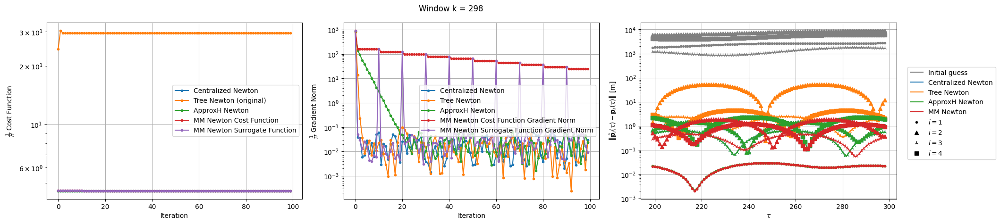


Windows:  68%|██████▊   | 200/296 [16:36:36<7:44:08, 290.08s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 29.576911766795273
Gradient norm: 2547.86805889211
Global relative error: 4.21439422693703
Position relative errors: 0.02088432249205452 m, 2.3759101573382466 m, 2.075794452589461 m, 2.793445001002968 m

Before applying the algorithm
Cost function: 4.493151370879844
Gradient norm: 2555.9957255600075
Global relative error: 2.32380503397256
Position relative errors: 0.020886085251058607 m, 0.754673473030556 m, 0.5261584611406337 m, 2.1338359131972986 m

Before applying the algorithm
L_norm = 4.4931513725640215
Grad_L_norm = 2556.0025968937343

Iteration 1
Cost function: 31.378839244580504 (6.09%)
Gradient norm: 1.5628071628487936 (-99.94%)
Global relative error: 3.98283664668932 (-5.49%)
Position relative errors: 0.023560591278800815 m, 2.3466466852934085 m, 2.282362301766697 m, 

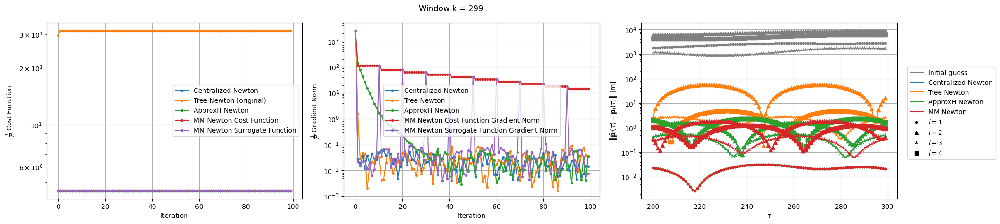


Windows:  68%|██████▊   | 201/296 [16:42:00<7:55:20, 300.22s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.470357613650795
Gradient norm: 1302.8478652389547
Global relative error: 2.2965457088714127
Position relative errors: 0.022774833541117742 m, 1.0805455280000795 m, 0.4535951084985563 m, 1.9749107981866543 m

Before applying the algorithm
Cost function: 31.47632062605068
Gradient norm: 1242.8089810299418
Global relative error: 6.735178344125118
Position relative errors: 0.022772187336478882 m, 5.982780971013112 m, 2.369707027094831 m, 1.9872494865791517 m

Before applying the algorithm
L_norm = 4.470357618640911
Grad_L_norm = 1302.89462468044

Iteration 1
Cost function: 4.465454563638573 (-0.11%)
Gradient norm: 261.61608479258786 (-79.92%)
Global relative error: 2.1638100162537808 (-5.78%)
Position relative errors: 0.01970315926707644 m, 1.2632077950245233 m, 0.5931933236677 m

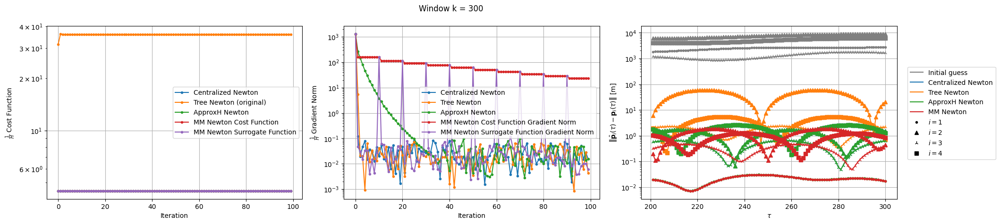


Windows:  68%|██████▊   | 202/296 [16:46:46<7:43:30, 295.86s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.453236644675121
Grad_L_norm = 829.3812272002333

Before applying the algorithm
Cost function: 35.98055414536438
Gradient norm: 833.3192530040238
Global relative error: 10.252786808957135
Position relative errors: 0.01928548681813991 m, 9.90948305723685 m, 2.0789464336930172 m, 1.6109286510219927 m

Before applying the algorithm
Cost function: 4.4532366485974135
Gradient norm: 829.4096659471745
Global relative error: 2.215781785160605
Position relative errors: 0.01928831922150641 m, 1.3363367323339481 m, 0.5851116576895924 m, 1.6676808308004067 m

Iteration 1
L_norm = 4.4501841854052735
Grad_L_norm = 0.02606903312038584

Iteration 1
Cost function: 28.57719179783768 (-20.58%)
Gradient norm: 17.34928616804219 (-97.92%)
Global relative error: 10.187705648177417 (-0.63%)
Position relati

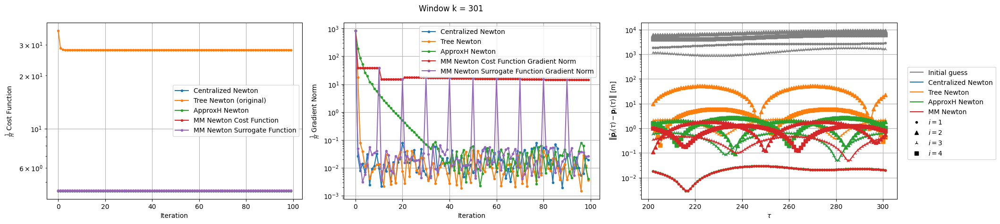


Windows:  69%|██████▊   | 203/296 [16:51:31<7:33:31, 292.60s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.47819719636882
Gradient norm: 1189.263570169307
Global relative error: 2.2611339583977883
Position relative errors: 0.01703604617072102 m, 1.5985748267885695 m, 0.6029423626932217 m, 1.481029473630143 m

Before applying the algorithm
Cost function: 28.174164324824893
Gradient norm: 1149.6152879700924
Global relative error: 13.399915446401279
Position relative errors: 0.017033318833299994 m, 13.208012141922662 m, 2.1082610186421924 m, 0.8112136281539293 m

Before applying the algorithm
L_norm = 4.47819720165015
Grad_L_norm = 1189.285203758445

Iteration 1
Cost function: 4.472483628173452 (-0.13%)
Gradient norm: 154.71635258781538 (-86.99%)
Global relative error: 2.1601740611136635 (-4.47%)Iteration 1
Cost function: 53.80125047405044 (90.96%)
Gradient norm: 165.96316323875539 (

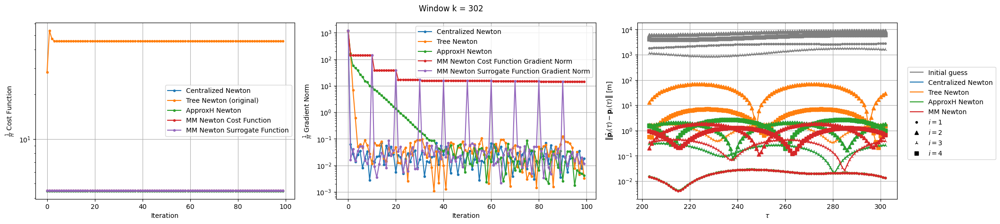


Windows:  69%|██████▉   | 204/296 [16:56:19<7:26:41, 291.32s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 45.92722265502987
Gradient norm: 2427.621430744977
Global relative error: 17.79202905146023
Position relative errors: 0.014285224677131923 m, 17.697848398928468 m, 1.745286322138809 m, 0.5391263151677215 m

Before applying the algorithm
Cost function: 4.469382930560989
Gradient norm: 2451.551007001845
Global relative error: 2.1873752878718378
Position relative errors: 0.01428956816669171 m, 1.6045784503393672 m, 0.3022471801395763 m, 1.45546299975808 m

Before applying the algorithm
L_norm = 4.469382932878928
Grad_L_norm = 2451.565602848158

Iteration 1
Cost function: 42.67249368397132 (-7.09%)
Gradient norm: 1.6272920489450664 (-99.93%)
Global relative error: 17.869169851034414 (0.43%)
Position relative errors: 0.014446284710989134 m, 17.695256662695076 m, 2.2903804719392302 m

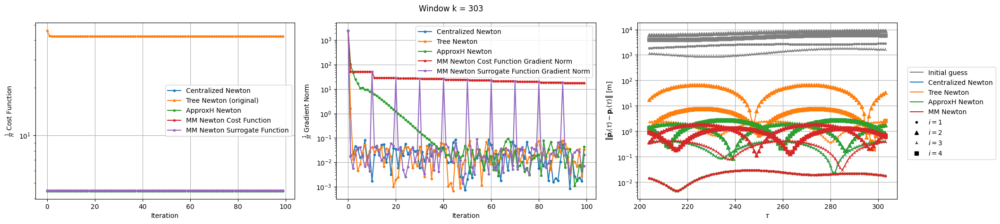


Windows:  69%|██████▉   | 205/296 [17:01:05<7:19:08, 289.54s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.48370126227467
Grad_L_norm = 947.2168000169198
Before applying the algorithm
Cost function: 42.53537233861877
Gradient norm: 582.361991338213
Global relative error: 22.087624870469092

Position relative errors: 0.013509413917569492 m, 21.92216189472784 m, 2.327511107426163 m, 1.3636611166406192 m

Before applying the algorithm
Cost function: 4.483701271030156
Gradient norm: 947.260464116408
Global relative error: 2.0189396765896914
Position relative errors: 0.013515305439866595 m, 1.5809324143720351 m, 0.3866622159853788 m, 1.1946006219327052 m

Iteration 1
Cost function: 56.61166236094092 (33.09%)
Gradient norm: 44.10612343866405 (-92.43%)
Global relative error: 22.08412935648118 (-0.02%)
Position relative errors: 0.01102437186634693 m, 21.92335487107323 m, 2.0133010520236323 m, 1

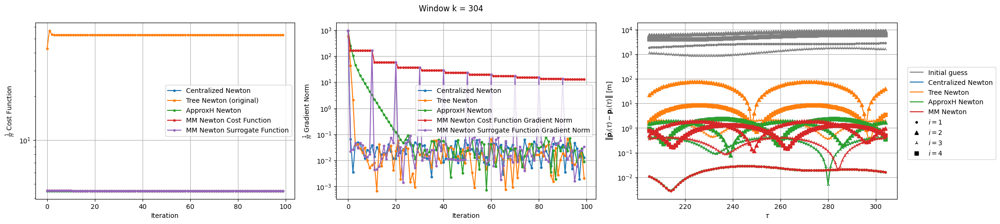


Windows:  70%|██████▉   | 206/296 [17:05:49<7:11:58, 287.99s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 53.16525157779532
Gradient norm: 2810.503121703444
Global relative error: 26.89234944781207
Position relative errors: 0.00997685037284299 m, 26.723345481951462 m, 2.0342928920916488 m, 2.217313264648052 m

Before applying the algorithm
Cost function: 4.503261826038219
Gradient norm: 2753.933687182243
Global relative error: 1.8180576151861774
Position relative errors: 0.00998276222717875 m, 1.5737771955802462 m, 0.411376575403591 m, 0.8119244099413596 m

Before applying the algorithm
L_norm = 4.503261818317411
Grad_L_norm = 2753.928282615479

Iteration 1
Cost function: 60.10811074032654 (13.06%)
Gradient norm: 9.247392960043895 (-99.67%)
Global relative error: 26.88717756632291 (-0.02%)
Position relative errors: 0.008310272807318058 m, 26.72317259881439 m, 1.9976090170098375 m, 

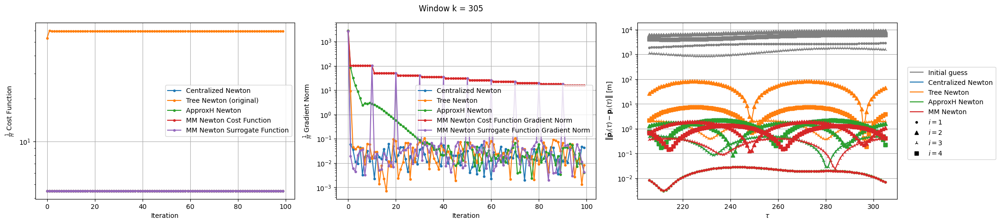


Windows:  70%|██████▉   | 207/296 [17:10:32<7:04:50, 286.41s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.491944672862204
Grad_L_norm = 253.60558283099792

Before applying the algorithm
Cost function: 59.9503259253284
Gradient norm: 279.44607119982413
Global relative error: 31.957438026132305
Position relative errors: 0.007219907166083345 m, 31.78494040194225 m, 2.0089294298643074 m, 2.6367717708334464 m

Before applying the algorithm
Cost function: 4.491944675185713
Gradient norm: 253.63641844642453
Global relative error: 1.6070346598394811
Position relative errors: 0.007227173750636682 m, 1.397258488816401 m, 0.4841578192170842 m, 0.6290956341403481 m

Iteration 1
L_norm = 4.490524728561144
Grad_L_norm = 0.05549713732451404

Iteration 1
Cost function: 64.14479222025558 (7.00%)
Gradient norm: 3.274341967669973 (-98.83%)
Global relative error: 31.9335571047005 (-0.07%)
Position relativ

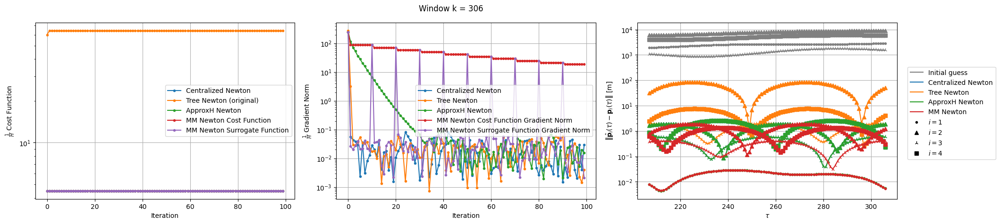


Windows:  70%|███████   | 208/296 [17:15:18<7:00:09, 286.47s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 64.13449574129353
Gradient norm: 2604.191278781286
Global relative error: 37.09859794931801
Position relative errors: 0.0069283454841719515 m, 36.93828880047347 m, 1.925245042510951 m, 2.8556879264403916 m

Before applying the algorithm
Cost function: 4.495862668560061
Gradient norm: 2680.2834058035796
Global relative error: 1.9846156354509696
Position relative errors: 0.006935492108845976 m, 1.7503791842040446 m, 0.5824744597132745 m, 0.7318054263563645 m

Before applying the algorithm
L_norm = 4.495862681591529
Grad_L_norm = 2680.329479889522

Iteration 1
Cost function: 62.251262884356755 (-2.94%)
Gradient norm: 1.1513833858910083 (-99.96%)
Global relative error: 37.07291769284514 (-0.07%)
Position relative errors: 0.01228139428589079 m, 36.93839697314344 m, 1.753052932463593

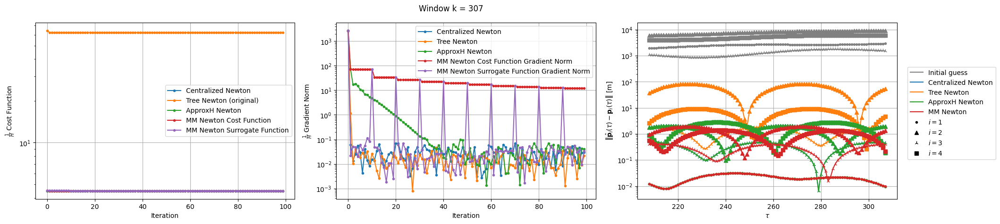


Windows:  71%|███████   | 209/296 [17:20:09<6:57:11, 287.72s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 62.64867773211606
Gradient norm: 2798.438999021665
Global relative error: 41.958131651297386
Position relative errors: 0.011342853920208975 m, 41.802693046555014 m, 1.746801162811128 m, 3.156230551459288 m

Before applying the algorithm
Cost function: 4.560876196648379
Gradient norm: 2989.578603959554
Global relative error: 2.021337175891059
Position relative errors: 0.01134859711837323 m, 1.8191085582664892 m, 0.48621277867098317 m, 0.7349192724343178 m

Before applying the algorithm
L_norm = 4.560876193617935
Grad_L_norm = 2989.5682791306285

Iteration 1
Cost function: 69.2606009238251 (10.55%)
Gradient norm: 16.989926251839982 (-99.39%)
Global relative error: 42.02912545745739 (0.17%)
Position relative errors: 0.00520125446581658 m, 41.802747295995125 m, 2.520551886962849 m,

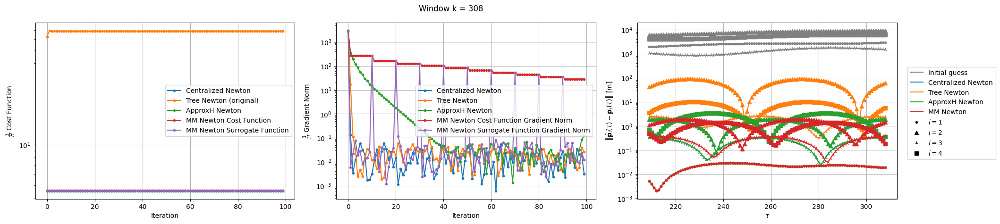


Windows:  71%|███████   | 210/296 [17:24:52<6:50:16, 286.24s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 68.31330746728871
Gradient norm: 321.6959778185512
Global relative error: 47.236878949228014
Position relative errors: 0.003927162140168614 m, 46.988854526746735 m, 2.5144264835111745 m, 4.1280302071211175 m

Before applying the algorithm
Cost function: 4.585748085643148
Gradient norm: 817.4366703910271
Global relative error: 2.0148325902686275
Position relative errors: 0.003937365097737207 m, 1.9115520755693691 m, 0.3315139925123997 m, 0.5436798812719449 m

Before applying the algorithm
L_norm = 4.585748070571415
Grad_L_norm = 817.3748066609971

Iteration 1
Cost function: 73.73130920367686 (7.93%)
Gradient norm: 4.747318893335692 (-98.52%)
Global relative error: 47.20338999949583 (-0.07%)
Position relative errors: 0.0042839912683820406 m, 46.9887146860814 m, 1.7723546268135388

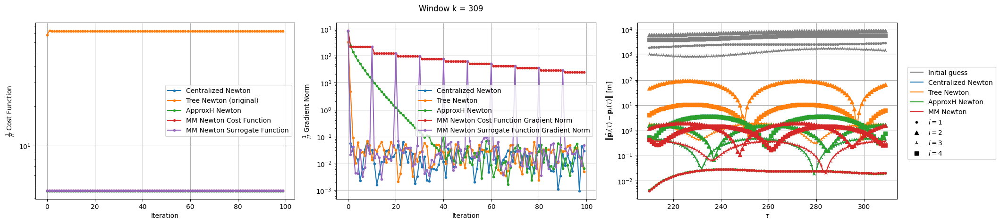


Windows:  71%|███████▏  | 211/296 [17:29:41<6:46:54, 287.23s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------


-------- MM Newton --------

Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.579521567499231
Grad_L_norm = 2569.120322375355

Before applying the algorithm
Cost function: 73.09347240227905
Gradient norm: 2687.4607084704685
Global relative error: 52.466675600675835
Position relative errors: 0.004872996539490805 m, 52.22272439645129 m, 1.7531672913533092 m, 4.738995472648429 m

Before applying the algorithm
Cost function: 4.579521559566739
Gradient norm: 2569.0965644480243
Global relative error: 1.7287991720853142
Position relative errors: 0.0048672869910438695 m, 1.598115649107669 m, 0.4686565433040924 m, 0.46378279785483484 m

Iteration 1
L_norm = 4.576065048234034
Grad_L_norm = 0.052225356900688885

Iteration 1
Cost function: 81.12044689246518 (10.98%)
Gradient norm: 10.43122779150929 (-99.61%)
Global relative error: 52.41052354138975 (-0.11%)
Position rel

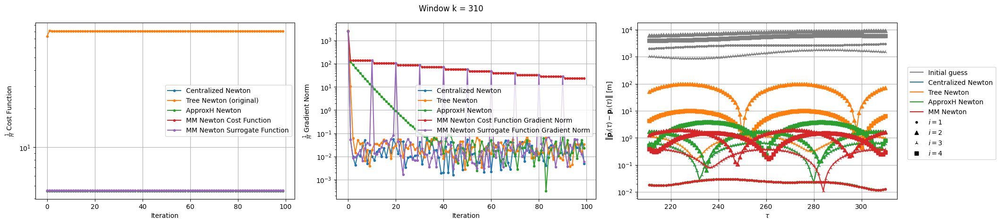


Windows:  72%|███████▏  | 212/296 [17:34:34<6:44:26, 288.89s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.5577957714943045
Grad_L_norm = 712.30675237749

Before applying the algorithm
Cost function: 4.557795768661303
Gradient norm: 712.2855150057972
Global relative error: 1.8768908715796135
Position relative errors: 0.017997795439423946 m, 1.7061979071081677 m, 0.6362936330189185 m, 0.45430954390413525 m

Before applying the algorithm
Cost function: 80.52801615582229
Gradient norm: 737.0749245795959
Global relative error: 57.840366021618934
Position relative errors: 0.017999375744701767 m, 57.62647842925544 m, 1.1149950229505352 m, 4.842059858914871 m

Iteration 1
L_norm = 4.552259277950369
Grad_L_norm = 0.11794688837771176

Iteration 1
Cost function: 4.5528018527666765 (-0.11%)
Gradient norm: 106.94345853765081 (-84.99%)
Global relative error: 1.9010850623938047 (1.29%)
Position relat

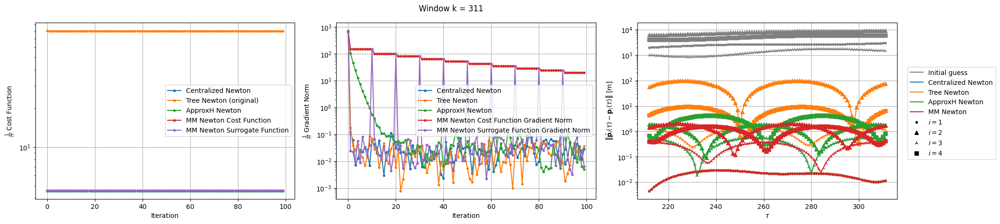


Windows:  72%|███████▏  | 213/296 [17:39:23<6:39:50, 289.04s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 79.76428736007759
Gradient norm: 675.2805788182295
Global relative error: 62.95205906609329
Position relative errors: 0.005424330644672099 m, 62.74461648843917 m, 1.2730431144904966 m, 4.944410485652237 m

Before applying the algorithm
L_norm = 4.574153691459913
Grad_L_norm = 657.3936249038142

Before applying the algorithm
Cost function: 4.574153687039517
Gradient norm: 657.3769931765405
Global relative error: 1.9896446707474147
Position relative errors: 0.005417387438969227 m, 1.842471370745895 m, 0.5323428048308698 m, 0.5296655593968987 m

Iteration 1
Cost function: 88.33054872581695 (10.74%)
Gradient norm: 17.006084761913524 (-97.48%)
Global relative error: 62.92675427080652 (-0.04%)
Position relative errors: 0.023577338506344237 m, 62.74451922117909 m, 1.0211970530534764 m

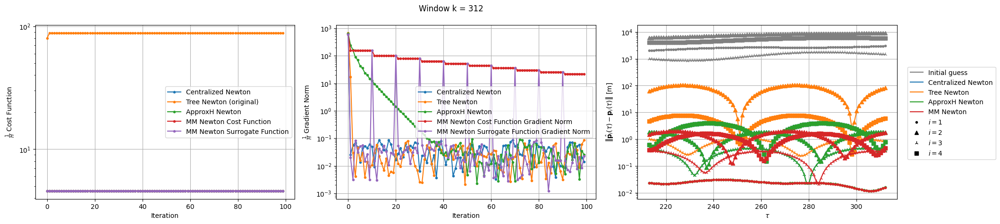


Windows:  72%|███████▏  | 214/296 [17:44:10<6:34:07, 288.38s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.5469926190696786
Grad_L_norm = 710.5122107626383

Before applying the algorithm
Cost function: 87.95099261761173
Gradient norm: 474.1279626844221
Global relative error: 68.31178958795007
Position relative errors: 0.023061333426838894 m, 68.11649529228018 m, 0.9802760463141423 m, 5.067006883650544 m
Before applying the algorithm
Cost function: 4.546992621450841
Gradient norm: 710.5065876102602
Global relative error: 1.9641998042515105

Position relative errors: 0.023058372637099065 m, 1.84672577300215 m, 0.42382251515037744 m, 0.5172120025846645 m

Iteration 1
L_norm = 4.544381347584904
Grad_L_norm = 0.05065129305099626

Iteration 1
Cost function: 89.05258320831223 (1.25%)
Gradient norm: 2.1418560297584657 (-99.55%)
Global relative error: 68.29870374626329 (-0.02%)
Position relative

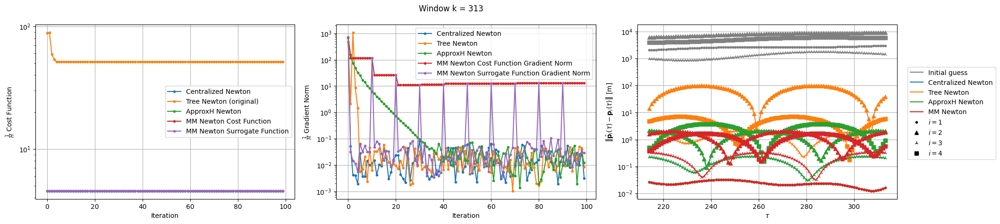


Windows:  73%|███████▎  | 215/296 [17:48:55<6:27:58, 287.39s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton --------
-------- MM Newton --------



Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.526796518204137
Grad_L_norm = 377.9890292965367

Before applying the algorithm
Cost function: 51.37786872549668
Gradient norm: 318.15456799522735
Global relative error: 21.397181912704273
Position relative errors: 0.025218135792360222 m, 20.73531840951854 m, 1.7079279765496227 m, 4.995688767304572 m

Before applying the algorithm
Cost function: 4.526796519078565
Gradient norm: 377.9958576223129
Global relative error: 2.1551915404563067
Position relative errors: 0.025219261025967162 m, 2.0877236920252975 m, 0.2192417973346149 m, 0.48738044937295943 m

Iteration 1
Cost function: 52.53907960023136 (2.26%)
Gradient norm: 0.13313746924162626 (-99.96%)
Global relative error: 21.343894918232344 (-0.25%)
Position relative errors: 0.03388064088409666 m, 20.73275008676771 m, 1.10917875541545

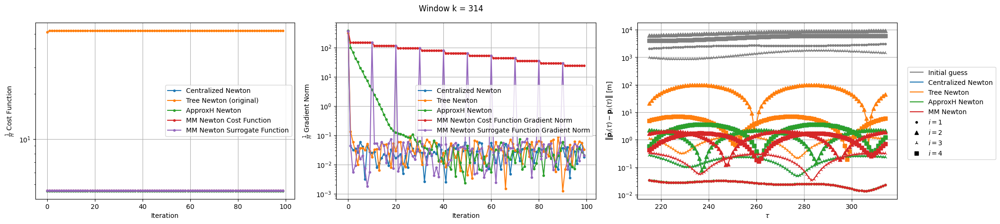


Windows:  73%|███████▎  | 216/296 [17:53:46<6:24:22, 288.28s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.537602497722819
Gradient norm: 835.6292624276296
Global relative error: 2.3300358655006725
Position relative errors: 0.032917410835357284 m, 2.203456036456266 m, 0.2614962321649686 m, 0.7101893541498829 m

Before applying the algorithm
Cost function: 52.46089962380509
Gradient norm: 725.4548595224508
Global relative error: 27.65340229771883
Position relative errors: 0.03291608056177792 m, 27.128229413274447 m, 1.053336096618399 m, 5.258139439079509 m

Before applying the algorithm
L_norm = 4.537602505252906
Grad_L_norm = 835.6020035125707

Iteration 1
Cost function: 58.08430591541505 (10.72%)
Gradient norm: 7.795163733020673 (-98.93%)
Global relative error: 27.834167791442805 (0.65%)
Position relative errors: 0.030591851727821043 m, 27.126694150017947 m, 0.8462116110654132 m,

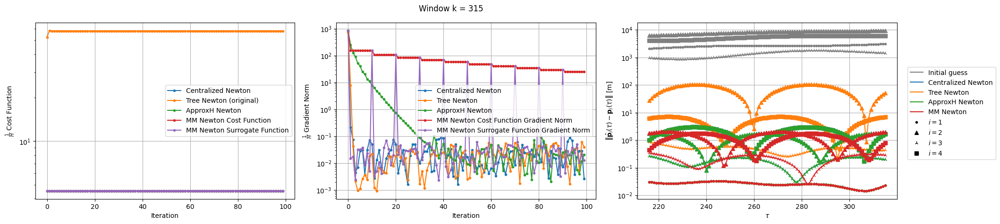


Windows:  73%|███████▎  | 217/296 [17:58:33<6:19:01, 287.87s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 57.96929649154822
Gradient norm: 3040.2593635008666
Global relative error: 34.37225477348255
Position relative errors: 0.029841046933166082 m, 33.76284809410933 m, 0.8169268381925439 m, 6.3907537508264785 m

Before applying the algorithm
L_norm = 4.563284377067349
Grad_L_norm = 3063.9581700665944

Before applying the algorithm
Cost function: 4.563284386410423
Gradient norm: 3063.980742527213
Global relative error: 2.1160931461689767
Position relative errors: 0.02984258510550173 m, 1.7322560130367317 m, 0.2535992700943567 m, 1.188245278686472 m

Iteration 1
Cost function: 54.23902729894609 (-6.43%)
Gradient norm: 3.194155361331079 (-99.89%)
Global relative error: 34.428723520791635 (0.16%)
Position relative errors: 0.02518540919604236 m, 33.76372711427359 m, 0.8393491553990604 m

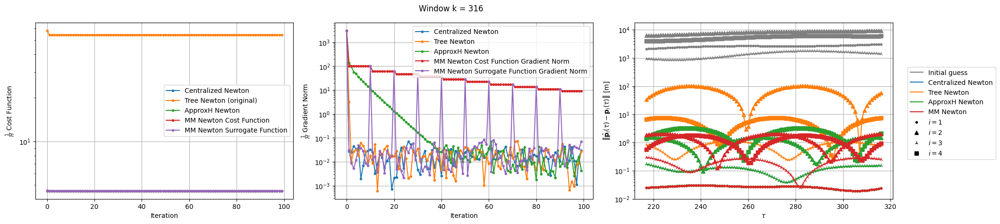


Windows:  74%|███████▎  | 218/296 [18:03:17<6:12:51, 286.82s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 54.22859051828036
Gradient norm: 583.0261512670683
Global relative error: 40.60170430185436
Position relative errors: 0.025308468882342172 m, 40.00420725691101 m, 0.7874545137245772 m, 6.894238405364679 m

Before applying the algorithm
Cost function: 4.556488171581487
Gradient norm: 957.973073348838
Global relative error: 2.1969585817804247
Position relative errors: 0.02530921868877443 m, 1.5310156464252247 m, 0.16330178440670162 m, 1.5669397370008284 m

Before applying the algorithm
L_norm = 4.556488155422308
Grad_L_norm = 957.9517377910806

Iteration 1
Cost function: 59.69244570437049 (10.08%)
Gradient norm: 21.665071509267506 (-96.28%)
Global relative error: 40.76184106142051 (0.39%)
Position relative errors: 0.018534862858737913 m, 40.00338091638409 m, 2.5138997816072965 m,

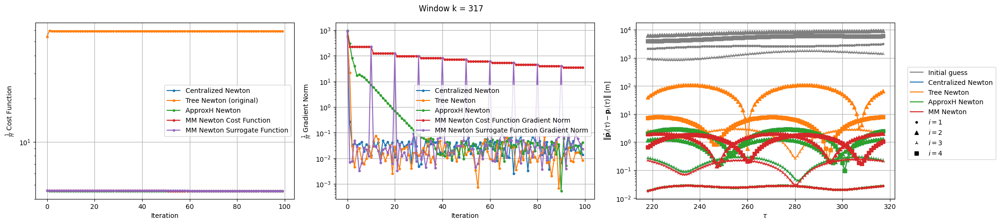


Windows:  74%|███████▍  | 219/296 [18:08:17<6:13:02, 290.68s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
L_norm = 4.525428370752739
Grad_L_norm = 675.4054228003179

Before applying the algorithm
Cost function: 59.66254043657023
Gradient norm: 608.8254521646722
Global relative error: 47.35649200662772
Position relative errors: 0.01970203718503947 m, 46.686498624111756 m, 2.4415809413379046 m, 7.5521133361466966 m

Before applying the algorithm
Cost function: 4.525428371442968
Gradient norm: 675.4482342312316
Global relative error: 2.5355092474259298
Position relative errors: 0.019701234757992018 m, 1.236582065694761 m, 0.2587120879219127 m, 2.1982600788854607 m

Iteration 1
L_norm = 4.5204715237599675
Grad_L_norm = 0.07650922165876353

Iteration 1
Cost function: 69.81168276067687 (17.01%)
Gradient norm: 29.038815618808304 (-95.23%)
Global relative error: 47.175959257700704 (-0.38%)
Position relat

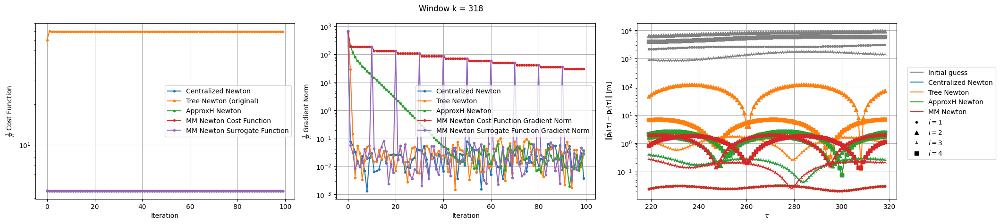


Windows:  74%|███████▍  | 220/296 [18:13:38<6:19:44, 299.80s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 68.94737851208873
Gradient norm: 2033.2274805789593
Global relative error: 54.28420431859791
Position relative errors: 0.025412531149293496 m, 53.84578324629233 m, 1.1577449476389472 m, 6.7861357864204725 m

Before applying the algorithm
L_norm = 4.548220512772434
Grad_L_norm = 2213.6910916426814

Before applying the algorithm
Cost function: 4.548220499580828
Gradient norm: 2213.6522236163037
Global relative error: 2.8071853740682826
Position relative errors: 0.02541392280296105 m, 1.6545606953102583 m, 0.381572529045972 m, 2.2352790219761034 m

Iteration 1
Cost function: 65.20268497564908 (-5.43%)
Gradient norm: 4.708658343372366 (-99.77%)
Global relative error: 54.48108599574462 (0.36%)
Position relative errors: 0.0247671099135932 m, 53.84670968834462 m, 1.6407351830731103 m,

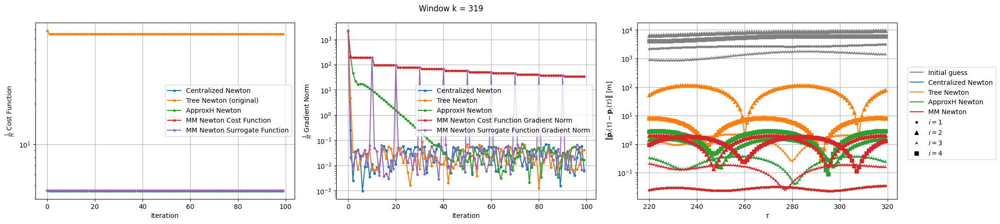


Windows:  75%|███████▍  | 221/296 [18:18:27<6:10:52, 296.70s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.540960785712933
Gradient norm: 1123.4354393730534
Global relative error: 3.222012637519098
Before applying the algorithm
L_norm = 4.540960788634578
Grad_L_norm = 1123.4466937770985
Position relative errors: 0.025697304699871984 m, 1.5021571796042248 m, 0.3179936482417819 m, 2.832509175608981 m


Before applying the algorithm
Cost function: 64.62998812543164
Gradient norm: 1106.6905655804162
Global relative error: 61.03700477719035
Position relative errors: 0.02569741369006768 m, 60.47333660656733 m, 1.5648464351456823 m, 8.125907199579352 m

Iteration 1
Cost function: 4.539237493240406 (-0.04%)
Gradient norm: 134.07594692549748 (-88.07%)
Global relative error: 3.2132467169599623 (-0.27%)
Position relative errors: 0.03096949181804084 m, 1.310776869019201 m, 0.2664093187021746 

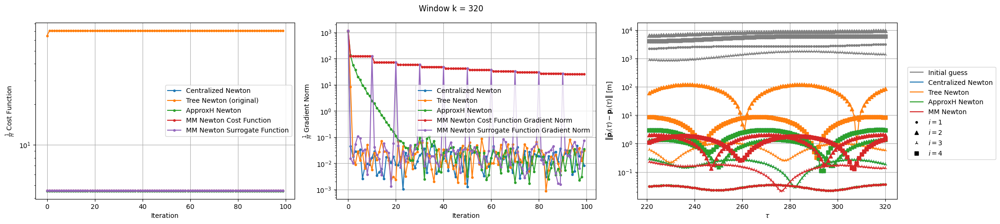


Windows:  75%|███████▌  | 222/296 [18:23:15<6:02:41, 294.08s/it]

-------- Centralized Newton ---------------- Tree Newton ---------------- ApproxH Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 4.5574478443376725
Gradient norm: 593.0541763239297
Global relative error: 3.319583935402072
Position relative errors: 0.03174424070072579 m, 1.3340688094639999 m, 0.27980406653657475 m, 3.02664823965248 m

Before applying the algorithm
Cost function: 69.8221941919695
Gradient norm: 597.1580097939144
Global relative error: 67.7665015331879
Position relative errors: 0.03174321371784846 m, 67.21391820543417 m, 0.5574652613444606 m, 8.617659135852056 m

Before applying the algorithm
L_norm = 4.557447840507546
Grad_L_norm = 593.014515273303

Iteration 1
Cost function: 74.31987603793227 (6.44%)
Gradient norm: 2.3067968053945807 (-99.61%)
Global relative error: 67.93443878727064 (0.25%)
Position relative errors: 0.025600270448786 m, 67.21325085361583 m, 1.5110135594413485 m, 9.755521

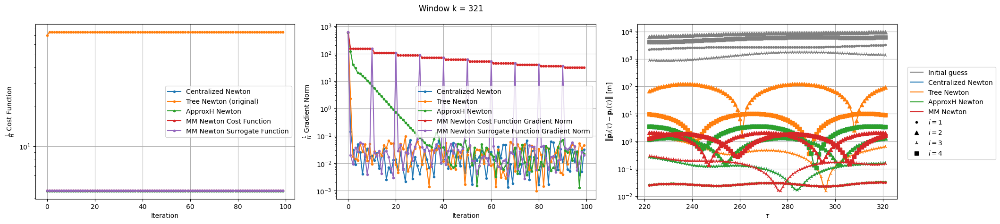


Windows:  75%|███████▌  | 223/296 [18:28:03<5:55:31, 292.21s/it]

-------- Centralized Newton ---------------- ApproxH Newton ---------------- Tree Newton ---------------- MM Newton --------




Majorization-Minimization Iteration 1
Before applying the algorithm
Cost function: 73.26653793746578
Gradient norm: 3319.219797232683
Global relative error: 74.48963493695314
Position relative errors: 0.0262670466730126 m, 73.85953584038549 m, 1.4768628801348649 m, 9.554116749117192 m

Before applying the algorithm
L_norm = 4.560426207531523
Grad_L_norm = 3317.120464893652

Before applying the algorithm
Cost function: 4.560426206817626
Gradient norm: 3317.129451659465
Global relative error: 3.667320867693399
Position relative errors: 0.02626896214233304 m, 1.1995779264558553 m, 0.25944129602563104 m, 3.4557566779177473 m

Iteration 1
Cost function: 74.64879944969977 (1.89%)
Gradient norm: 1.3240665418210087 (-99.96%)
Global relative error: 75.68054886625136 (1.60%)
Position relative errors: 0.03127206300975436 m, 75.143505519065 m, 0.5812485241848846 m, 8.980

In [ ]:
if use_several_cpus and use_causal:
    # DISTRIBUTED OVER SEVERAL CPUs AND CAUSAL
    
    # Initialize storage arrays for state estimates
    X_est_unkkt_history = np.zeros((24, 1, K))  # Centralized Newton
    X_est_tree_newton_history = np.zeros((24, 1, K))  # Tree Newton
    X_est_approx_newton_history = np.zeros((24, 1, K))  # ApproxH Newton
    X_est_mm_history = np.zeros((24, 1, K))  # MM Newton
    
    def solve_algorithm(algorithm_name, algorithm, X_est, dt, Y, X_true, n):
        """
        Solves the estimation problem for a given algorithm.
        Returns the algorithm name, updated X_est, and cost function/gradient data for plotting.
        """
        print(f"-------- {algorithm_name} --------")
        
        if algorithm_name == "Centralized Newton":
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n - W + 1 : n + 1])
            final_errors = [
                np.linalg.norm(X_true[:3, :, n - W + 1] - X_est[:3]),
                np.linalg.norm(X_true[6:9, :, n - W + 1] - X_est[6:9]),
                np.linalg.norm(X_true[12:15, :, n - W + 1] - X_est[12:15]),
                np.linalg.norm(X_true[18:21, :, n - W + 1] - X_est[18:21])
            ]
            print(f"Final position relative errors: {final_errors} m")
        
        elif algorithm_name in ["Tree Newton", "ApproxH Newton", "MM Newton"]:
            X_est = algorithm.solve_for_each_window(dt, X_est, Y[:, :, n - W + 1 : n + 1], X_true[:, :, n - W + 1])
    
        # Collect cost function and gradient norm data
        return (
            algorithm_name,
            X_est,
            algorithm.cost_function_values.copy(),
            algorithm.grad_norm_values.copy(),
            algorithm.surrogate_function_values.copy() if hasattr(algorithm, "surrogate_function_values") else [],
            algorithm.surrogate_grad_norm_values.copy() if hasattr(algorithm, "surrogate_grad_norm_values") else []
        )
    
    # ================= MAIN EXECUTION =================
    for m in tqdm(range(M), desc="MC runs", leave=True):
        # Generate observations
        Y = np.zeros((9, 1, T))
        for t in range(T):
            Y[:, :, t] = unkkt.h(X_true[:, :, t]) + np.random.multivariate_normal(np.zeros(9), R).reshape((9, 1))
    
        # Initialize state estimates
        X_est_unkkt = X_initial + initial_dev
        X_est_tree_newton = X_initial + initial_dev
        X_est_approx_newton = X_initial + initial_dev
        X_est_mm = X_initial + initial_dev
    
        for n in tqdm(range(W - 1, K), desc="Windows", leave=False):
            with ProcessPoolExecutor(max_workers=4) as executor:
                # Run each algorithm in parallel
                future_to_algorithm = {
                    executor.submit(solve_algorithm, "Centralized Newton", unkkt, X_est_unkkt, dt, Y, X_true, n): "Centralized Newton",
                    executor.submit(solve_algorithm, "Tree Newton", tree_newton, X_est_tree_newton, dt, Y, X_true, n): "Tree Newton",
                    executor.submit(solve_algorithm, "ApproxH Newton", approxh_newton, X_est_approx_newton, dt, Y, X_true, n): "ApproxH Newton",
                    executor.submit(solve_algorithm, "MM Newton", mm_newton, X_est_mm, dt, Y, X_true, n): "MM Newton"
                }
    
                # Retrieve results in the main process
                results = {future.result()[0]: future.result()[1:] for future in future_to_algorithm}
    
            # Extract updated estimates
            X_est_unkkt, cost_unkkt, grad_unkkt, _, _ = results["Centralized Newton"]
            X_est_tree_newton, cost_tree, grad_tree, _, _ = results["Tree Newton"]
            X_est_approx_newton, cost_approx, grad_approx, _, _ = results["ApproxH Newton"]
            X_est_mm, cost_mm, grad_mm, surrogate_cost_mm, surrogate_grad_mm = results["MM Newton"]
            
            # Propagate the estimated initial conditions until the end of the finite-horizon window
            if n == W - 1:
                X_est_unkkt_history[:, :, 0] = X_est_unkkt
                X_est_tree_newton_history[:, :, 0] = X_est_tree_newton
                X_est_approx_newton_history[:, :, 0] = X_est_approx_newton
                X_est_mm_history[:, :, 0] = X_est_mm
                for tau in range(W - 1):
                    X_est_unkkt_history[:, :, tau + 1] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_history[:, :, tau])
                    X_est_tree_newton_history[:, :, tau + 1] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_history[:, :, tau])
                    X_est_approx_newton_history[:, :, tau + 1] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_history[:, :, tau])
                    X_est_mm_history[:, :, tau + 1] = mm_newton.dynamic_model.x_new(dt, X_est_mm_history[:, :, tau])
            else:
                X_est_unkkt_history[:, :, n] = X_est_unkkt
                X_est_tree_newton_history[:, :, n] = X_est_tree_newton
                X_est_approx_newton_history[:, :, n] = X_est_approx_newton
                X_est_mm_history[:, :, n] = X_est_mm
                for tau in range(W - 1):
                    X_est_unkkt_history[:, :, n] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_history[:, :, n])
                    X_est_tree_newton_history[:, :, n] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_history[:, :, n])
                    X_est_approx_newton_history[:, :, n] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_history[:, :, n])
                    X_est_mm_history[:, :, n] = mm_newton.dynamic_model.x_new(dt, X_est_mm_history[:, :, n])
                
            # Plot results **in the main process**
            fig, axs = plt.subplots(1, 3, figsize=(3 * 6.4, 4.8))
    
            # Cost function values
            axs[0].plot(cost_unkkt, '.-', label='Centralized Newton')
            axs[0].plot(cost_tree, '.-', label='Tree Newton (original)')
            axs[0].plot(cost_approx, '.-', label='ApproxH Newton')
            axs[0].plot(cost_mm, '.-', label='MM Newton Cost Function')
            axs[0].plot(surrogate_cost_mm, '.-', label='MM Newton Surrogate Function')
            axs[0].set_xlabel('Iteration')
            axs[0].set_ylabel(r'$\frac{1}{H}$ Cost Function')
            axs[0].set_yscale('log')
            axs[0].grid(True)
            axs[0].legend()
    
            # Gradient norm values
            axs[1].plot(grad_unkkt, '.-', label='Centralized Newton')
            axs[1].plot(grad_tree, '.-', label='Tree Newton')
            axs[1].plot(grad_approx, '.-', label='ApproxH Newton')
            axs[1].plot(grad_mm, '.-', label='MM Newton Cost Function Gradient Norm')
            axs[1].plot(surrogate_grad_mm, '.-', label='MM Newton Surrogate Function Gradient Norm')
            axs[1].set_xlabel('Iteration')
            axs[1].set_ylabel(r'$\frac{1}{H}$ Gradient Norm')
            axs[1].set_yscale('log')
            axs[1].grid(True)
            axs[1].legend()

            # Initialize storage for current estimates
            X_est_unkkt_current = np.zeros((24, 1, W))
            X_est_tree_newton_current = np.zeros((24, 1, W))
            X_est_approx_newton_current = np.zeros((24, 1, W))
            X_est_mm_current = np.zeros((24, 1, W))
            
            # Simulate forward propagation over the window
            X_est_unkkt_current[:, :, 0] = X_est_unkkt
            X_est_tree_newton_current[:, :, 0] = X_est_tree_newton
            X_est_approx_newton_current[:, :, 0] = X_est_approx_newton
            X_est_mm_current[:, :, 0] = X_est_mm
            
            for tau in range(W - 1):
                X_est_unkkt_current[:, :, tau + 1] = unkkt.dynamic_model.x_new(dt, X_est_unkkt_current[:, :, tau])
                X_est_tree_newton_current[:, :, tau + 1] = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton_current[:, :, tau])
                X_est_approx_newton_current[:, :, tau + 1] = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton_current[:, :, tau])
                X_est_mm_current[:, :, tau + 1] = mm_newton.dynamic_model.x_new(dt, X_est_mm_current[:, :, tau])
            
            # Compute position estimation errors
            dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current = position_estimation_error(X_est_unkkt_current, X_true[:, :, n - W + 1 : n + 1])
            dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current = position_estimation_error(X_est_tree_newton_current, X_true[:, :, n - W + 1 : n + 1])
            dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current = position_estimation_error(X_est_approx_newton_current, X_true[:, :, n - W + 1 : n + 1])
            dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current = position_estimation_error(X_est_mm_current, X_true[:, :, n - W + 1 : n + 1])
            
            # Define colors for algorithms
            algorithm_colors = {
                'Initial guess': 'grey',
                'Centralized Newton': 'C0',
                'Tree Newton': 'C1',
                'ApproxH Newton': 'C2',
                'MM Newton': 'C3'
            }
            
            # Define markers for different agents (i = 1, ..., 4)
            markers = ['.', '^', '2', 's', 'P']
            
            # Plot Initial Guess deviations (use the same color for all i)
            for i, dev_initial in enumerate([dev_chief_initial, dev_deputy1_initial, dev_deputy2_initial, dev_deputy3_initial]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_initial[n - W + 1 : n + 1], linestyle='-', color=algorithm_colors['Initial guess'], marker=markers[i])
            
            # Plot Centralized Newton deviations
            for i, dev_unkkt in enumerate([dev_chief_unkkt_current, dev_deputy1_unkkt_current, dev_deputy2_unkkt_current, dev_deputy3_unkkt_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_unkkt, linestyle='-', color=algorithm_colors['Centralized Newton'], marker=markers[i])
            
            # Plot Tree Newton deviations
            for i, dev_tree in enumerate([dev_chief_tree_current, dev_deputy1_tree_current, dev_deputy2_tree_current, dev_deputy3_tree_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_tree, linestyle='-', color=algorithm_colors['Tree Newton'], marker=markers[i])
            
            # Plot ApproxH Newton deviations
            for i, dev_approxh in enumerate([dev_chief_approxh_current, dev_deputy1_approxh_current, dev_deputy2_approxh_current, dev_deputy3_approxh_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_approxh, linestyle='-', color=algorithm_colors['ApproxH Newton'], marker=markers[i])
            
            # Plot MM Newton deviations
            for i, dev_mm in enumerate([dev_chief_mm_current, dev_deputy1_mm_current, dev_deputy2_mm_current, dev_deputy3_mm_current]):
                axs[2].plot(np.arange(n - W + 1, n + 1), dev_mm, linestyle='-', color=algorithm_colors['MM Newton'], marker=markers[i])
            
            # Set axis labels and scale
            axs[2].set_xlabel(r'$\tau$')
            axs[2].set_ylabel(r'$\left\|\hat{\mathbf{p}}_i(\tau) - \mathbf{p}_i(\tau)\right\|$ [m]')
            axs[2].set_yscale('log')
            axs[2].grid(True)
            
            # Create legend (Colors for Algorithms, Markers for Agents)
            legend_elements = [
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Initial guess'], label='Initial guess'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Centralized Newton'], label='Centralized Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['Tree Newton'], label='Tree Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['ApproxH Newton'], label='ApproxH Newton'),
                Line2D([0], [0], linestyle='-', color=algorithm_colors['MM Newton'], label='MM Newton'),
                Line2D([0], [0], linestyle='', marker='.', color='black', label='$i = 1$'),
                Line2D([0], [0], linestyle='', marker='^', color='black', label='$i = 2$'),
                Line2D([0], [0], linestyle='', marker='2', color='black', label='$i = 3$'),
                Line2D([0], [0], linestyle='', marker='s', color='black', label='$i = 4$')
            ]
            fig.legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))
    
            fig.suptitle(f'Window k = {n}')
            plt.tight_layout() 
            plt.show()
    
            # Update state estimates
            X_est_unkkt = unkkt.dynamic_model.x_new(dt, X_est_unkkt)
            X_est_tree_newton = tree_newton.dynamic_model.x_new(dt, X_est_tree_newton)
            X_est_approx_newton = approxh_newton.dynamic_model.x_new(dt, X_est_approx_newton)
            X_est_mm = mm_newton.dynamic_model.x_new(dt, X_est_mm)

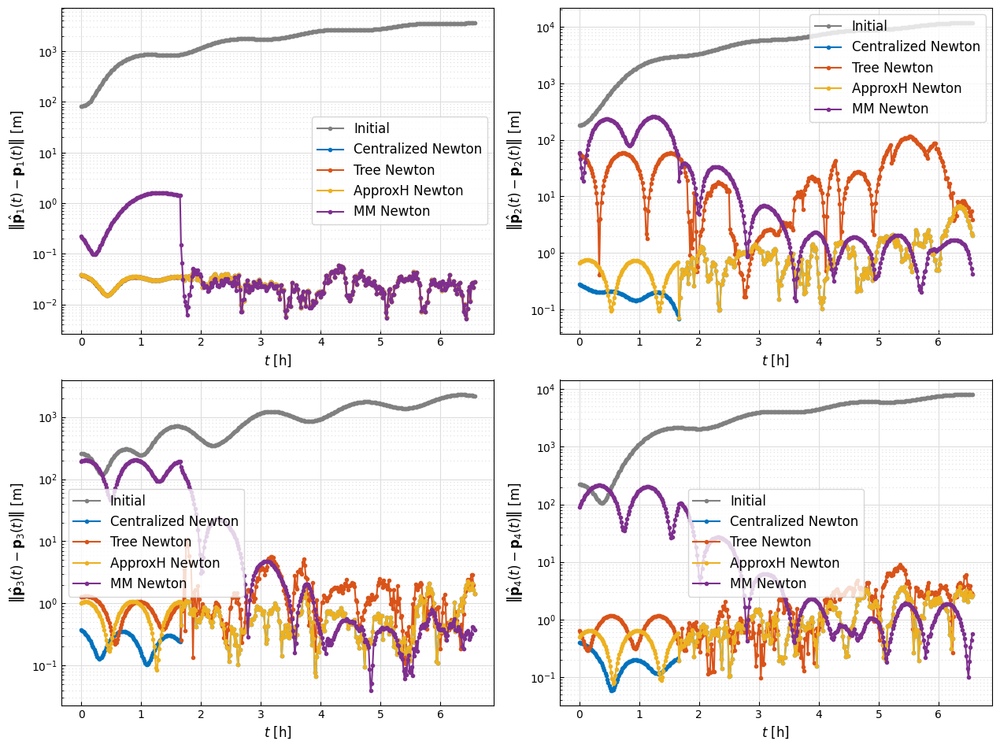

In [15]:
# Extract deviations for Chief and Deputies
dev_chief_unkkt, dev_deputy1_unkkt, dev_deputy2_unkkt, dev_deputy3_unkkt = position_estimation_error(X_est_unkkt_history, X_true)
dev_chief_tree, dev_deputy1_tree, dev_deputy2_tree, dev_deputy3_tree = position_estimation_error(X_est_tree_newton_history, X_true)
dev_chief_approx, dev_deputy1_approx, dev_deputy2_approx, dev_deputy3_approx = position_estimation_error(X_est_approx_newton_history, X_true)
dev_chief_mm, dev_deputy1_mm, dev_deputy2_mm, dev_deputy3_mm = position_estimation_error(X_est_mm_history, X_true)

# Time array
T = X_true.shape[2]

# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, T) / dt

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, dev_chief_initial, ".-", color='grey', label="Initial")
axs[0, 0].plot(time, dev_chief_unkkt, ".-", color='C0', label="Centralized Newton")
axs[0, 0].plot(time, dev_chief_tree, ".-", color='C1', label="Tree Newton")
axs[0, 0].plot(time, dev_chief_approx, ".-", color='C2', label="ApproxH Newton")
axs[0, 0].plot(time, dev_chief_mm, ".-", color='C3', label="MM Newton")
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_1(t) - \\mathbf{p}_1(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)

# Plot 2: Deputy 1
axs[0, 1].plot(time, dev_deputy1_initial, ".-", color='grey', label="Initial")
axs[0, 1].plot(time, dev_deputy1_unkkt, ".-", color='C0', label="Centralized Newton")
axs[0, 1].plot(time, dev_deputy1_tree, ".-", color='C1', label="Tree Newton")
axs[0, 1].plot(time, dev_deputy1_approx, ".-", color='C2', label="ApproxH Newton")
axs[0, 1].plot(time, dev_deputy1_mm, ".-", color='C3', label="MM Newton")
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_2(t) - \\mathbf{p}_2(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)

# Plot 3: Deputy 2
axs[1, 0].plot(time, dev_deputy2_initial, ".-", color='grey', label="Initial")
axs[1, 0].plot(time, dev_deputy2_unkkt, ".-", color='C0', label="Centralized Newton")
axs[1, 0].plot(time, dev_deputy2_tree, ".-", color='C1', label="Tree Newton")
axs[1, 0].plot(time, dev_deputy2_approx, ".-", color='C2', label="ApproxH Newton")
axs[1, 0].plot(time, dev_deputy2_mm, ".-", color='C3', label="MM Newton")
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_3(t) - \\mathbf{p}_3(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)

# Plot 4: Deputy 3
axs[1, 1].plot(time, dev_deputy3_initial, ".-", color='grey', label="Initial")
axs[1, 1].plot(time, dev_deputy3_unkkt, ".-", color='C0', label="Centralized Newton")
axs[1, 1].plot(time, dev_deputy3_tree, ".-", color='C1', label="Tree Newton")
axs[1, 1].plot(time, dev_deputy3_approx, ".-", color='C2', label="ApproxH Newton")
axs[1, 1].plot(time, dev_deputy3_mm, ".-", color='C3', label="MM Newton")
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{p}}_4(t) - \\mathbf{p}_4(t)\\right\\|$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)

plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [17]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_unkkt_history
with open(
    f'centralized_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_tree_newton_history
with open(
    f'tree_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_approx_newton_history
with open(
    f'approxh_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)

# Fill the dictionary
data = {}
data["true"] = X_true
data[0] = X_est_mm_history
with open(
    f'mm_newton_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl',
    "wb",
) as file:
    pickle.dump(data, file)